In [1]:
# toggle to use in browser
# %matplotlib notebook
# toggle to develop in VSCode
%matplotlib inline
import os

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.transforms as mtransforms
import pymap3d as pm

import imp
import align_utils
import pf_utils
imp.reload(align_utils)
imp.reload(pf_utils)

from align_utils import *
from pf_utils import *

import random
import particle_filter
imp.reload(particle_filter)
from particle_filter import *

plt.ion()

plt.rcParams["figure.figsize"] = (10,5)

In [2]:
path_dualfoot_lib = '../../DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/'
path_dualfoot_data = '/data/processed/peize/sfrs_data/'

In [56]:
path_dualfoot_lib = '../../DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/'
path_dualfoot_data = '/data/processed/peize/waverley_data/'
truncate_to_last_timestamp = False
floorplan_image = mpimg.imread(f'waverley-matched.png')
floorplan_scale = 0.06409787975531105

In [46]:
floorplan_image.shape

(7016, 9921, 4)

In [3]:
process_dualfoot_data(path_dualfoot_data, path_dualfoot_lib)

Processing DualFoot:  /data/processed/peize/sfrs_data/2022-07-18_14-25-21.967_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/load_ips.py:148: UserWarning: genfromtxt: Empty input file: "/data/processed/peize/sfrs_data/2022-07-18_14-25-21.967_HUAWEI P40 Pro 1/saved_timestamps.csv"
  tmsp_table = np.genfromtxt(file_tmsp, delimiter=",", skip_header=1)
/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py:118: UserWarning: Data is corrupted! Trying to cut the data.
  warnings.warn('Data is corrupted! Trying to cut the data.')


Experiment duration:  292 s.
(9, 58140)
Evaluation time:  19 s.
Processing DualFoot:  /data/processed/peize/sfrs_data/2022-07-18_14-19-52.386_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/load_ips.py:148: UserWarning: genfromtxt: Empty input file: "/data/processed/peize/sfrs_data/2022-07-18_14-19-52.386_HUAWEI P40 Pro 1/saved_timestamps.csv"
  tmsp_table = np.genfromtxt(file_tmsp, delimiter=",", skip_header=1)


Experiment duration:  266 s.
(9, 52920)
Evaluation time:  17 s.
Processing DualFoot:  /data/processed/peize/sfrs_data/2022-07-18_13-58-43.052_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/load_ips.py:148: UserWarning: genfromtxt: Empty input file: "/data/processed/peize/sfrs_data/2022-07-18_13-58-43.052_HUAWEI P40 Pro 1/saved_timestamps.csv"
  tmsp_table = np.genfromtxt(file_tmsp, delimiter=",", skip_header=1)
Traceback (most recent call last):
  File "/home/peize/sf/trajectory_alignment/notebooks/../../DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/main.py", line 191, in <module>
    res = calc_everything(**options)
  File "/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/algorithms.py", line 341, in calc_everything
    u_1, zupt_1, dt_1, height_1, elev_tmsp, esc_tmsp = prepare_data(exp_path,
  File "/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py", line 184, in prepare_data
    u, dt, height, _ = cut_data(u, dt, height)
  File "/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py", lin

In [4]:
# Setting up paths, variables and parameters
venue = 'erc_office'
floor = '5'

path_data = f'../data/{venue}/{floor}/'
# path_dualfoot_data = path_data + 'dualfoot/'
path_dualfoot_data = path_data + 'mapping1/'
path_floor_plan = f'../data/{venue}/MAP/{floor}/'

path_dualfoot_lib = '../../DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/'
path_fusion_binary = '../../binaries/fusion_binary/online-positioning-fusion.jar'
fusion_accuracy = 5.0
fusion_step_length_error = 0.1
fusion_orientation_error = 0.1

floorplan_image = mpimg.imread(f'{path_floor_plan}/{floor}.png')
floorplan_pgw = load_floorplan_pgw(path_floor_plan, floor)

truncate_to_last_timestamp = False


In [6]:
process_dualfoot_data(path_dualfoot_data, path_dualfoot_lib)

Processing DualFoot:  ../data/erc_office/5/mapping1/P2_2021-10-13_10-34-10.949_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py:216: UserWarning: There was no stationary position!
  warnings.warn('There was no stationary position!')
/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/algorithms.py:426: UserWarning: The single-foot algorithm is used instead of the dual-foot algorithm because it gives better results.
  warnings.warn('The single-foot algorithm is used instead of ' +


Experiment duration:  80 s.
Evaluation time:  5 s.
Processing DualFoot:  ../data/erc_office/5/mapping1/P1_2021-10-13_10-31-04.691_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py:216: UserWarning: There was no stationary position!
  warnings.warn('There was no stationary position!')
/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/algorithms.py:426: UserWarning: The single-foot algorithm is used instead of the dual-foot algorithm because it gives better results.
  warnings.warn('The single-foot algorithm is used instead of ' +


Experiment duration:  66 s.
Evaluation time:  4 s.
Processing DualFoot:  ../data/erc_office/5/mapping1/P5_2021-10-13_16-22-54.768_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py:216: UserWarning: There was no stationary position!
  warnings.warn('There was no stationary position!')
/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/algorithms.py:426: UserWarning: The single-foot algorithm is used instead of the dual-foot algorithm because it gives better results.
  warnings.warn('The single-foot algorithm is used instead of ' +


Experiment duration:  51 s.
Evaluation time:  3 s.
Processing DualFoot:  ../data/erc_office/5/mapping1/P4_2021-10-13_16-28-59.300_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py:216: UserWarning: There was no stationary position!
  warnings.warn('There was no stationary position!')
/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/algorithms.py:426: UserWarning: The single-foot algorithm is used instead of the dual-foot algorithm because it gives better results.
  warnings.warn('The single-foot algorithm is used instead of ' +


Experiment duration:  55 s.
Evaluation time:  3 s.
Processing DualFoot:  ../data/erc_office/5/mapping1/P3_2021-10-13_10-40-25.712_HUAWEI P40 Pro 1
flags: --save


/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/data_processing.py:216: UserWarning: There was no stationary position!
  warnings.warn('There was no stationary position!')
/home/peize/sf/DualFoot-master-96443ef411b3d192a13c700b179184796a1b5e3f/algorithms.py:426: UserWarning: The single-foot algorithm is used instead of the dual-foot algorithm because it gives better results.
  warnings.warn('The single-foot algorithm is used instead of ' +


Experiment duration:  47 s.
Evaluation time:  3 s.


In [4]:
subdirs = os.listdir(path_dualfoot_data) 
for subdir in subdirs:
    path = path_dualfoot_data + subdir
    truncate_trajectory_to_last_timestamp(path)

# Aligning trajectories
## Assigning trajectory points to map points
* LEFT mouse button: Select trajectory point
* RIGHT mouse button: Select corresponding floor plan point
  * Draws a line between those
* Repeat above steps until ready...
* MIDDLE button moves to next trajectory
  * If no points selected, skips but does not overwrite previous alignment

<IPython.core.display.Javascript object>


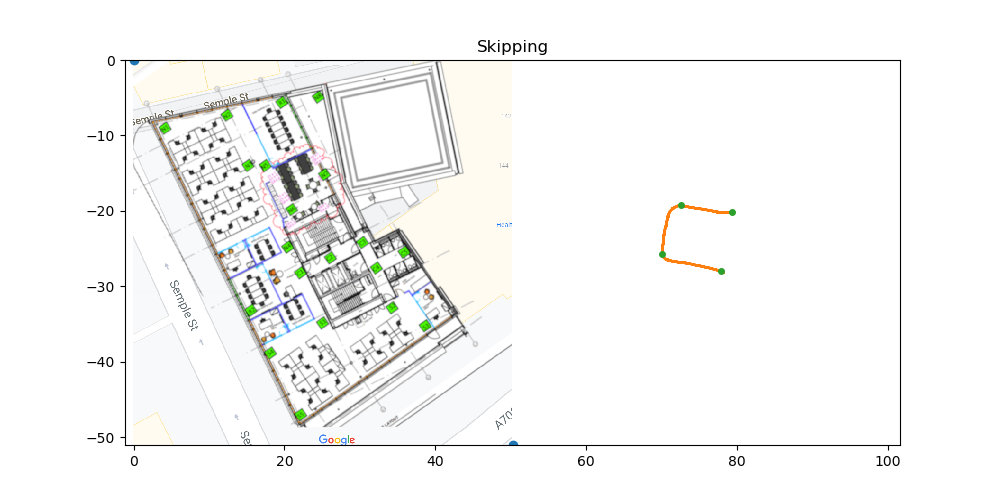

In [5]:
%matplotlib notebook
state = init_collection_state(path_dualfoot_data, floorplan_image, floorplan_pgw, truncate_to_last_timestamp)
collect_trajectory_data(state)


## Align using yaml file 

In [64]:
import yaml

In [68]:
with open("gt_matching.yaml", "r") as stream:
    map_info = yaml.safe_load(stream)

In [69]:
trajs = map_info['good_traj']
pix_to_meter = map_info['cfg']['pix_to_meter']
key_point_locations = map_info['location_dict_pix']

In [70]:
for traj_name in trajs:
    traj = map_info[traj_name]
    traj_path = os.path.join(path_dualfoot_data, traj['subdir'])
    key_points = traj['key_points']
    print(key_points)
    key_ts = pd.read_csv(os.path.join(traj_path, 'saved_timestamps.csv'))
    key_ts['timestamp_global[ms]'] = key_ts['timestamp_global[ms]'] / 1000
    trajectory = pd.read_csv(os.path.join(traj_path, 'trajectory.csv'))
    assert len(key_points) == key_ts.shape[0], f"points count doesn't match ts count"
    match_result = []
    for i in range(len(key_ts)):
        if key_points[i][0] != 'z':
            match_result.append([key_point_locations[key_points[i]][0]*pix_to_meter, -key_point_locations[key_points[i]][1]*pix_to_meter, key_ts['timestamp_global[ms]'][i]])
    print(match_result)
    # SAVE
    match_result = np.array(match_result)
    df = pd.DataFrame()
    df['x'] = match_result[:,0]
    df['y'] = match_result[:,1]
    df['t'] = match_result[:,2]
    df.to_csv(os.path.join(traj_path, 'trajectory_coords.csv'))
    traj_keyindex = np.searchsorted(trajectory['t[s]'], key_ts)
    traj_keypoints = pd.DataFrame()
    traj_keypoints['x'] = np.array([trajectory['x_avg[m]'][i] for i in traj_keyindex]).flatten()
    traj_keypoints['y'] = np.array([trajectory['y_avg[m]'][i] for i in traj_keyindex]).flatten()
    traj_keypoints['t'] = np.array([trajectory['t[s]'][i] for i in traj_keyindex]).flatten()
    print(traj_keypoints)
    first0 = np.array(traj_keypoints.iloc[0, :2])
    last0 = np.array(traj_keypoints.iloc[1, :2])
    first1 = np.array(match_result[0][:2])
    last1 = np.array(match_result[1][:2])
    v0 = last0 - first0
    v1 = last1 - first1
    d0 = np.linalg.norm(v0)
    d1 = np.linalg.norm(v1)
    a0 = np.arctan2(*v0)
    a1 = np.arctan2(*v1)
    init_pf = {
        'x': first1[0],
        'y': first1[1],
        'scale': d1/d0,
        'heading': a0 - a1
    }
    print(init_pf)
    df_pf = pd.DataFrame(init_pf, index=[0])
    df_pf.to_csv(os.path.join(traj_path, 'trajectory_init_pf.csv'), index=False)

<>:12: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:12: SyntaxWarning: "is not" with a literal. Did you mean "!="?
/tmp/ipykernel_48372/3153429014.py:12: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if key_points[i][0] is not 'z':


['b8', 'b7', 'zb65', 'b5', 'b4', 'b35', 'a4', 'a3', 'a2', 'a1', 'a2', 'a3', 'a4', 'b35', 'b3', 'b2', 'b1', 'b2', 'b3', 'b4', 'b5', 'b6', 'b7', 'b8']
[[577.6500923548632, -156.7193160017355, 2.765], [529.3843888991139, -162.10353790118162, 42.666], [448.81335404668795, -170.56445802888268, 112.764], [440.73702119751874, -161.3343633441179, 126.791], [437.85261660852973, -147.4892213169707, 137.575], [474.7729953475889, -135.7593093217488, 173.516], [510.92419952958437, -137.10536479661033, 203.748], [525.7308097530612, -139.22059482853558, 215.534], [599.7638608704455, -144.22022944944985, 272.021], [525.7308097530612, -139.22059482853558, 333.302], [510.92419952958437, -137.10536479661033, 344.03], [474.7729953475889, -135.7593093217488, 374.258], [437.85261660852973, -147.4892213169707, 408.53], [399.778476033875, -164.02647429384098, 444.15], [375.54947748636744, -173.25656897860577, 467.07], [379.97223118948386, -188.64006011988042, 480.989], [375.54947748636744, -173.25656897860577

# Estimating locations with location fusion binary
* The library does not seem to work that well
* CAN BE SKIPPED

Parsing data for fusion: ../data/erc_office/5/mapping1/P1_2021-10-13_10-31-04.691_HUAWEI P40 Pro 1
Parsing data for fusion: ../data/erc_office/5/mapping1/P2_2021-10-13_10-34-10.949_HUAWEI P40 Pro 1
Parsing data for fusion: ../data/erc_office/5/mapping1/P4_2021-10-13_16-28-59.300_HUAWEI P40 Pro 1
Parsing data for fusion: ../data/erc_office/5/mapping1/P5_2021-10-13_16-22-54.768_HUAWEI P40 Pro 1
Parsing data for fusion: ../data/erc_office/5/mapping1/P3_2021-10-13_10-40-25.712_HUAWEI P40 Pro 1
Processing fusion data: ../data/erc_office/5/mapping1/P1_2021-10-13_10-31-04.691_HUAWEI P40 Pro 1


Picked up JAVA_TOOL_OPTIONS:  -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/java/cacerts -Xmx64g -Dcom.sun.net.ssl.checkRevocation=false -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/java/cacerts -Xmx64g -Dcom.sun.net.ssl.checkRevocation=false
Picked up _JAVA_OPTIONS:  -Xmx64g -Xmx64g
Jun 21, 2022 12:55:50.291 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Input reading time: 0.048627155
Jun 21, 2022 12:55:50.460 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Processing time: 0.134494098
Jun 21, 2022 12:55:50.460 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Fidelity: 0.028155421094155537
Jun 21, 2022 12:55:50.465 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Estimated error: 6.532986267192099
Jun 21, 2022 12:55:50.748 PM com.huawei.riemann.location.fp.utils.ErrorMinimization dump_json
INFO: Json saving time: 0.282510524
Jun 21, 2022 12:55:

Processing fusion data: ../data/erc_office/5/mapping1/P2_2021-10-13_10-34-10.949_HUAWEI P40 Pro 1


Jun 21, 2022 12:55:50.973 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Input reading time: 0.062554792
Jun 21, 2022 12:55:51.104 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Processing time: 0.09601219
Jun 21, 2022 12:55:51.105 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Fidelity: 0.0183492286070048
Jun 21, 2022 12:55:51.109 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Estimated error: 19.424948664998475
Jun 21, 2022 12:55:51.346 PM com.huawei.riemann.location.fp.utils.ErrorMinimization dump_json
INFO: Json saving time: 0.237271822
Jun 21, 2022 12:55:51.348 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Execution time: 0.485979135
Picked up JAVA_TOOL_OPTIONS:  -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/java/cacerts -Xmx64g -Dcom.sun.net.ssl.checkRevocation=false -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/j

Processing fusion data: ../data/erc_office/5/mapping1/P4_2021-10-13_16-28-59.300_HUAWEI P40 Pro 1


Jun 21, 2022 12:55:51.542 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Input reading time: 0.042446204
Jun 21, 2022 12:55:51.714 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Processing time: 0.137111335
Jun 21, 2022 12:55:51.715 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Fidelity: 0.03819315480525347
Jun 21, 2022 12:55:51.720 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Estimated error: 6.523565056645182
Jun 21, 2022 12:55:51.973 PM com.huawei.riemann.location.fp.utils.ErrorMinimization dump_json
INFO: Json saving time: 0.252673228
Jun 21, 2022 12:55:51.974 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Execution time: 0.51291401
Picked up JAVA_TOOL_OPTIONS:  -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/java/cacerts -Xmx64g -Dcom.sun.net.ssl.checkRevocation=false -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/j

Processing fusion data: ../data/erc_office/5/mapping1/P5_2021-10-13_16-22-54.768_HUAWEI P40 Pro 1


Jun 21, 2022 12:55:52.182 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Input reading time: 0.047512666
Jun 21, 2022 12:55:52.335 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Processing time: 0.112885332
Jun 21, 2022 12:55:52.336 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Fidelity: 0.01772362283166418
Jun 21, 2022 12:55:52.341 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Estimated error: 6.189740685978037
Jun 21, 2022 12:55:52.569 PM com.huawei.riemann.location.fp.utils.ErrorMinimization dump_json
INFO: Json saving time: 0.228105653
Jun 21, 2022 12:55:52.571 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Execution time: 0.484655244
Picked up JAVA_TOOL_OPTIONS:  -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/java/cacerts -Xmx64g -Dcom.sun.net.ssl.checkRevocation=false -Djava.net.useSystemProxies=true -Djavax.net.ssl.trustStore=/etc/ssl/certs/

Processing fusion data: ../data/erc_office/5/mapping1/P3_2021-10-13_10-40-25.712_HUAWEI P40 Pro 1


Jun 21, 2022 12:55:52.776 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Input reading time: 0.039559681
Jun 21, 2022 12:55:52.927 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Processing time: 0.116795986
Jun 21, 2022 12:55:52.928 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Fidelity: 0.049120630400982086
Jun 21, 2022 12:55:52.933 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Estimated error: 6.191520403041459
Jun 21, 2022 12:55:53.132 PM com.huawei.riemann.location.fp.utils.ErrorMinimization dump_json
INFO: Json saving time: 0.197805378
Jun 21, 2022 12:55:53.134 PM com.huawei.riemann.location.fp.utils.ErrorMinimization main
INFO: Execution time: 0.436800725


Visualizing output from: ../data/erc_office/5/mapping1/P1_2021-10-13_10-31-04.691_HUAWEI P40 Pro 1
Vals from windows 67
Vals from corr pos 66


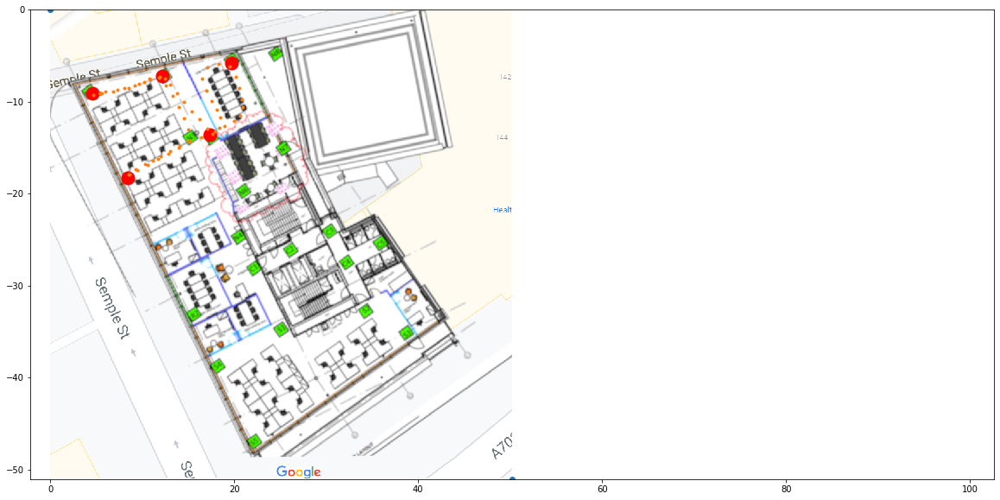

Visualizing output from: ../data/erc_office/5/mapping1/P2_2021-10-13_10-34-10.949_HUAWEI P40 Pro 1
Vals from windows 82
Vals from corr pos 81


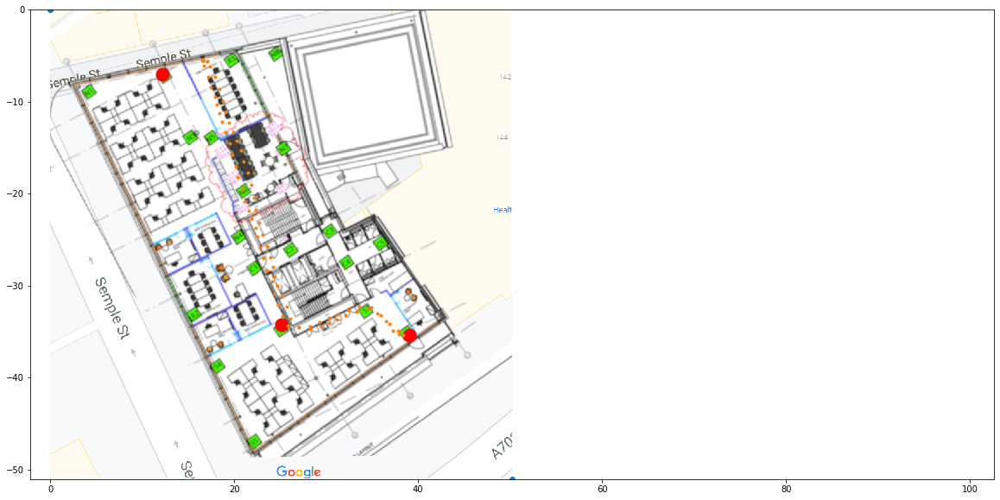

Visualizing output from: ../data/erc_office/5/mapping1/P4_2021-10-13_16-28-59.300_HUAWEI P40 Pro 1
Vals from windows 56
Vals from corr pos 55


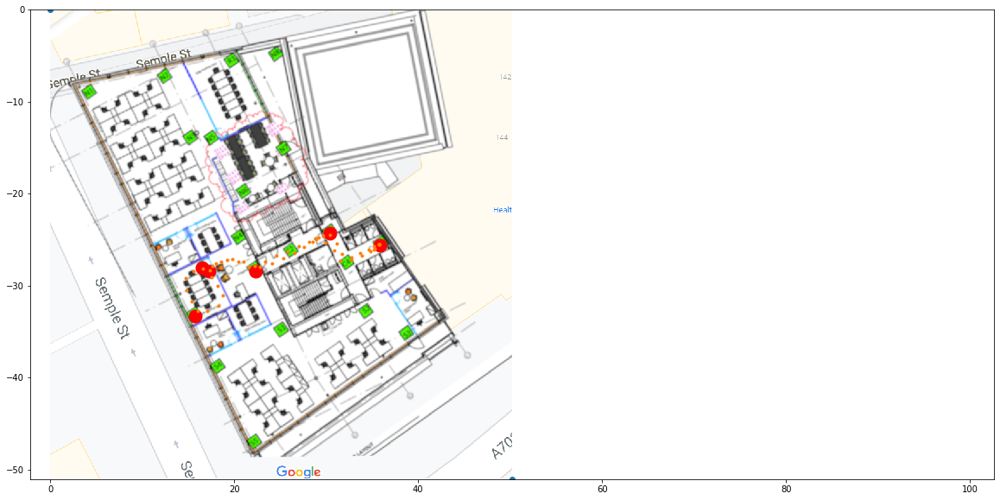

Visualizing output from: ../data/erc_office/5/mapping1/P5_2021-10-13_16-22-54.768_HUAWEI P40 Pro 1
Vals from windows 52
Vals from corr pos 51


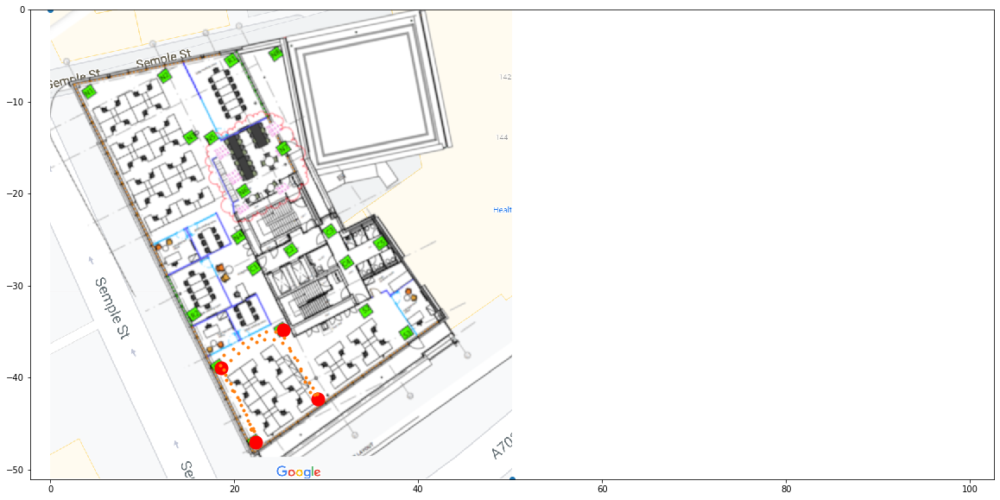

Visualizing output from: ../data/erc_office/5/mapping1/P3_2021-10-13_10-40-25.712_HUAWEI P40 Pro 1
Vals from windows 48
Vals from corr pos 47


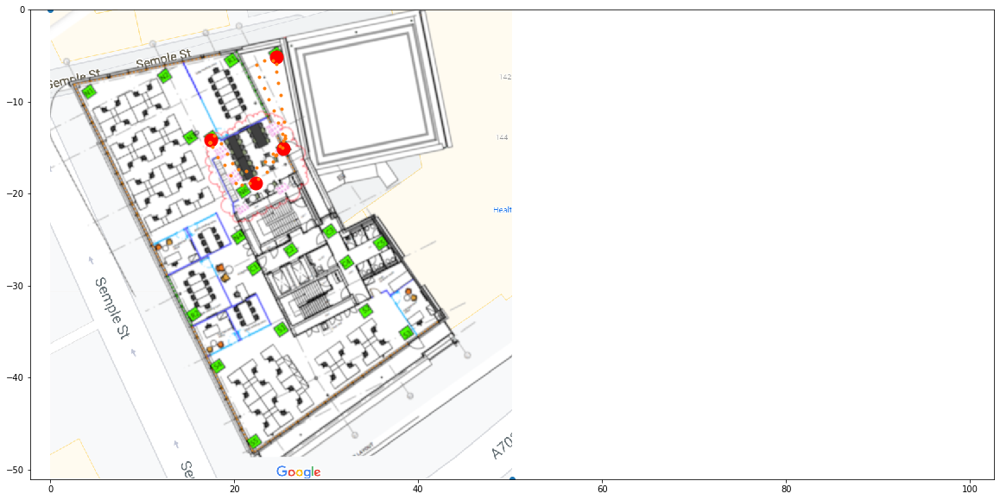

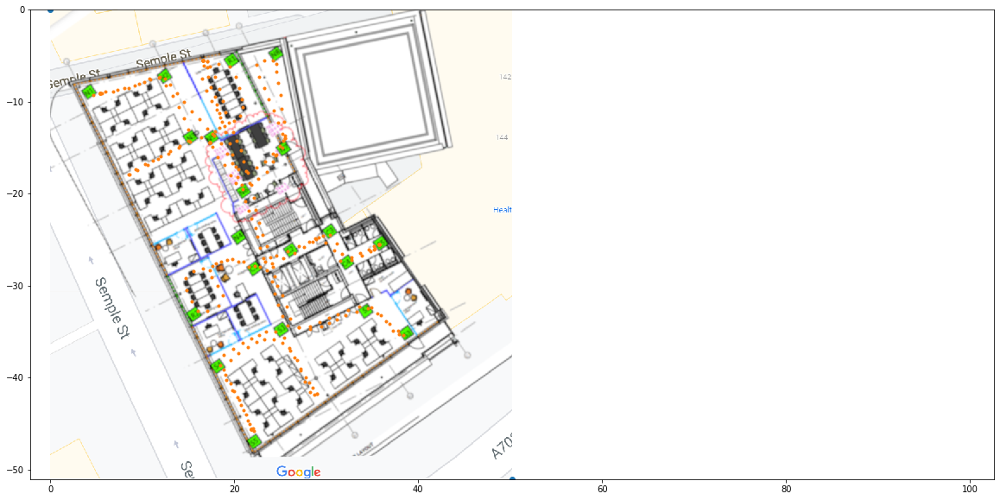

In [7]:
trajectory_coordinates_to_fusion_case_all(path_dualfoot_data, fusion_accuracy, fusion_step_length_error, fusion_orientation_error)
process_fusion_data_all(path_dualfoot_data, path_fusion_binary)
visualize_output_all(path_dualfoot_data, floorplan_image, floorplan_pgw)

# Running particle filter to estimate the global alignment
* Vanilla, naive implementation
* Uses trajectory as controls for the motion model
* Data associations given above used as only inputs

Fixing location 599.7638608704455 -144.22022944944985 20.1143


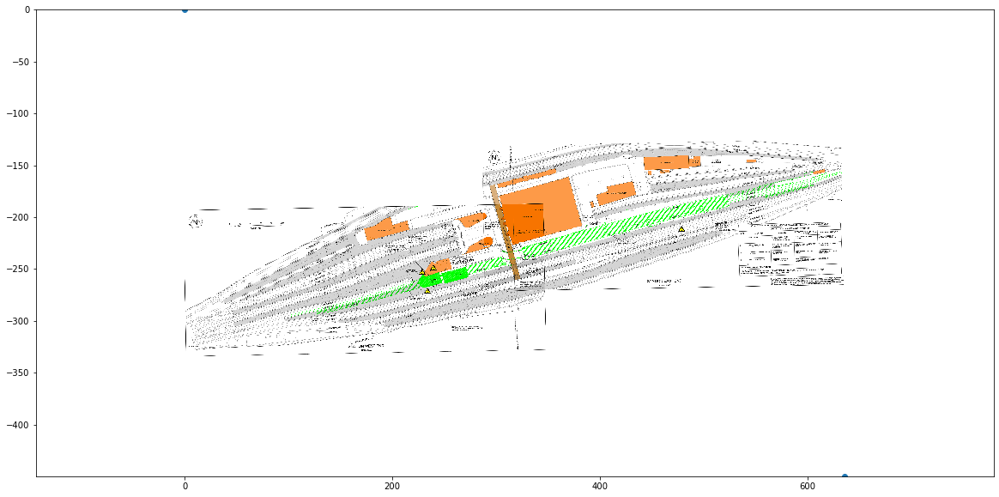

Fixing location 525.7308097530612 -139.22059482853558 81.1935


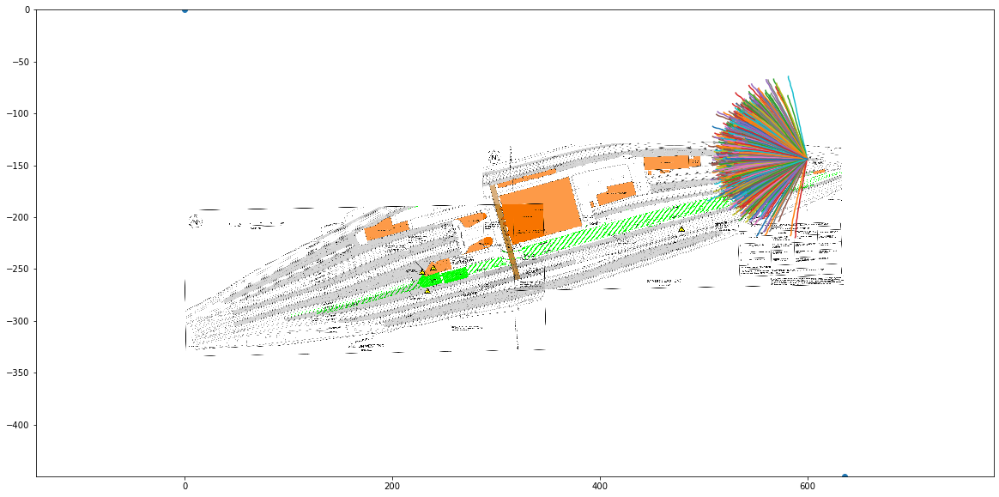

Resampling
Fixing location 510.9241995295844 -137.10536479661033 93.2387


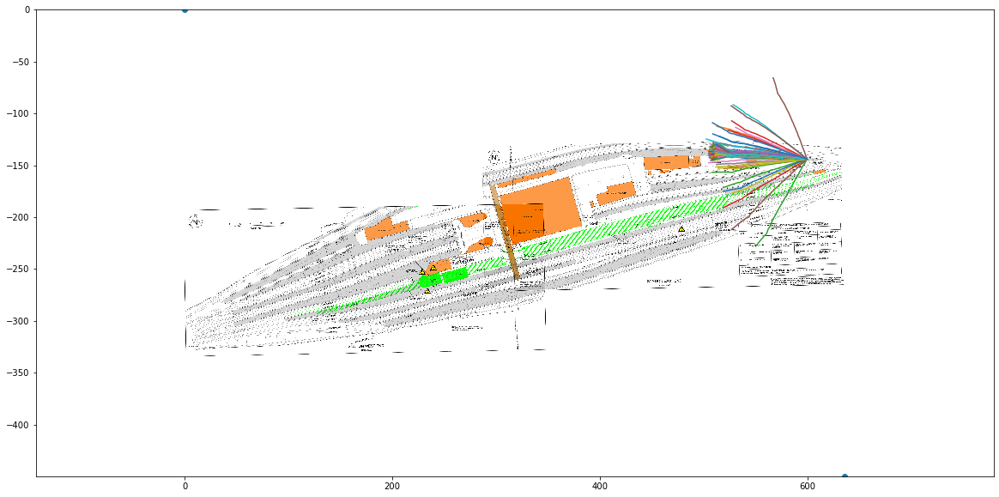

Resampling
Fixing location 474.7729953475889 -135.7593093217488 122.3529


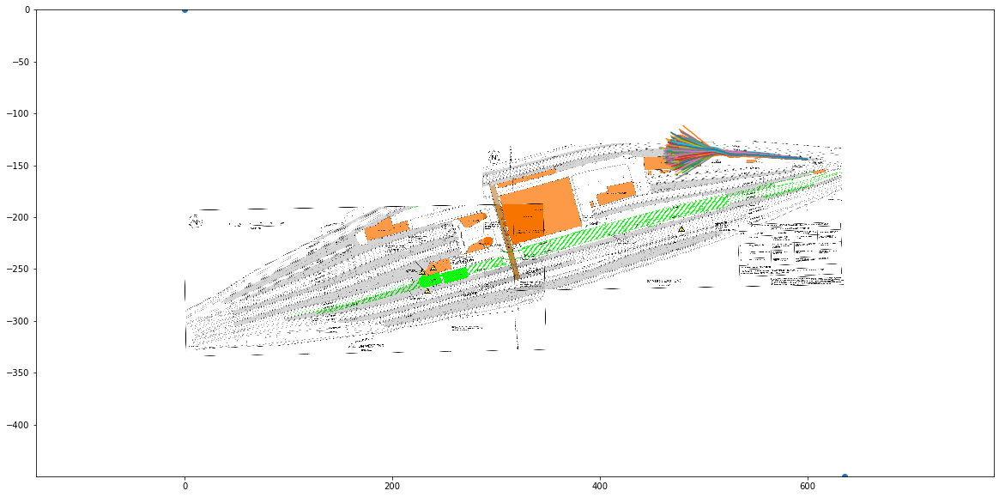

Resampling
Fixing location 419.5847208782661 -138.83600755000373 166.5638


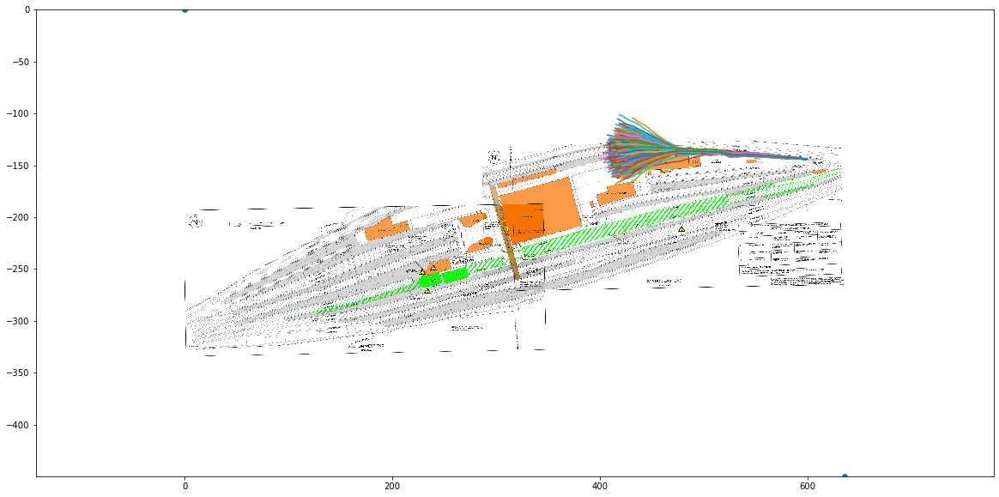

Resampling
Fixing location 372.28048561884657 -149.2198640703641 207.9892


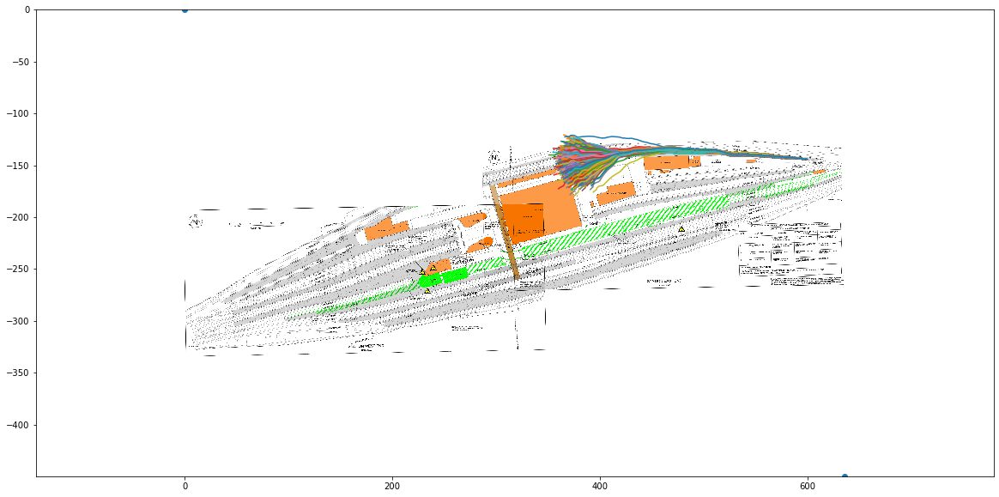

Resampling
Fixing location 341.7057969755632 -165.18023612943657 238.3883


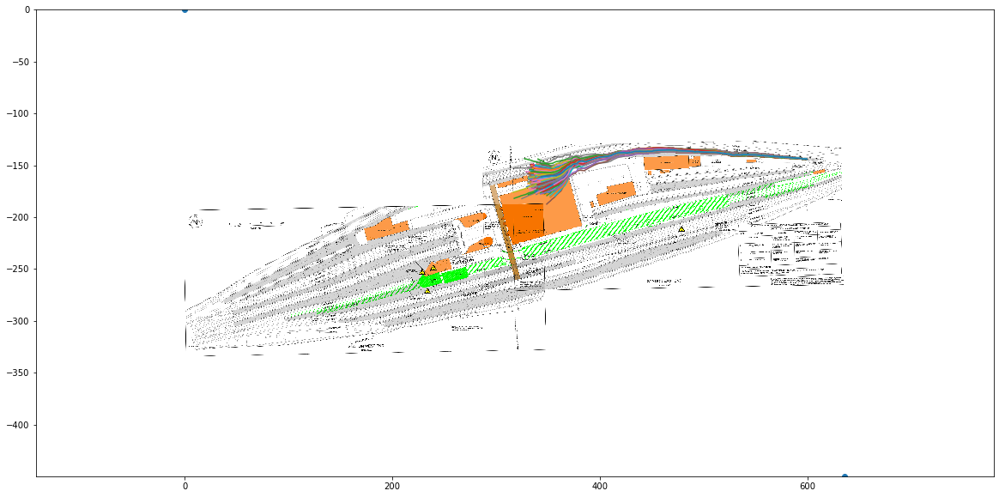

Resampling
Fixing location 309.2081719396205 -174.02574353566948 265.8413


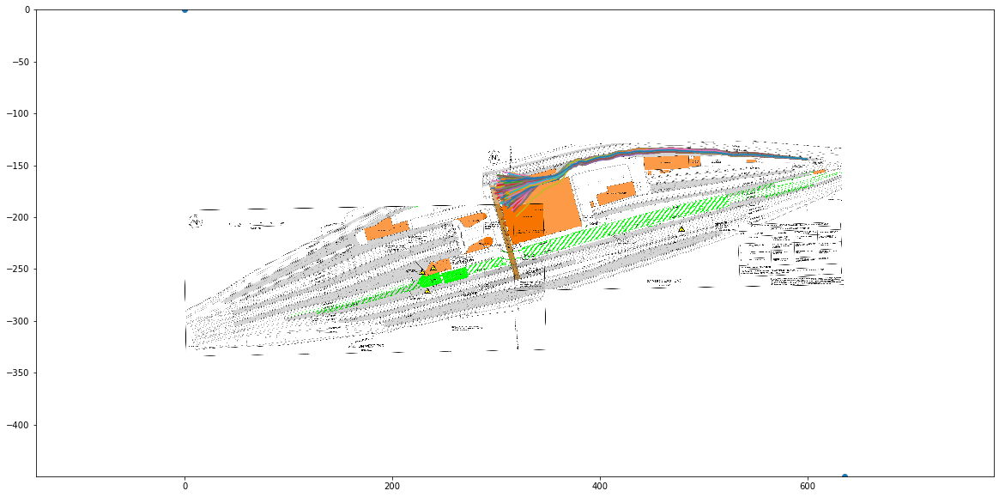

Resampling
Fixing location 299.4011963370579 -180.5637272707112 276.2704


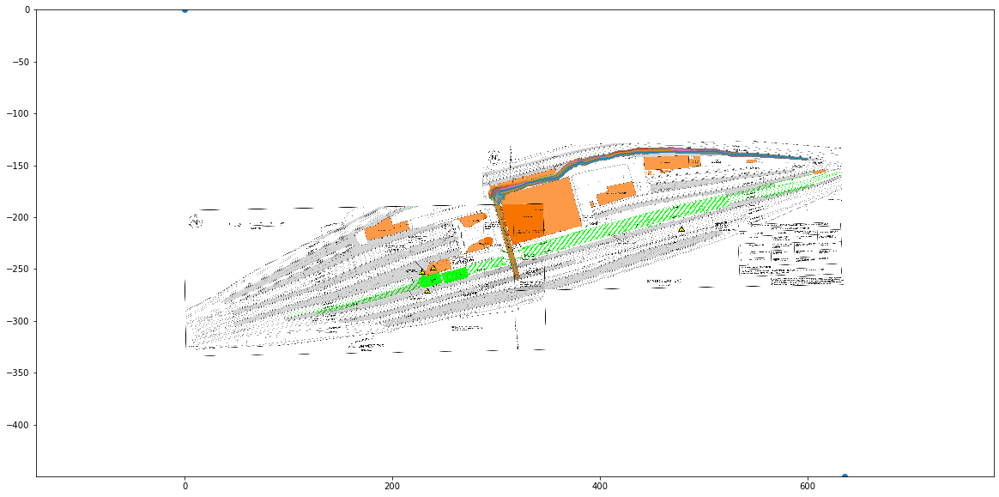

Resampling
Fixing location 312.09257652860947 -227.4833752515989 316.0045


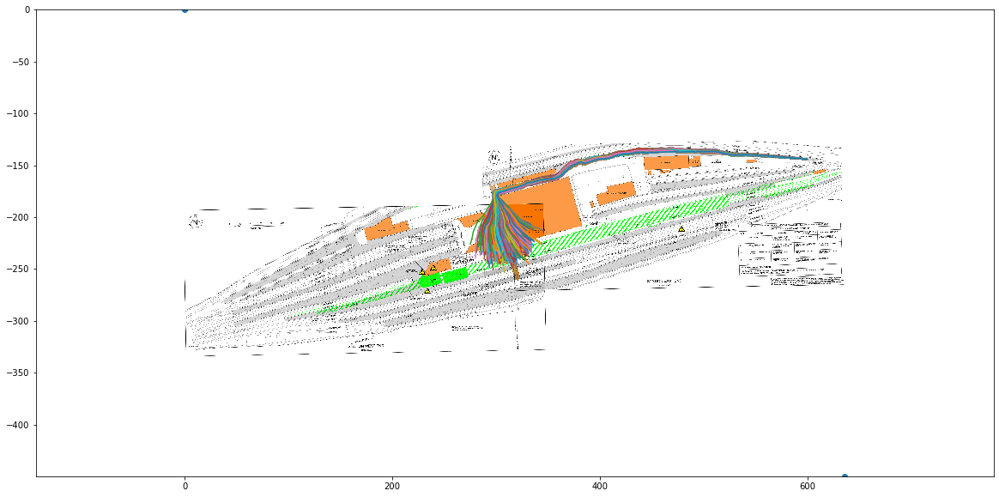

Resampling
Fixing location 315.55386203539626 -232.0984225939813 321.5252


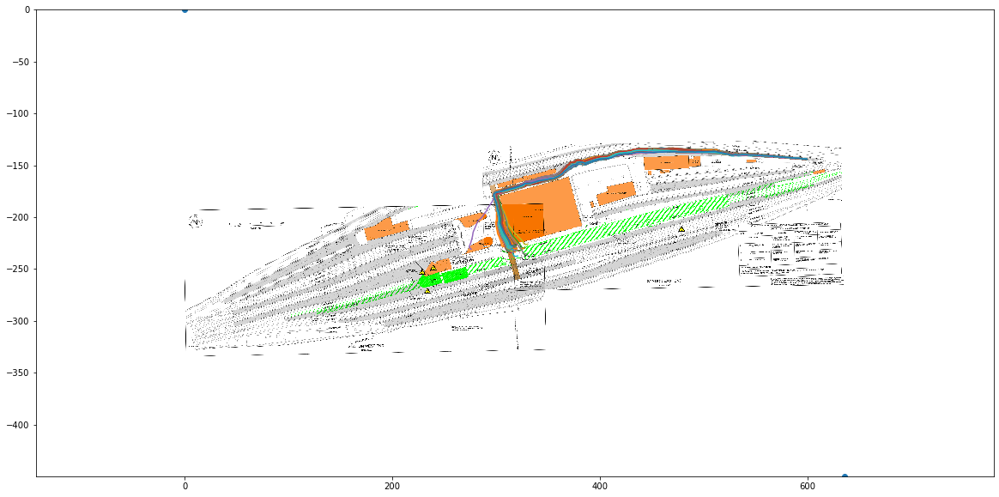

Resampling
Fixing location 336.3215750761171 -224.21438338407805 341.1238


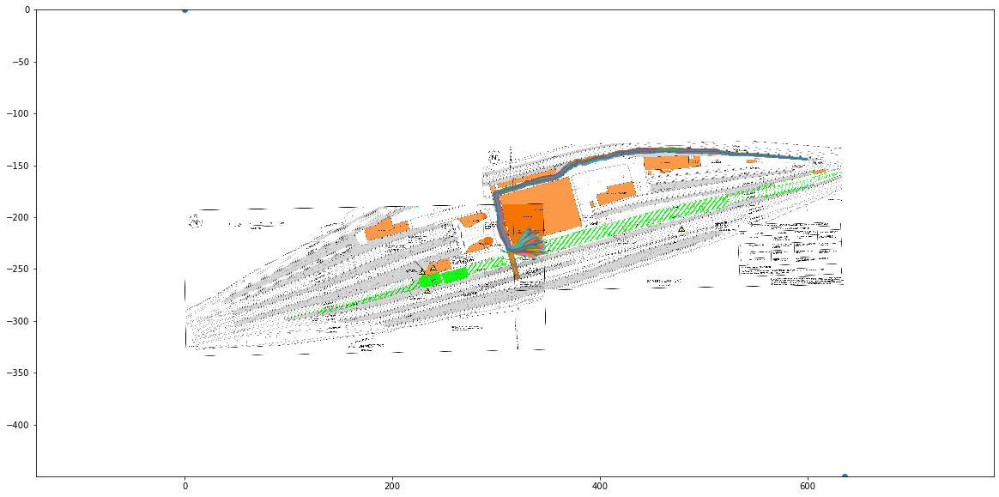

Resampling
Fixing location 347.859193432073 -221.1376851558231 353.7311


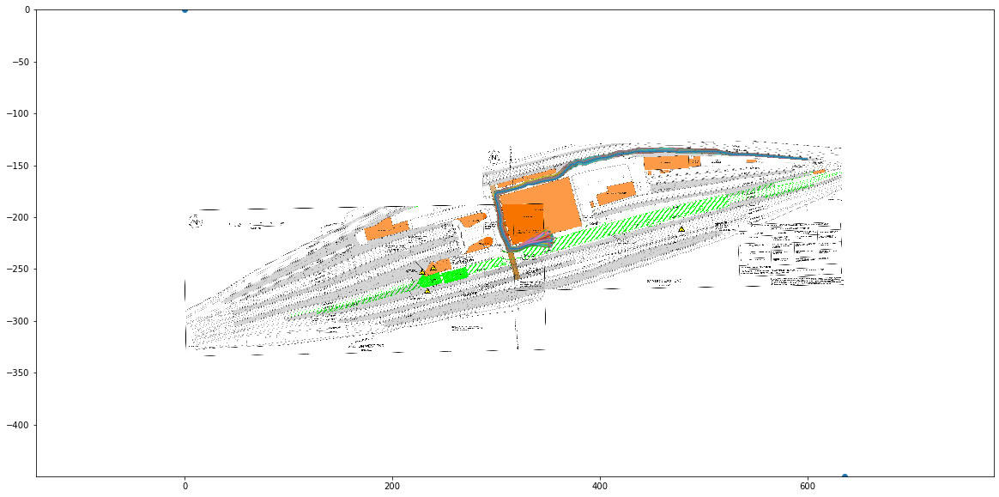

Resampling
Fixing location 383.6258103355366 -208.44630496427152 384.9683


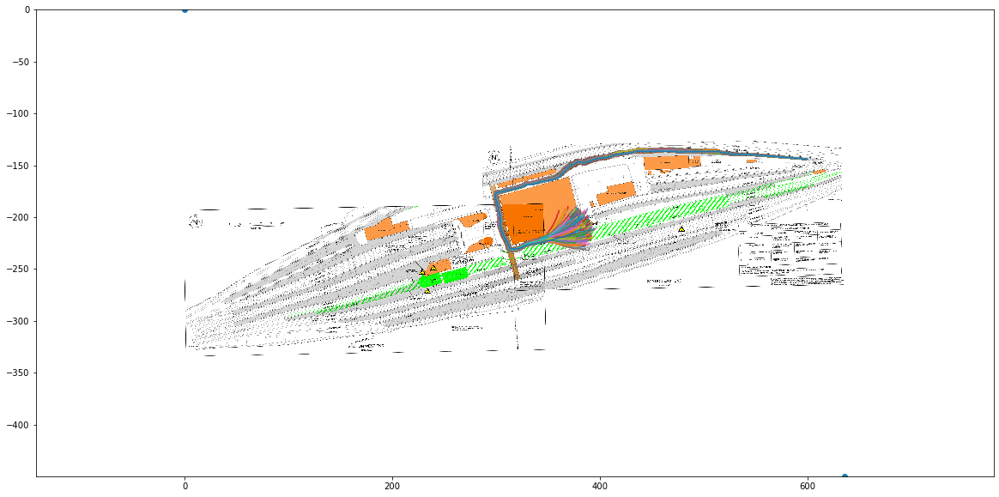

Resampling
Fixing location 379.9722311894839 -188.6400601198804 402.0775


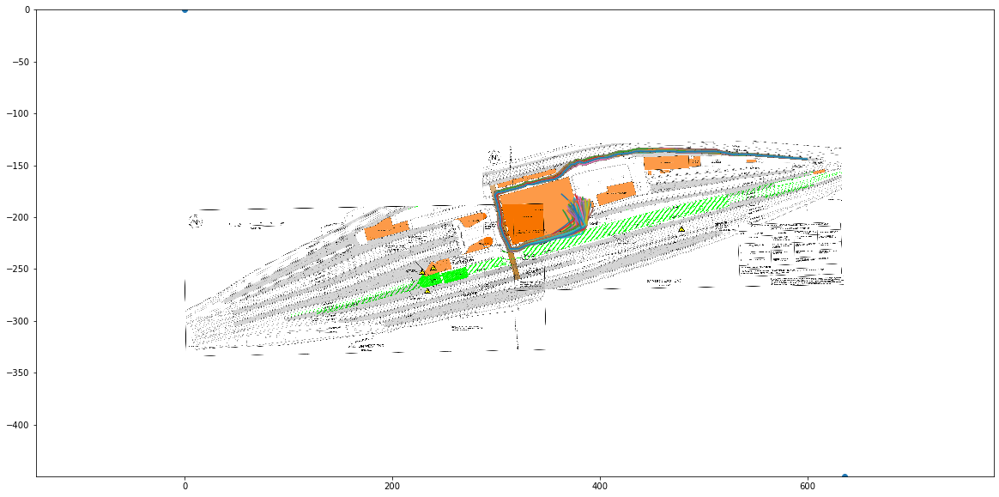

Resampling
Fixing location 375.5494774863674 -173.25656897860577 415.4677


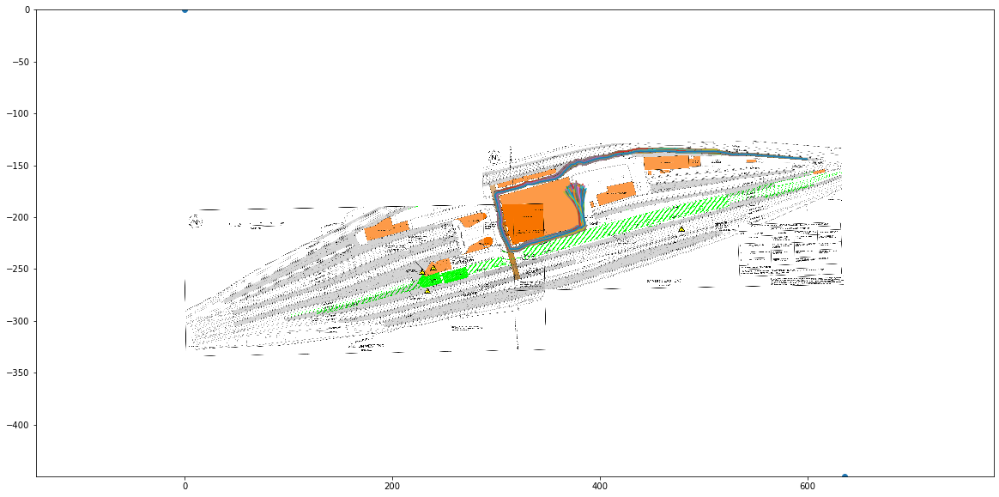

Resampling
Fixing location 372.28048561884657 -149.2198640703641 440.1453


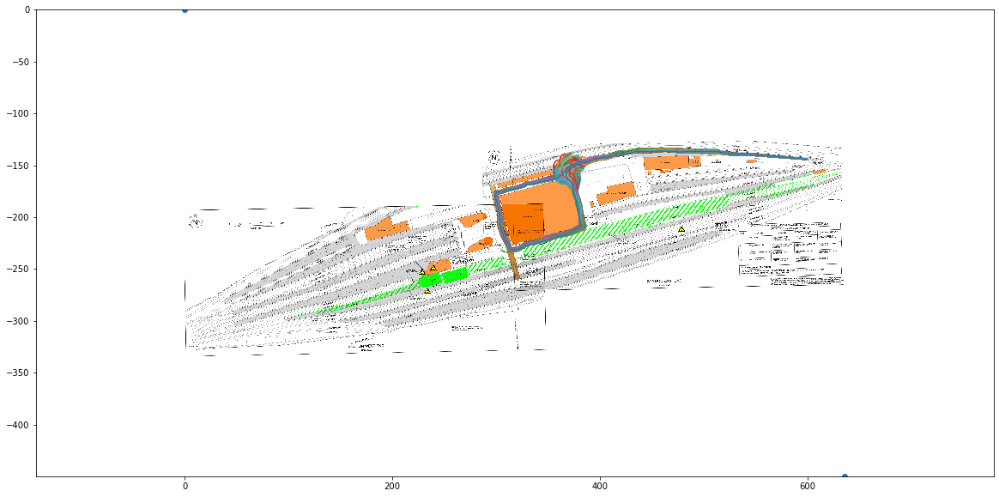

Resampling
Fixing location 419.5847208782661 -138.83600755000373 482.3738


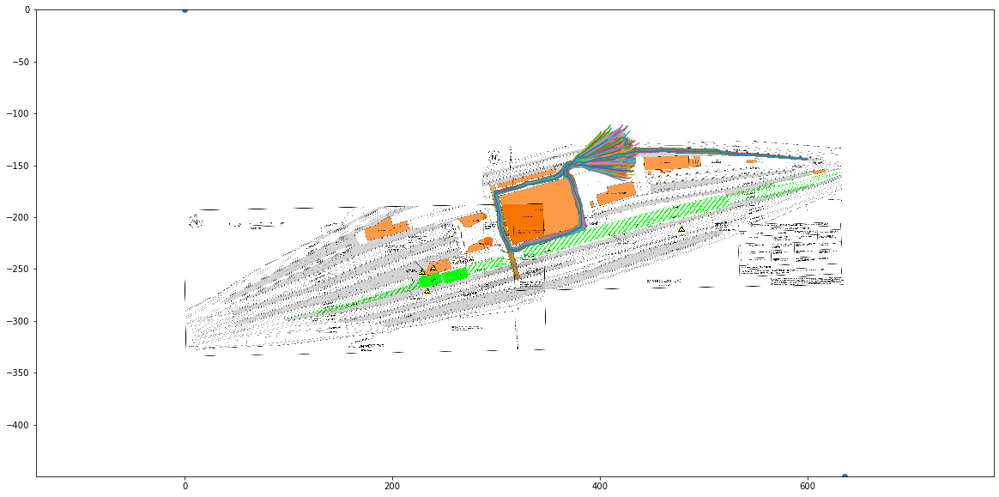

Resampling
Fixing location 474.7729953475889 -135.7593093217488 526.7754


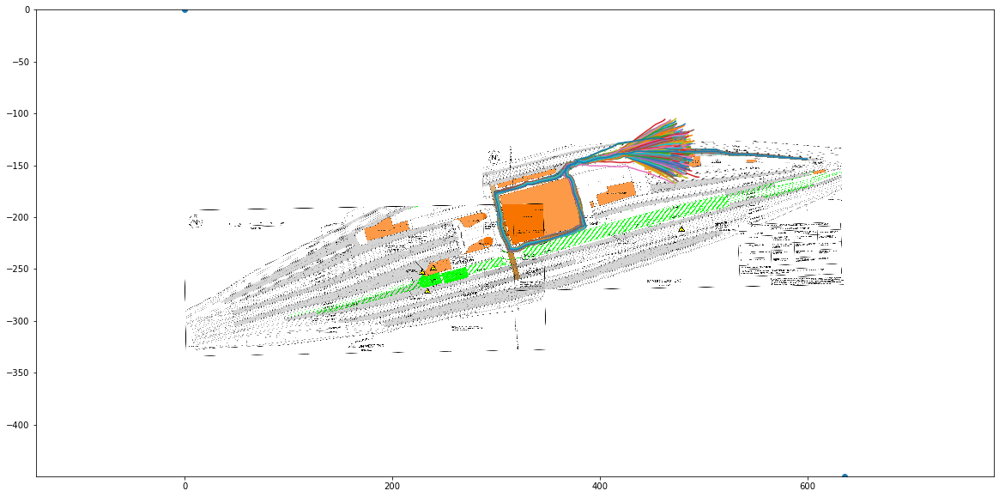

Resampling
Fixing location 510.9241995295844 -137.10536479661033 556.7528


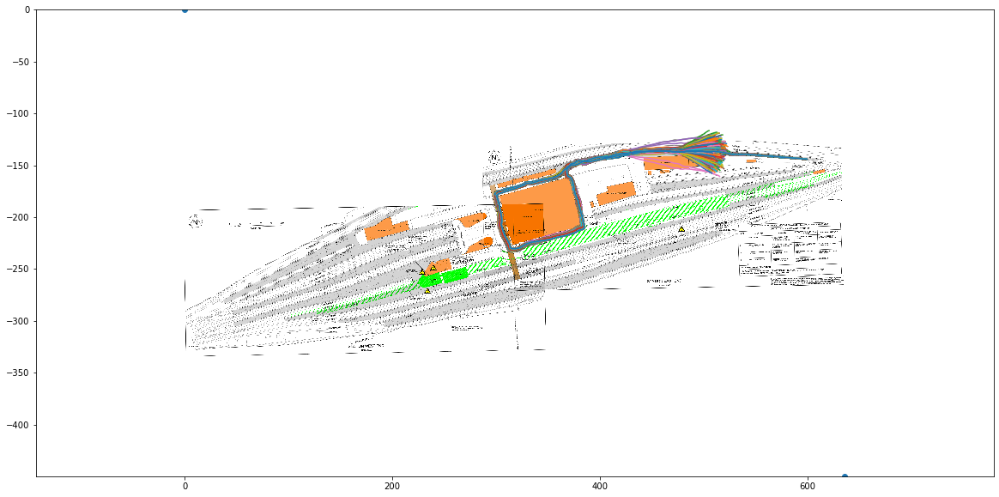

Resampling
Fixing location 525.7308097530612 -139.22059482853558 569.3802


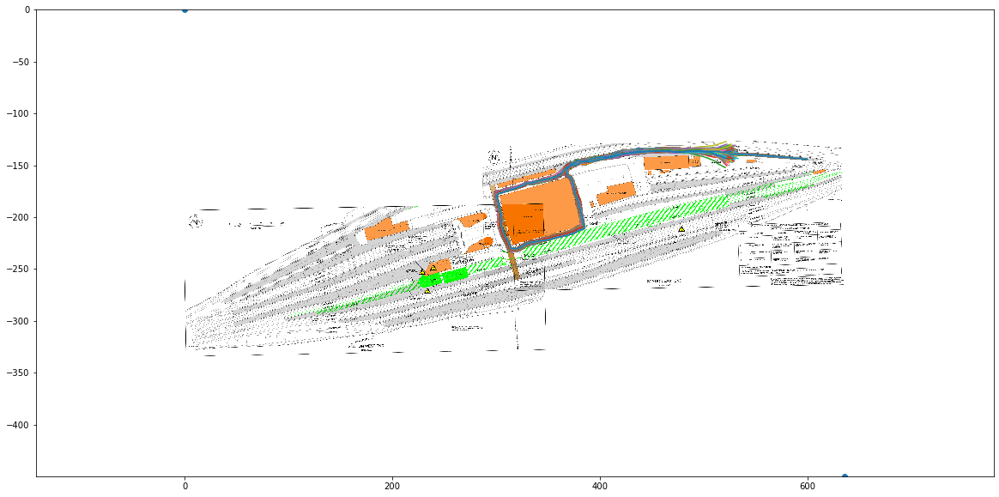

Resampling
Fixing location 599.7638608704455 -144.22022944944985 626.8057


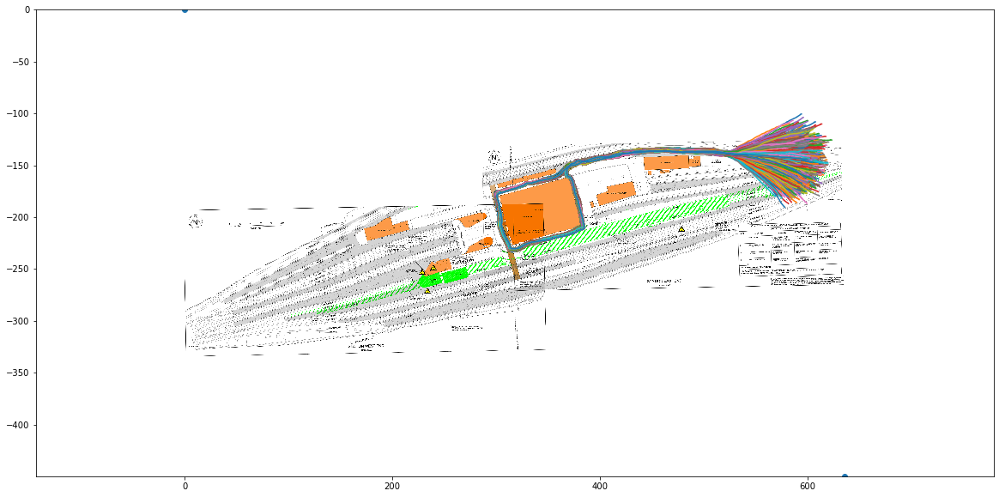

Resampling


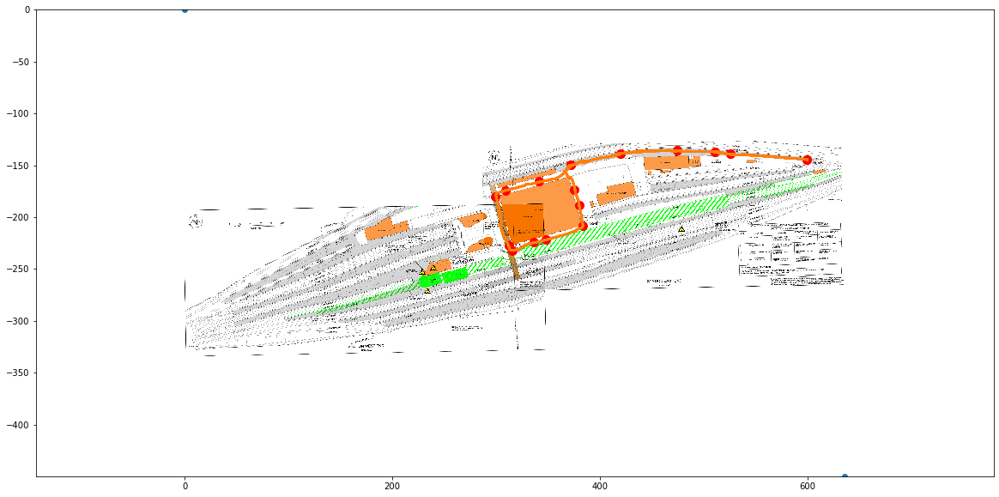

In [59]:
%matplotlib inline
plt.rcParams["figure.figsize"] = (20,10)

def location_likelihood(p, known_x, known_y):
    d = math.hypot(p.x - known_x, p.y - known_y)
    dev = 1.0
    return math.exp(-0.5*(d*d)/(dev*dev)) + 0.0001

# 
# raw = pd.read_csv('gt_fixes.csv')

def plot_histories(cloud):
    for p in cloud.particles:
        plt.plot(*zip(*p.history), '-')
    # plt.axis('equal')
    plt.show()

clouds = []
trajectories_aligned = []

dev = (0.05, 0.001, 0.02)
dev_roughen = (0, 0, math.pi*0.05)
p_count = 2000

subdirs = os.listdir(path_dualfoot_data) 

for traj_name in trajs:
    traj = map_info[traj_name]
    path = os.path.join(path_dualfoot_data, traj['subdir'])
    data = read_pf_data(path, truncate_to_last_timestamp)
    
    known_locations = read_known_locations(path)
    
    xs, ys, ts = data['trajectory']
    init_pf = data['init_pf'][0]
    controls = extract_control(xs, ys, ts)
    
    cloud = Cloud(p_count, Particle(0, 0, 0))
    clouds.append(cloud)
    
    fixed = False
    
    init_move = (init_pf['x'], init_pf['y'], init_pf['heading'])
    
    cloud.set_pose(controls[0][0] + init_move[0], controls[0][1] + init_move[1], controls[0][2] + init_move[2])
    cloud.record_history()
    
    for p in cloud.particles:
        p.scale = init_pf['scale'] + random.gauss(0, 0.1)
        
    location_index = 0
    
    for ctrl in controls[1:]:
        # print(ctrl)
        t = ctrl[3]
        cloud.move(ctrl, dev)
        cloud.record_history()
        
        if location_index >= len(known_locations.t):
            location_index = 0
        t_location = known_locations.t[location_index]
        if abs(t - t_location) < 0.25:
            fixed = True
            known_x = known_locations.x[location_index]
            known_y = known_locations.y[location_index]
            location_index += 1
            print("Fixing location", known_x, known_y, t)
            plt.figure()
            plot_image_scale(plt.gca(), floorplan_image, floorplan_scale)
            plot_histories(cloud)
            plt.show()
            
            cloud.update_weights(partial(location_likelihood, known_x = known_x, known_y = known_y))
            if cloud.neff_ratio() < 0.8:
                print('Resampling')
                cloud.resample()
                cloud.roughen(dev_roughen)
                for p in cloud.particles:
                    p.scale += random.gauss(0, 0.1)
                
    plt.figure()
    plot_image_scale(plt.gca(), floorplan_image, floorplan_scale)
    plt.plot(known_locations.x, known_locations.y, 'or', markersize = 10)
    plt.plot(*zip(*cloud.mean_history()), '.', markersize = 3)

    # plt.axis('equal')
    plt.show()
    
    ts_to_save = [c[3] for c in controls]
    xs_to_save = [c[0] for c in cloud.mean_history()]
    ys_to_save = [c[1] for c in cloud.mean_history()]
    
    data_to_save = {'x': xs_to_save, 'y': ys_to_save, 't': ts_to_save }
    trajectories_aligned.append(data_to_save)
    df = pd.DataFrame(data_to_save)
    df.to_csv(path +'/trajectory_aligned.csv', index=False)

Fixing location 577.6500923548632 -156.7193160017355 2.6339


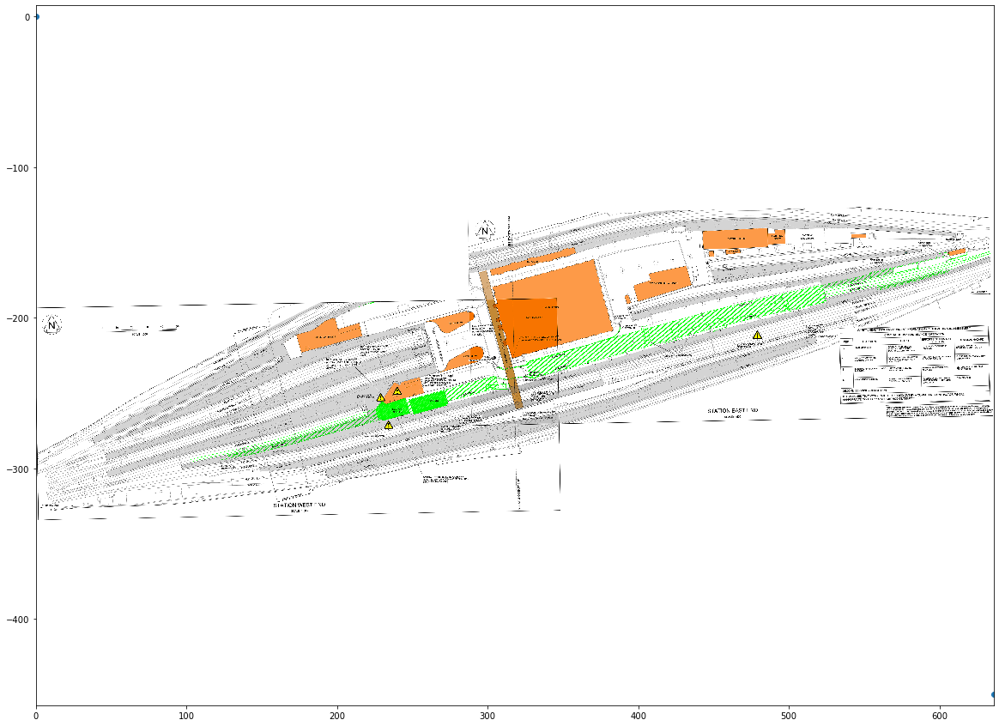

Fixing location 529.3843888991139 -162.10353790118162 42.4198


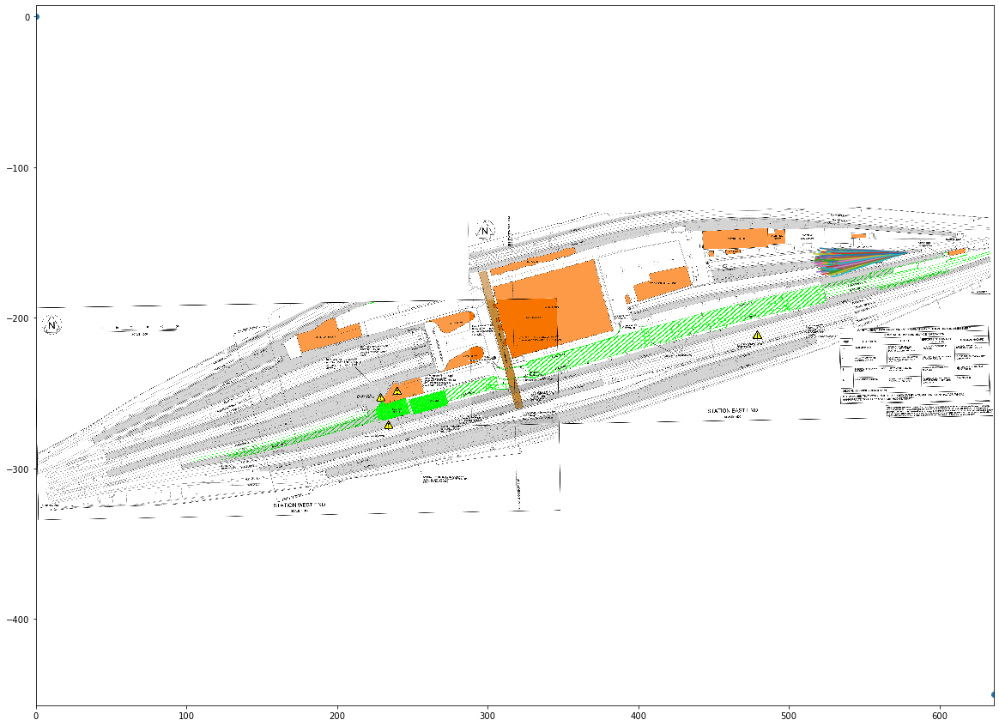

Resampling
Fixing location 448.813354046688 -170.56445802888268 112.5658


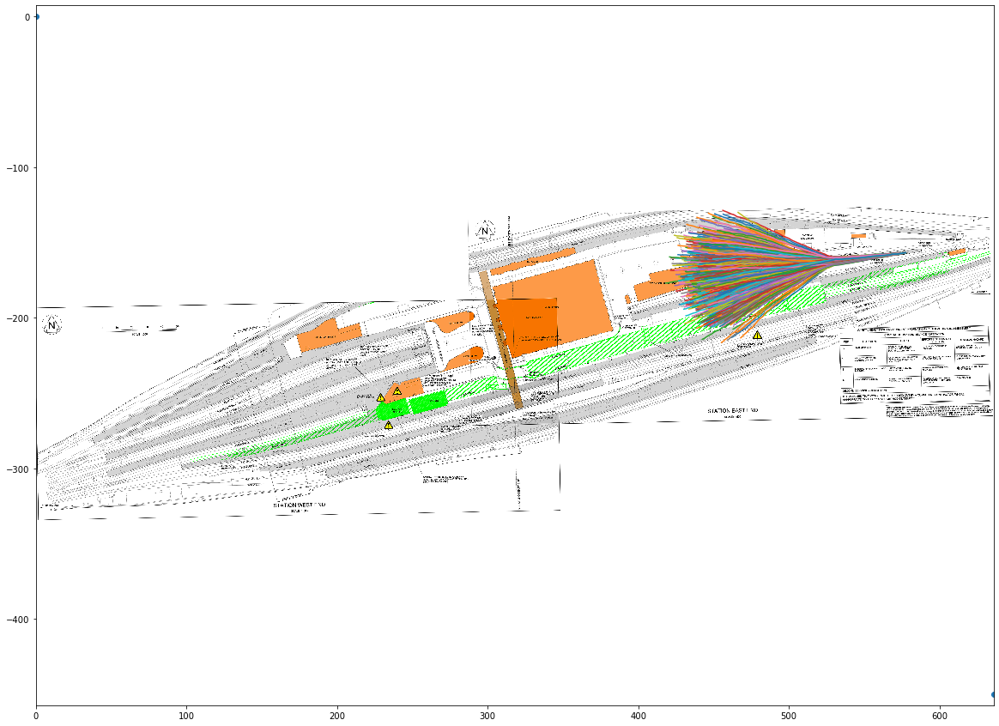

Resampling
Fixing location 440.73702119751874 -161.3343633441179 126.594


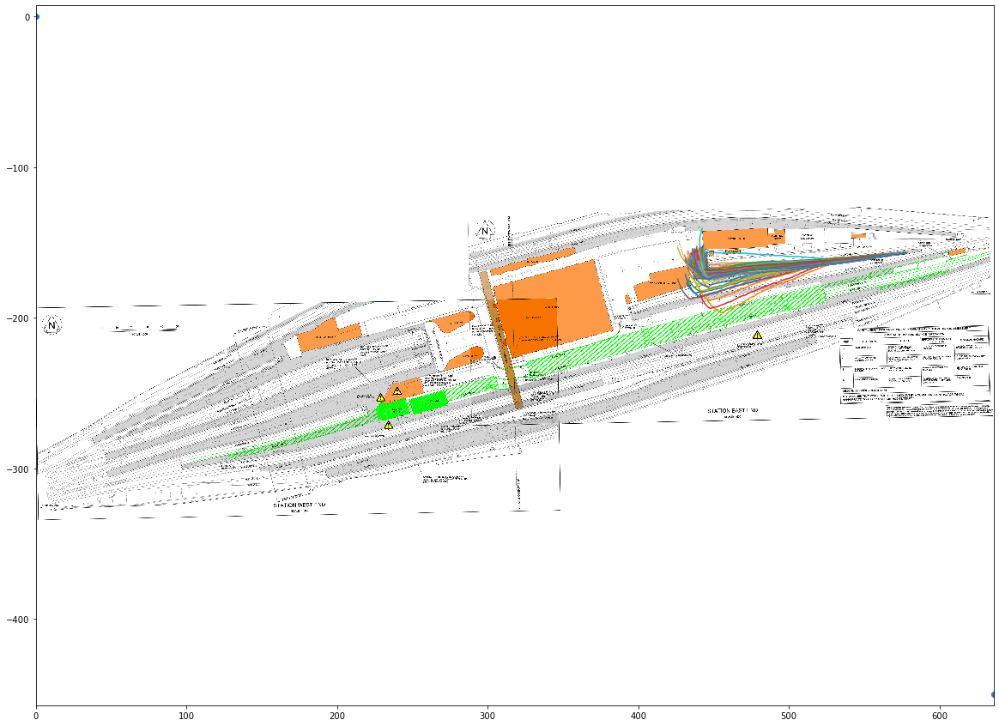

Resampling
Fixing location 437.8526166085297 -147.4892213169707 137.41


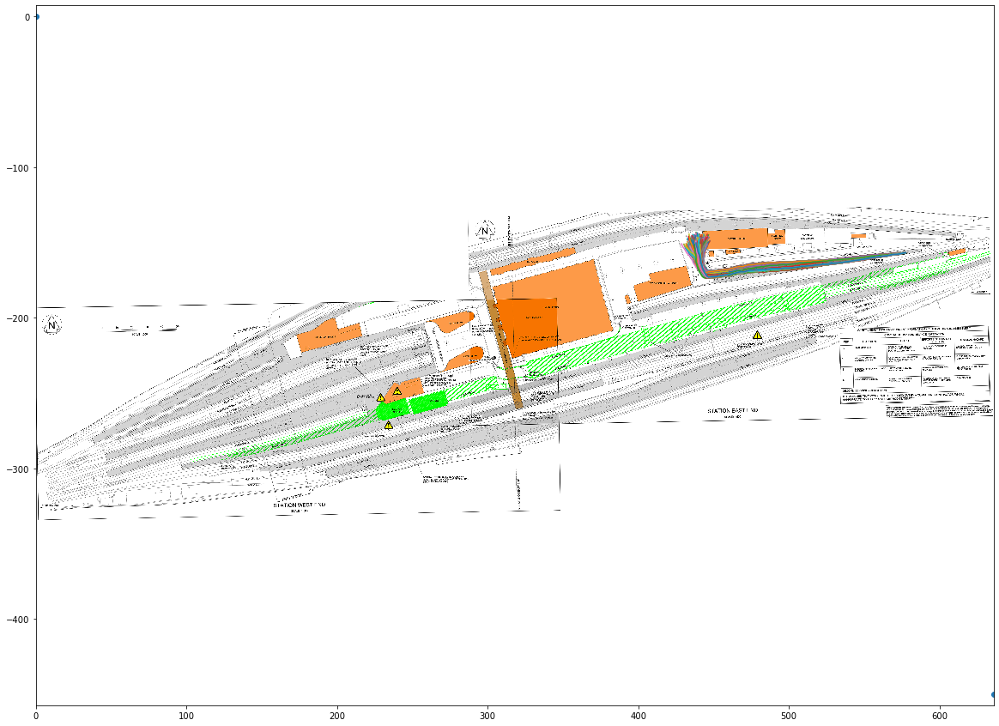

Resampling
Fixing location 474.7729953475889 -135.7593093217488 173.4317


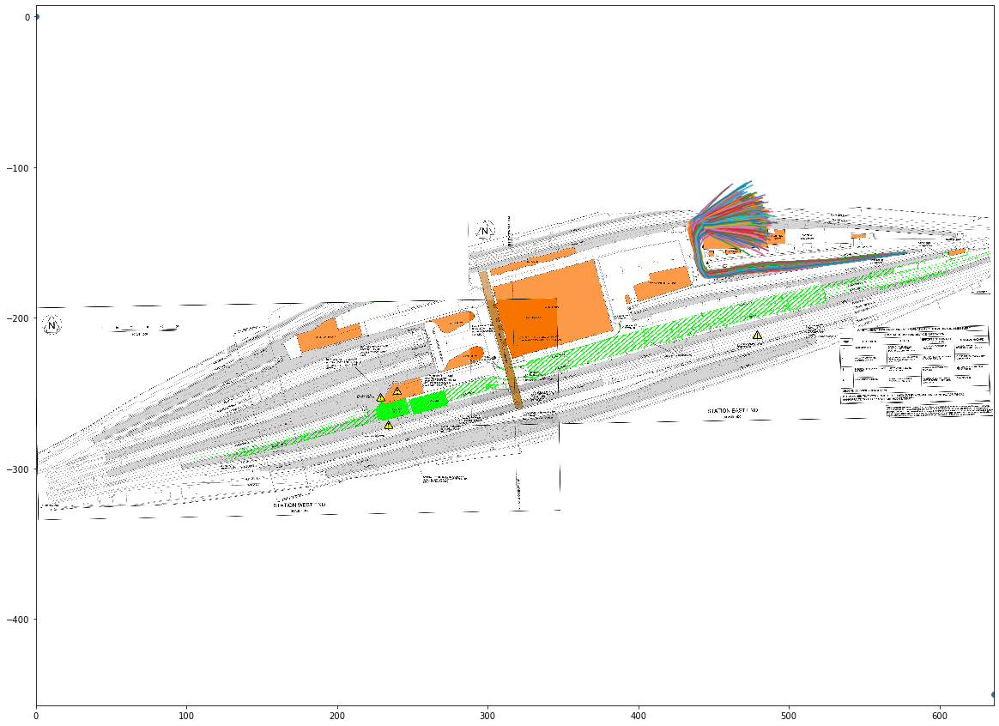

Resampling
Fixing location 510.9241995295844 -137.10536479661033 203.5358


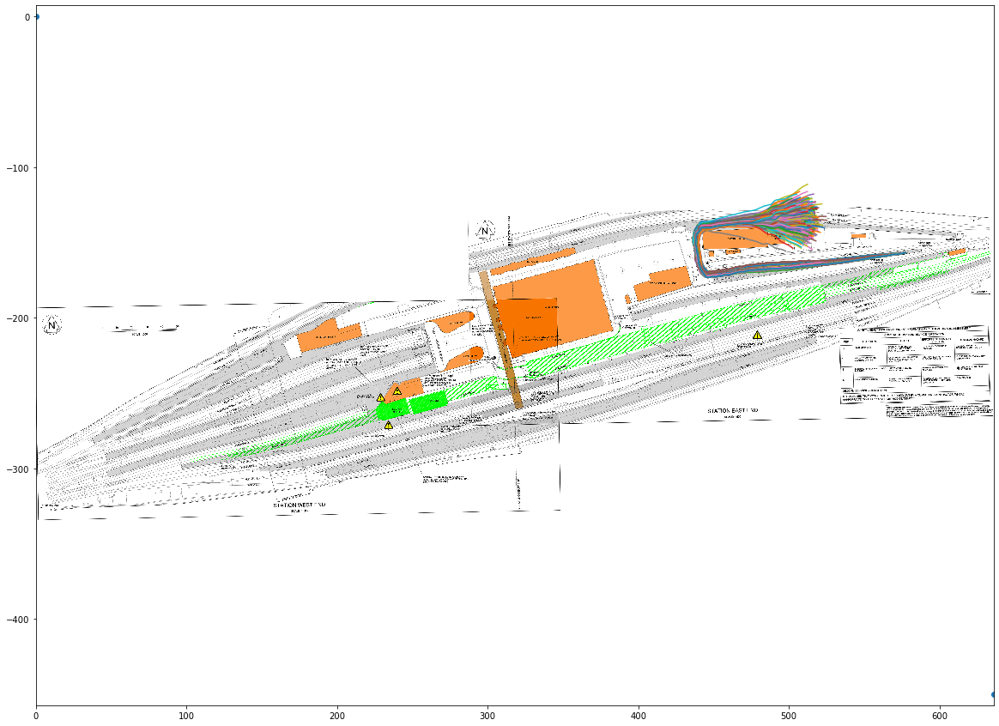

Resampling
Fixing location 525.7308097530612 -139.22059482853558 215.3406


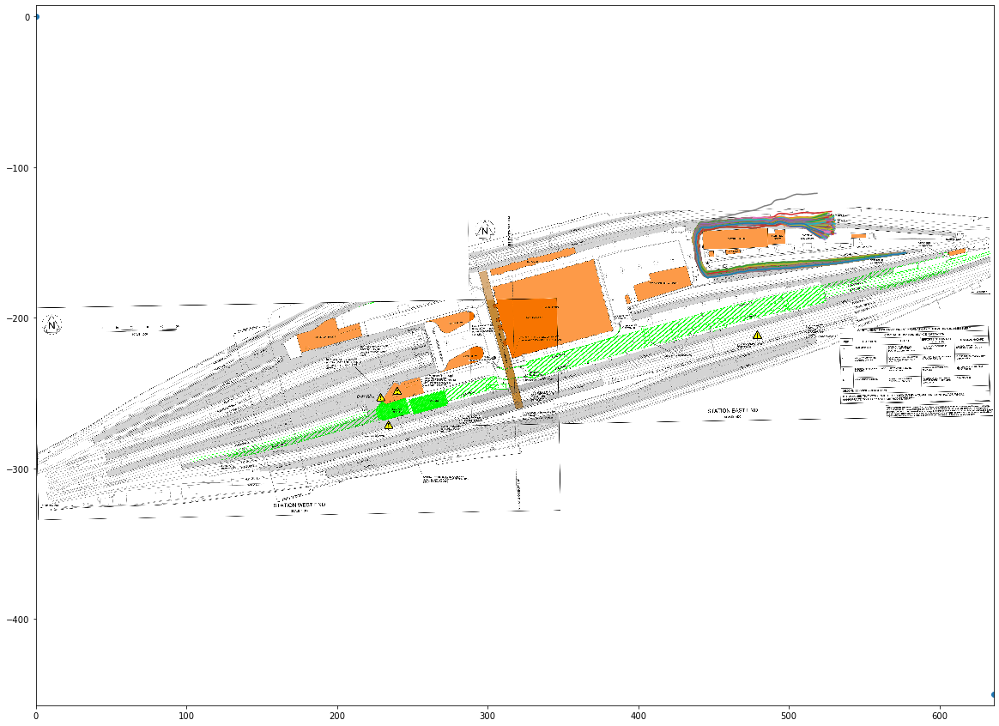

Resampling
Fixing location 599.7638608704455 -144.22022944944985 271.9252


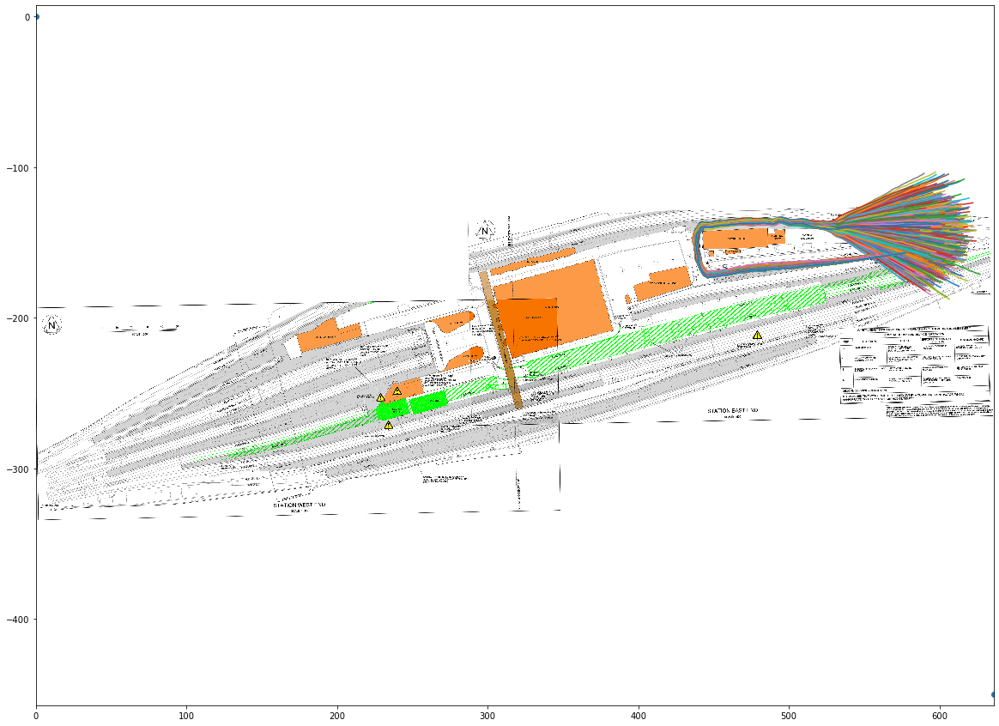

Resampling
Fixing location 525.7308097530612 -139.22059482853558 333.0671


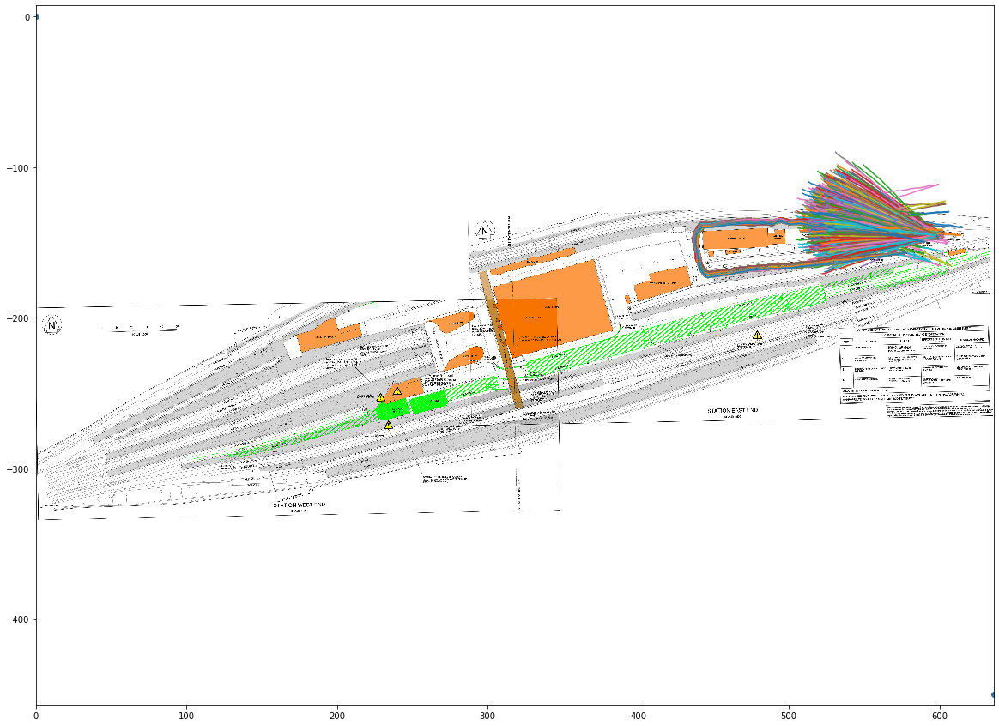

Resampling
Fixing location 510.9241995295844 -137.10536479661033 343.8781


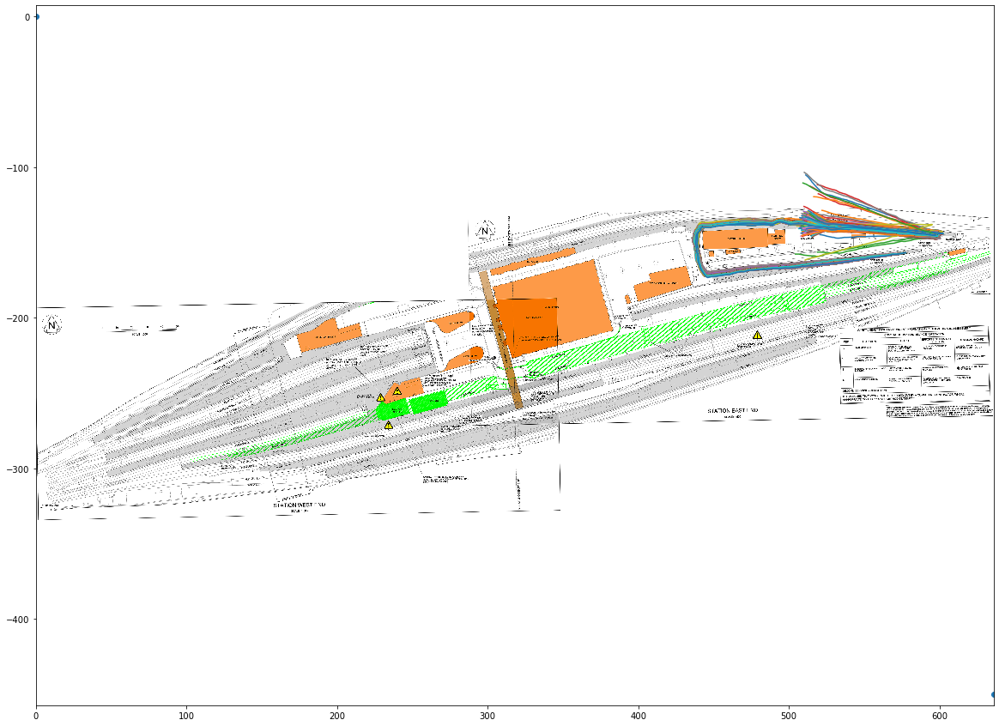

Resampling
Fixing location 474.7729953475889 -135.7593093217488 374.1027


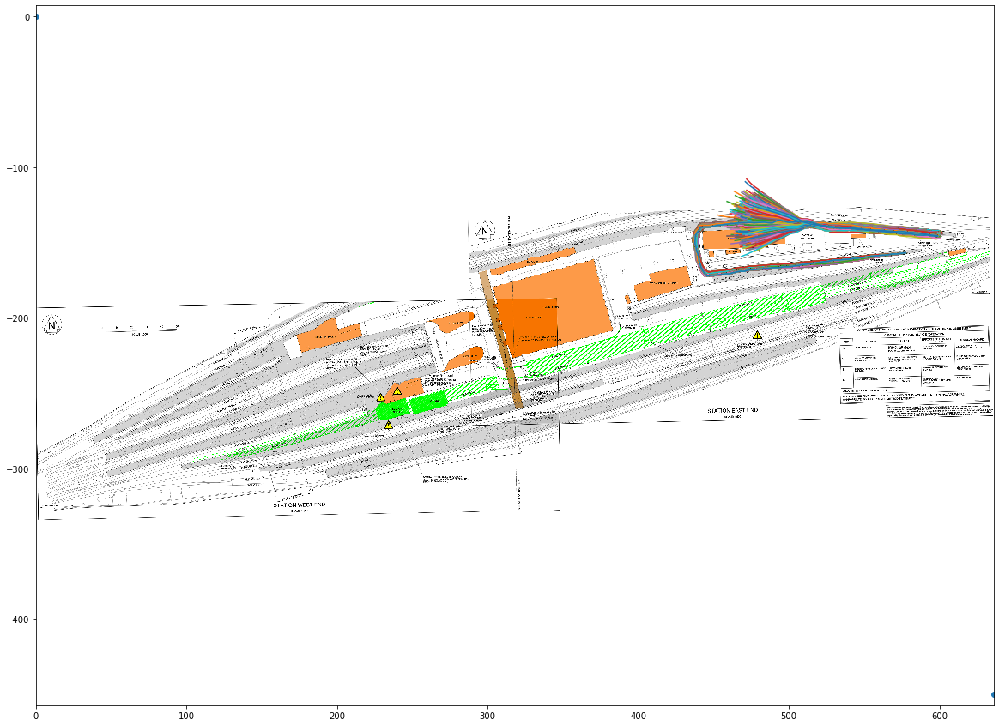

Resampling
Fixing location 437.8526166085297 -147.4892213169707 408.3325


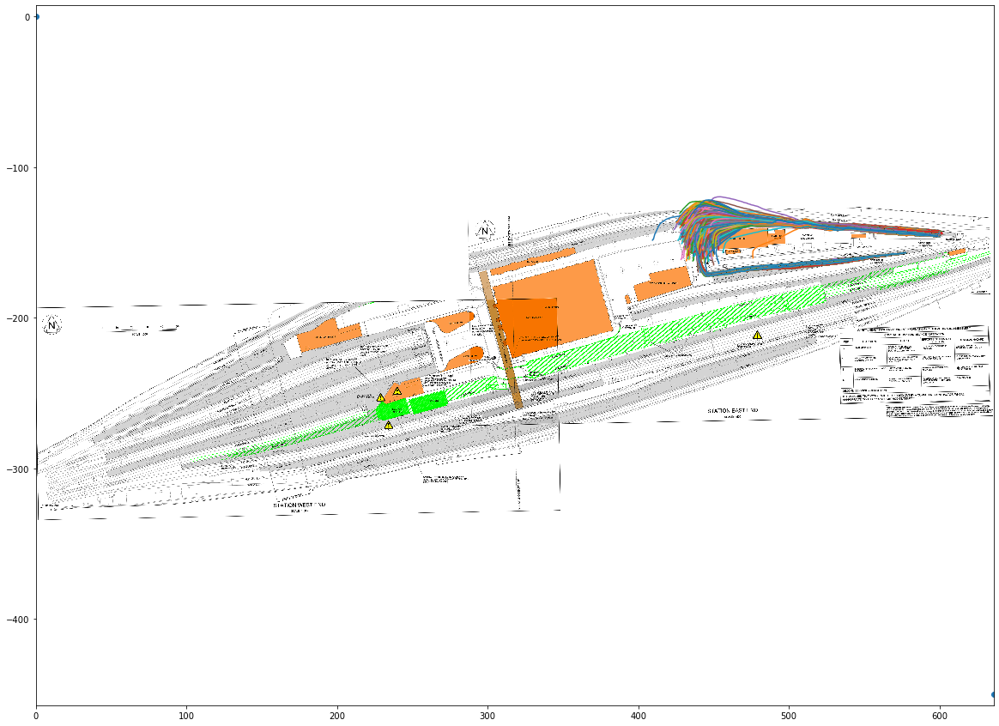

Resampling
Fixing location 399.778476033875 -164.02647429384098 443.9526


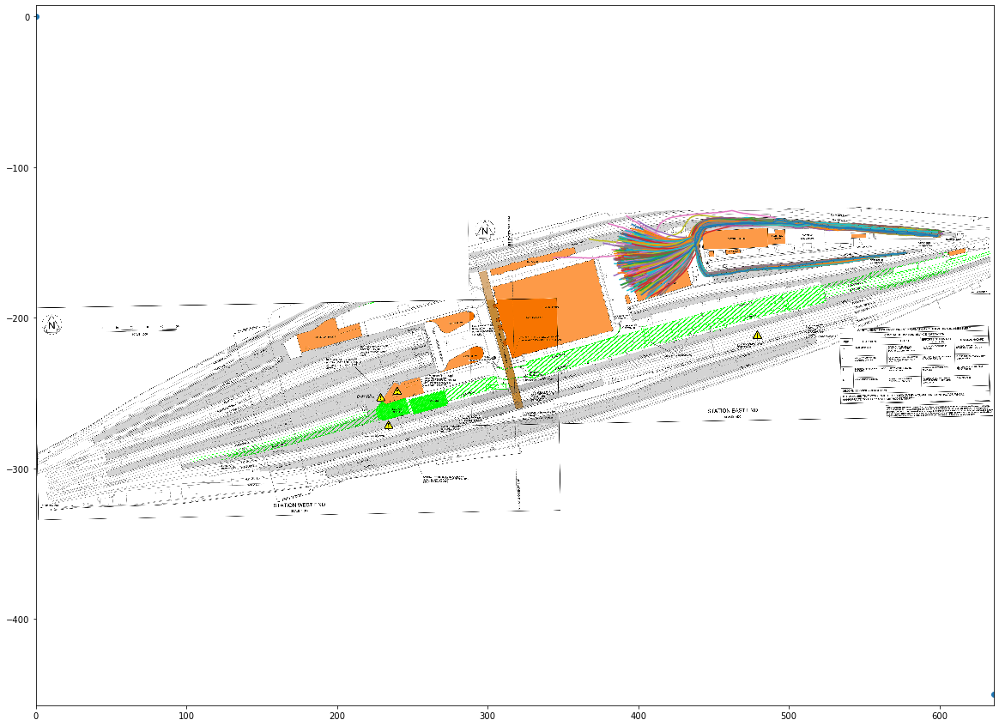

Resampling
Fixing location 375.5494774863674 -173.25656897860577 466.8495


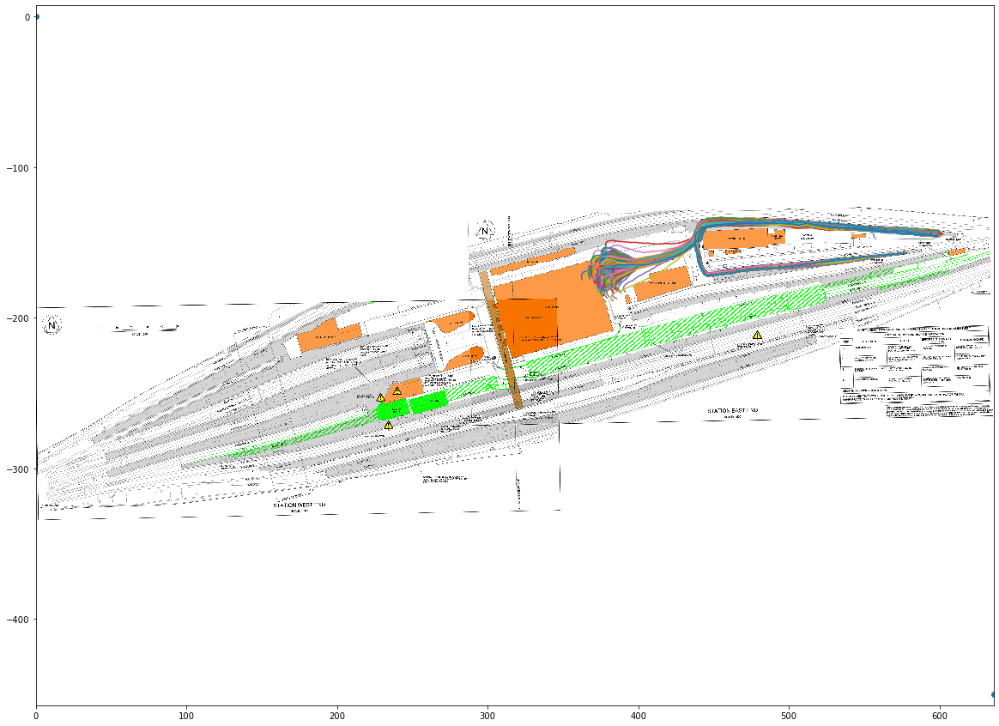

Resampling
Fixing location 379.9722311894839 -188.6400601198804 480.8425


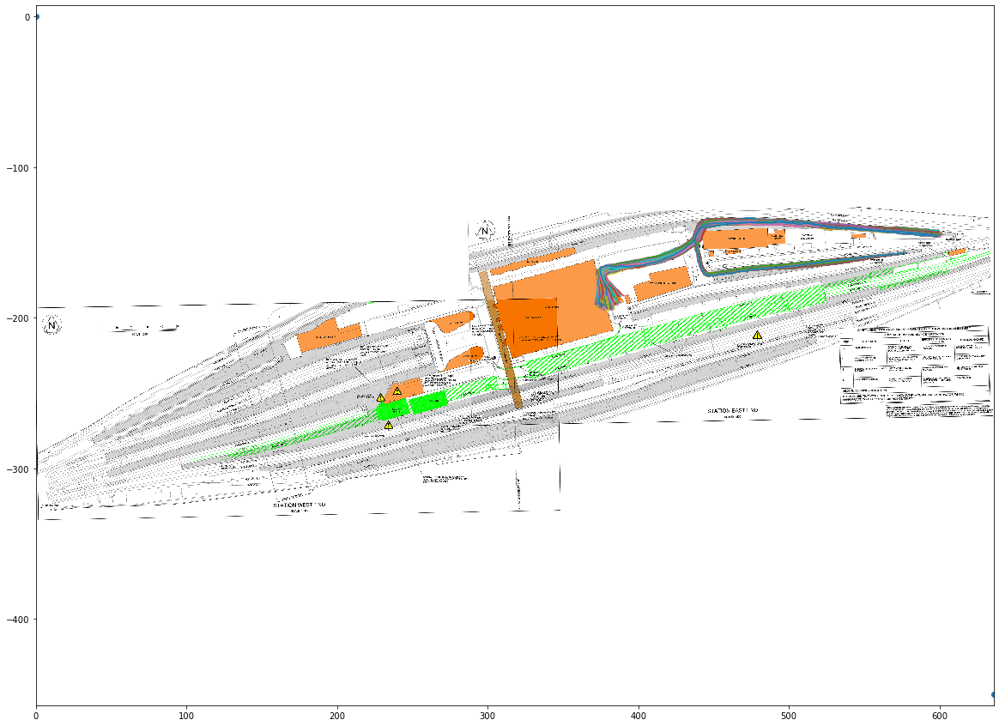

Resampling
Fixing location 375.5494774863674 -173.25656897860577 497.7466


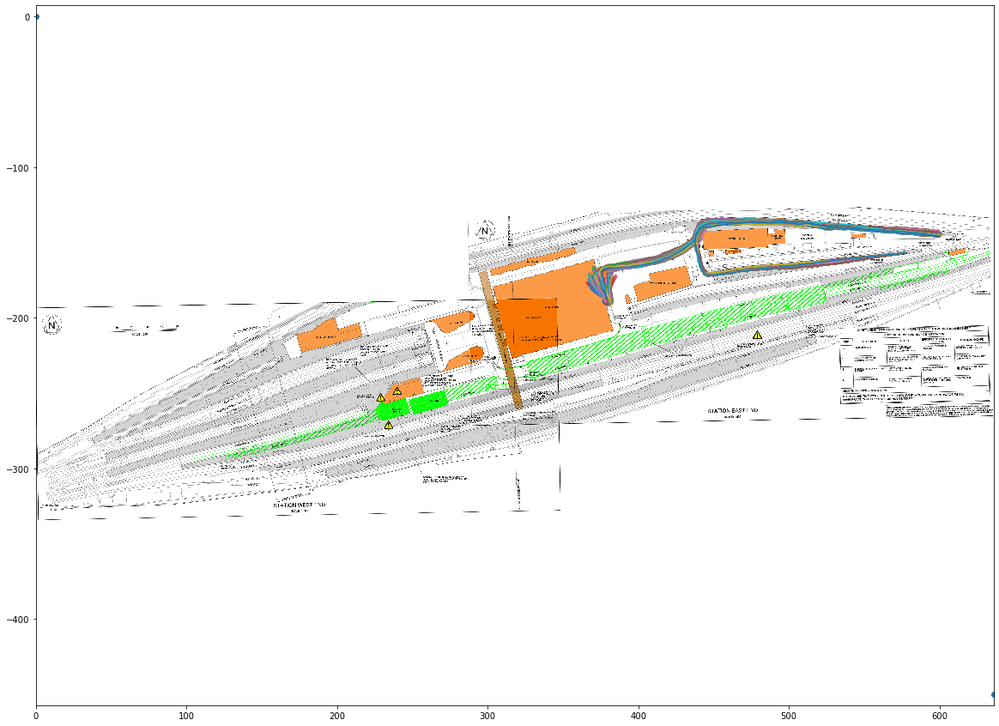

Resampling
Fixing location 399.778476033875 -164.02647429384098 519.5443


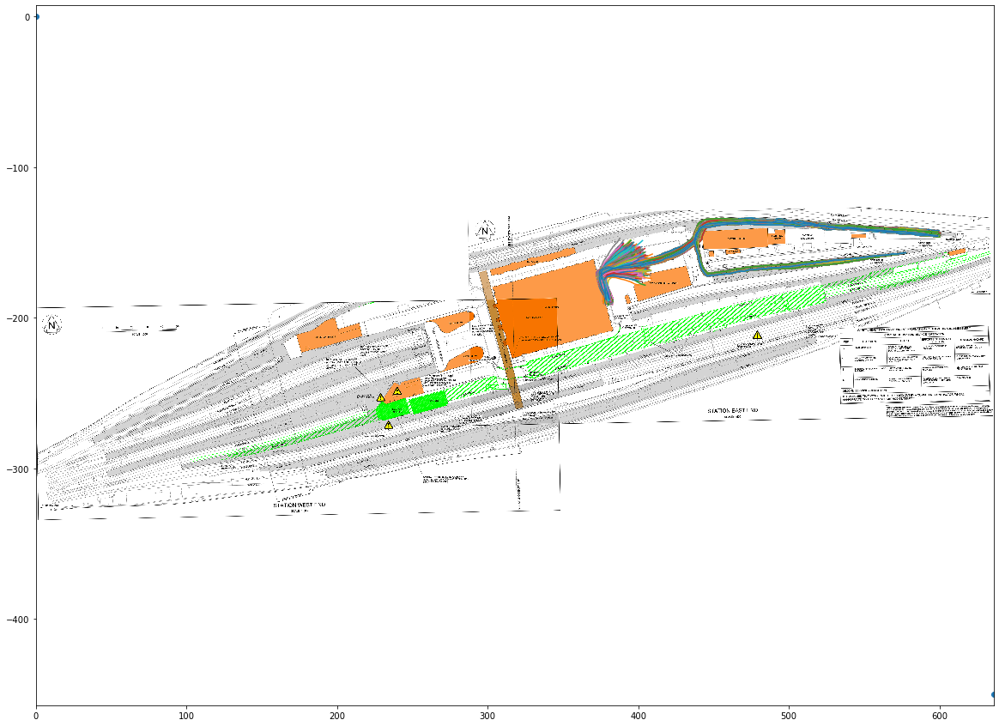

Resampling
Fixing location 440.73702119751874 -161.3343633441179 552.946


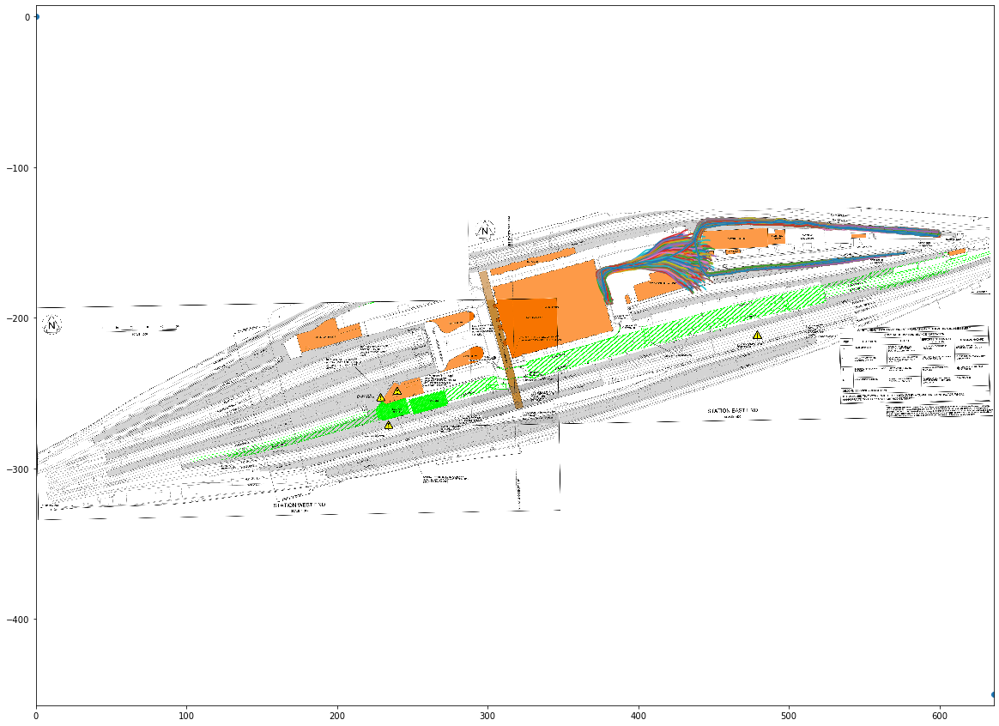

Resampling
Fixing location 448.813354046688 -170.56445802888268 566.7684


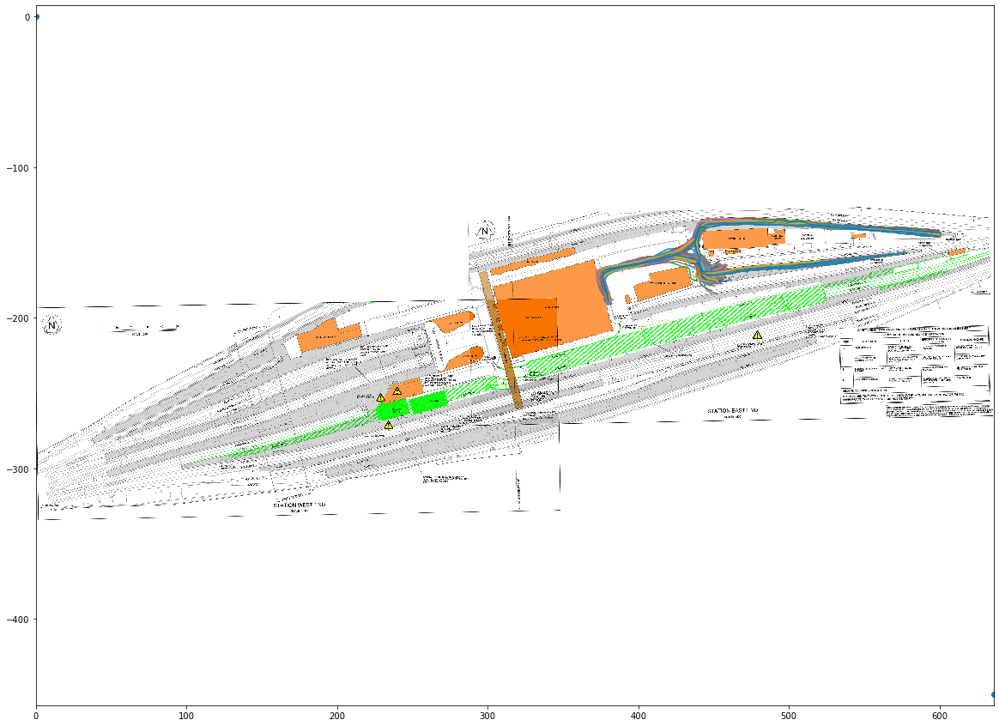

Resampling
Fixing location 483.6185027538219 -166.91087888282996 596.2201


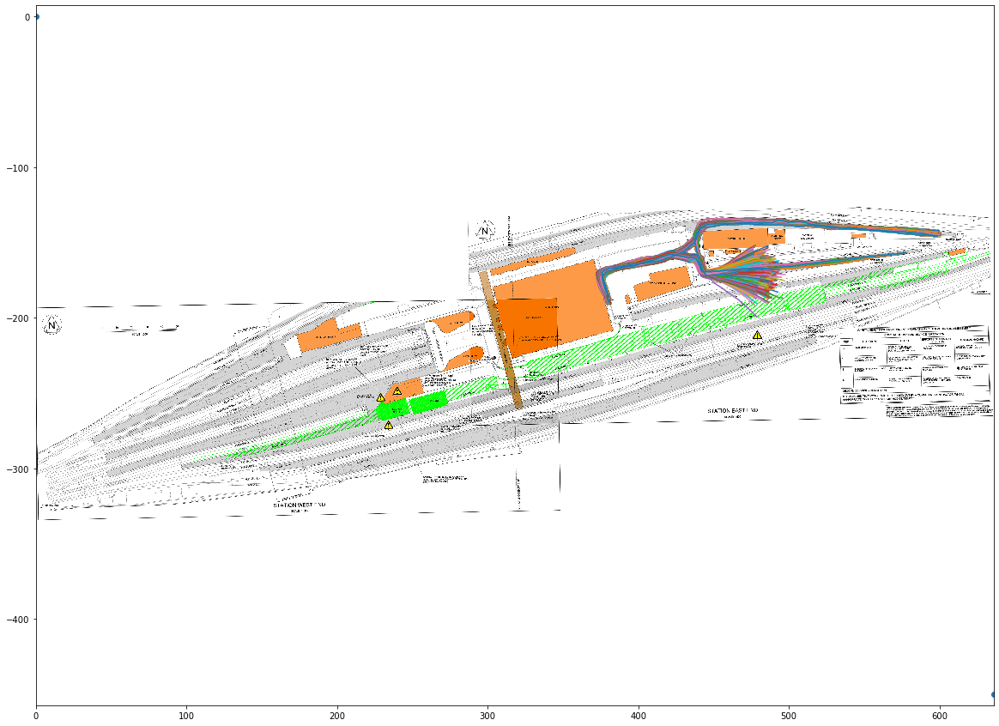

Resampling
Fixing location 529.3843888991139 -162.10353790118162 634.9269


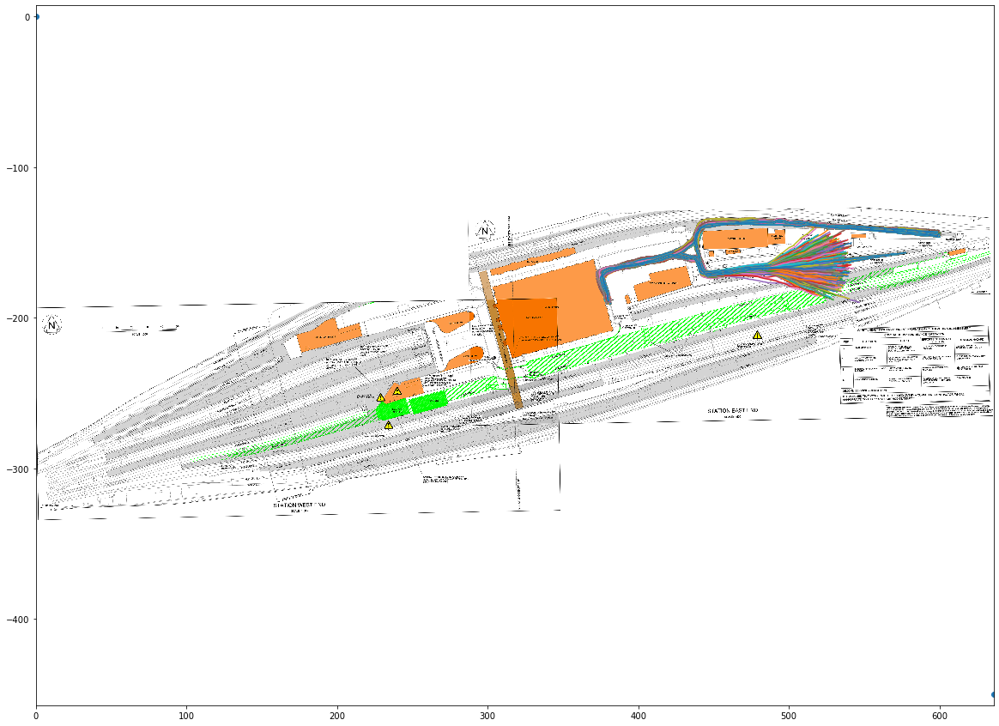

Resampling
Fixing location 577.6500923548632 -156.7193160017355 674.1306


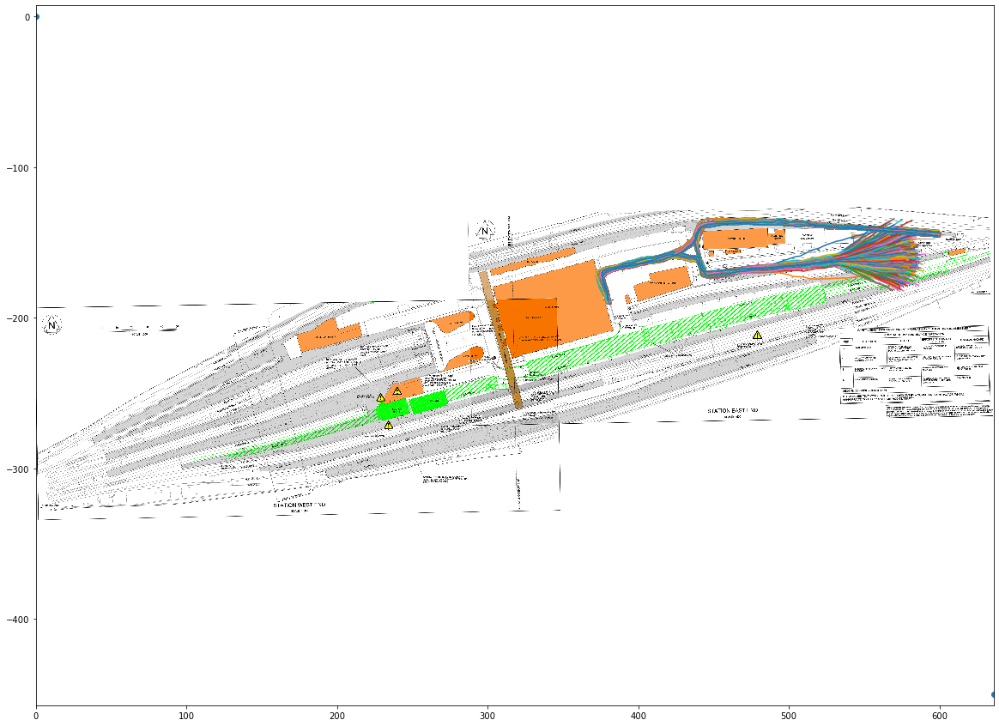

Resampling


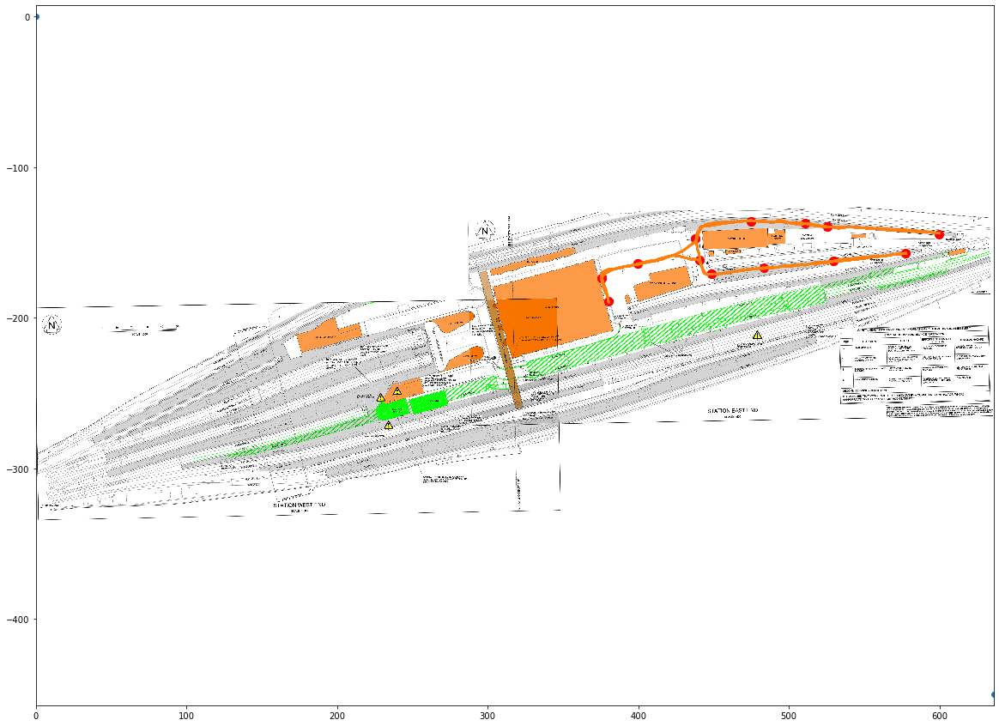

Fixing location 588.6108297930214 -160.94977606558604 1.8178


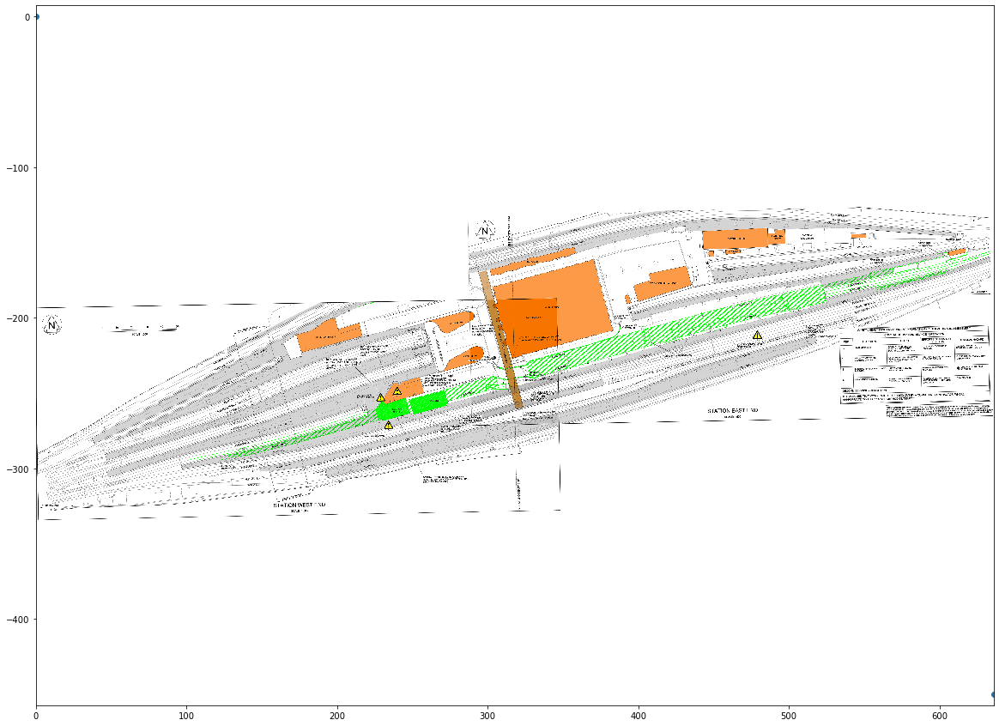

Fixing location 516.5007150682964 -175.1795053712651 69.2955


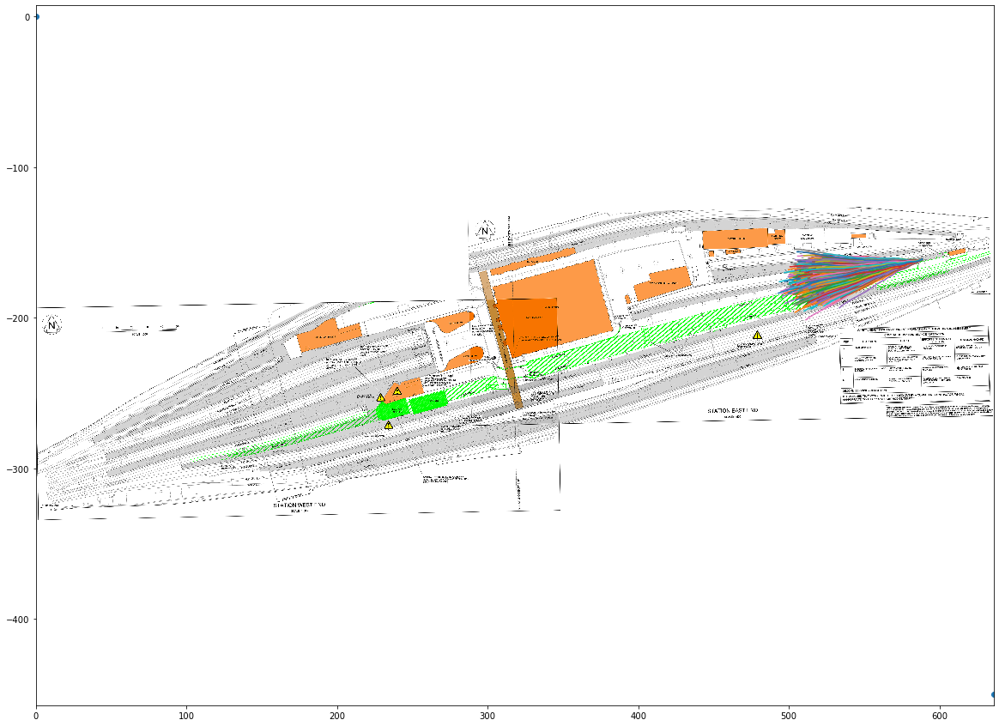

Resampling
Fixing location 397.0863650841519 -198.25474208317704 164.1207


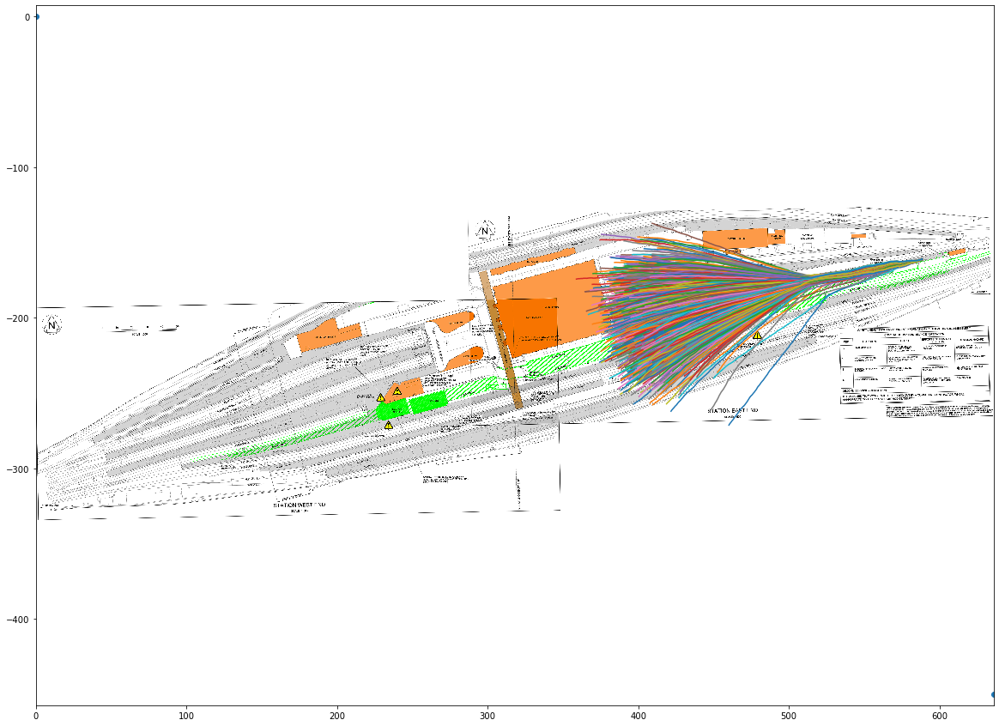

Resampling
Fixing location 347.859193432073 -221.1376851558231 211.4982


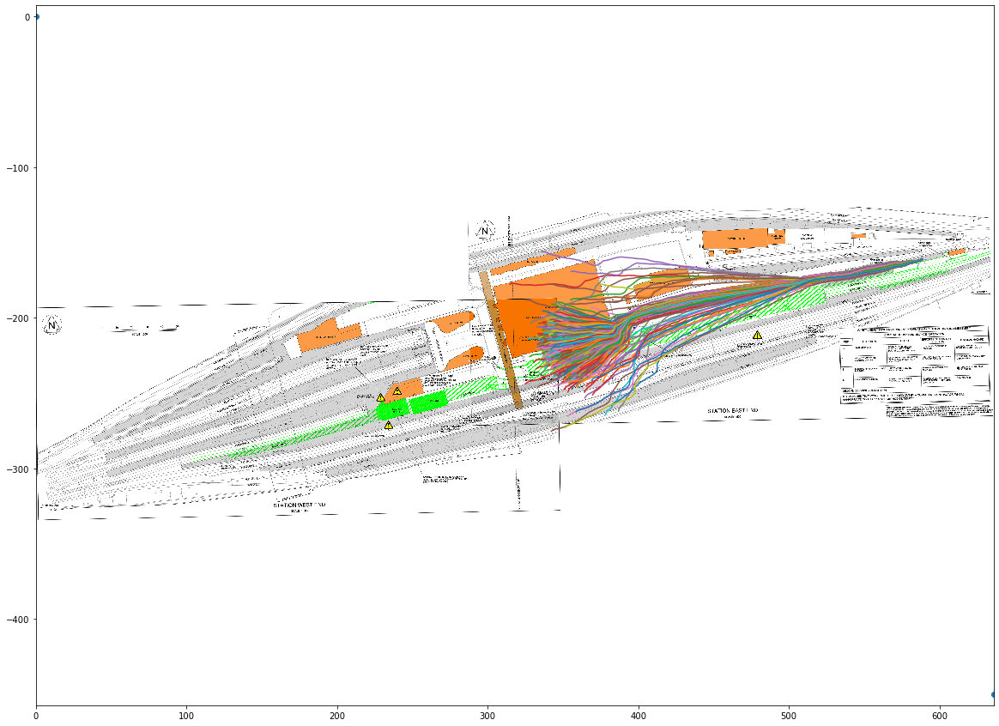

Resampling
Fixing location 336.3215750761171 -224.21438338407805 221.4002


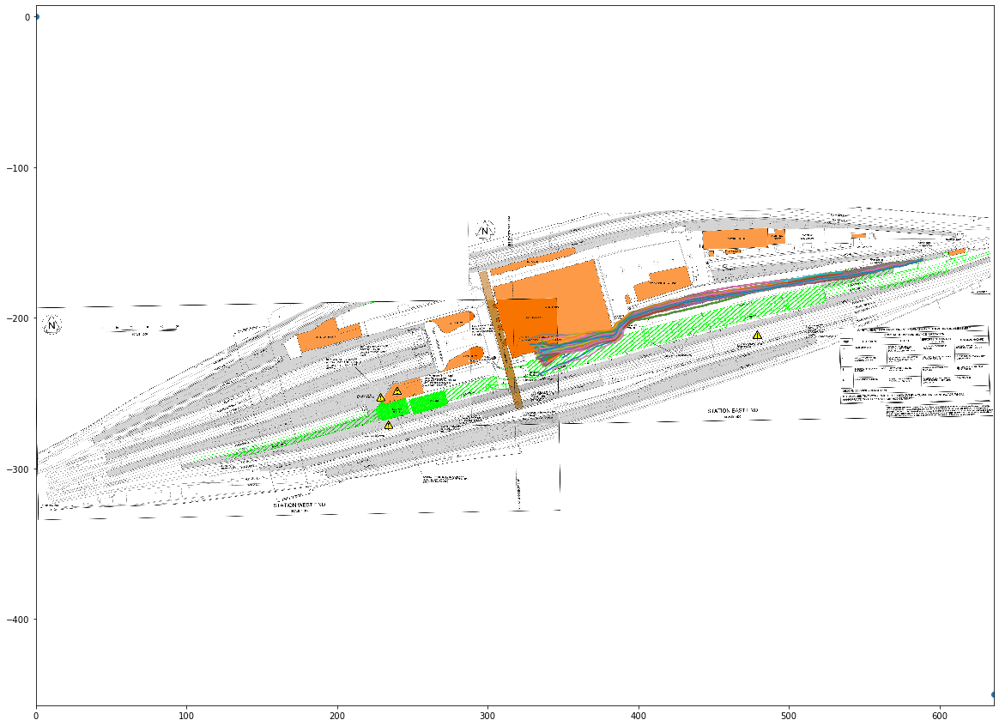

Resampling
Fixing location 315.55386203539626 -232.0984225939813 240.1204


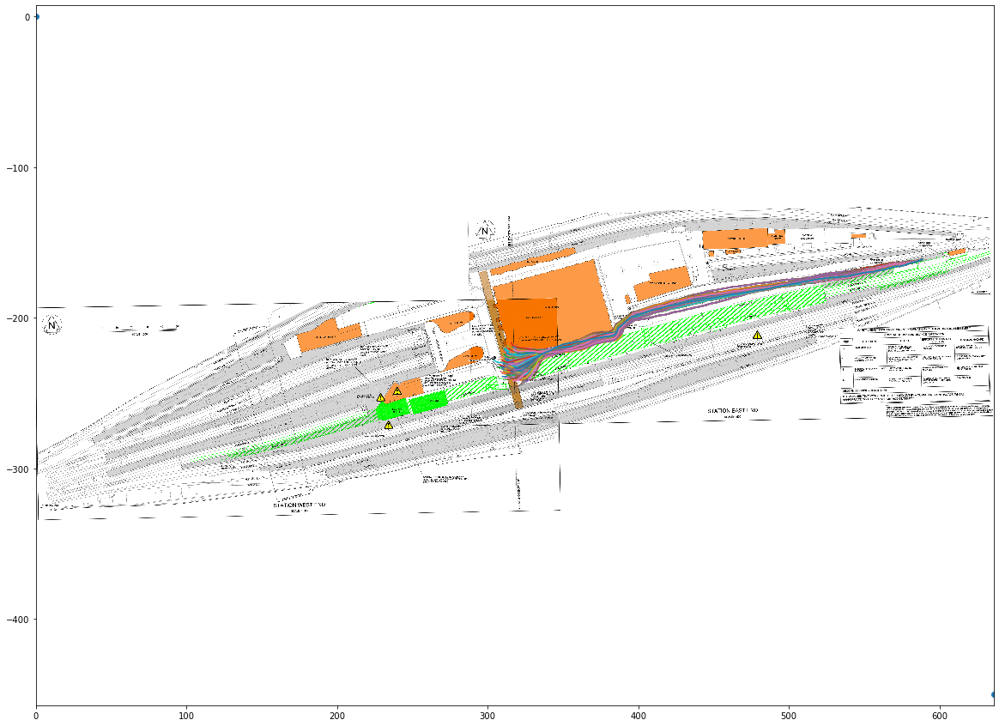

Resampling
Fixing location 312.09257652860947 -227.4833752515989 244.7477


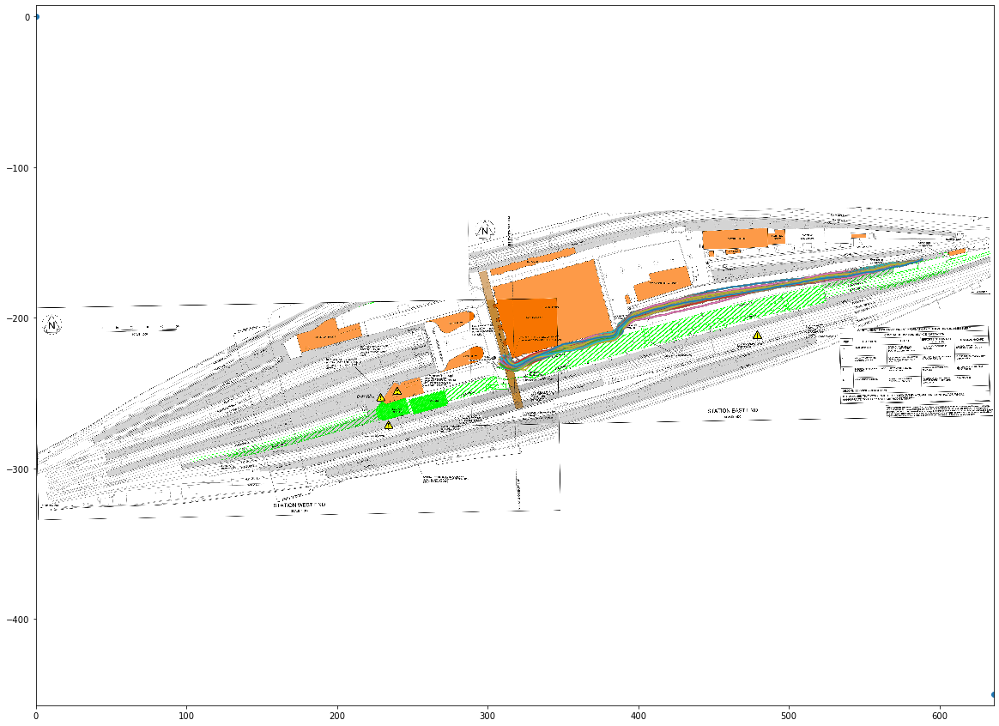

Resampling
Fixing location 299.4011963370579 -180.5637272707112 287.6133


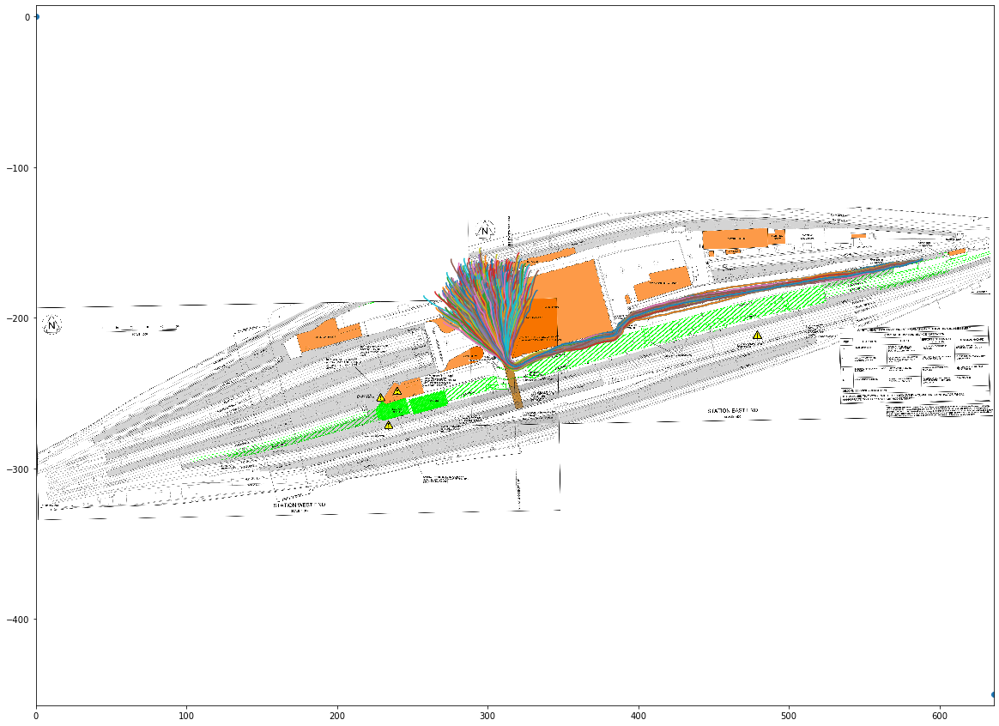

Resampling
Fixing location 309.2081719396205 -174.02574353566948 297.1791


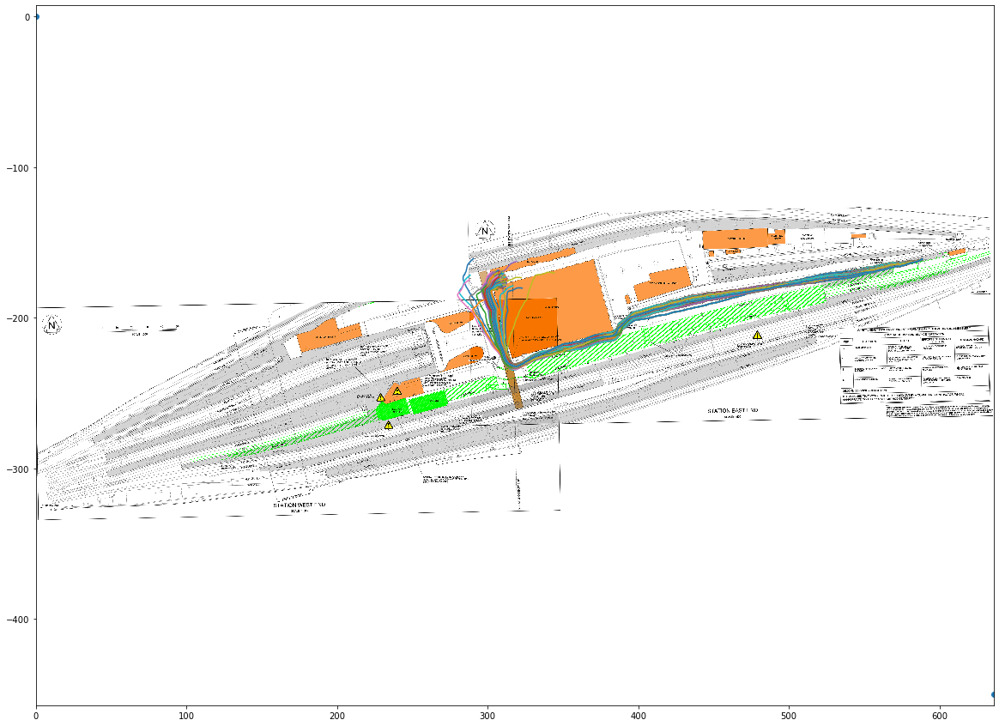

Resampling
Fixing location 341.7057969755632 -165.18023612943657 324.4261


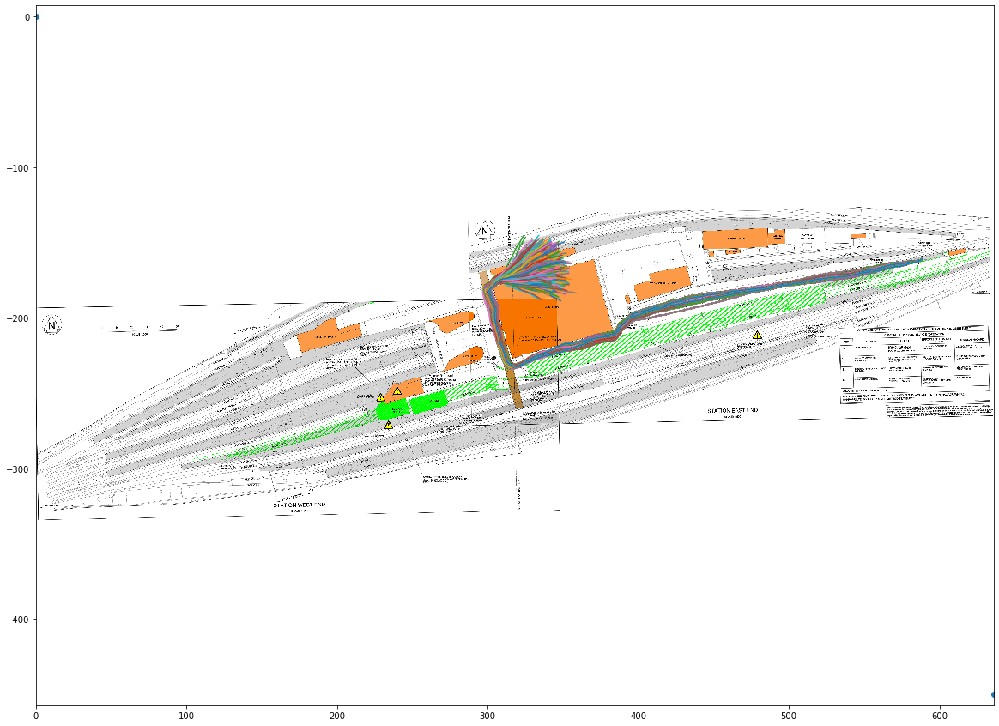

Resampling
Fixing location 399.778476033875 -164.02647429384098 376.175


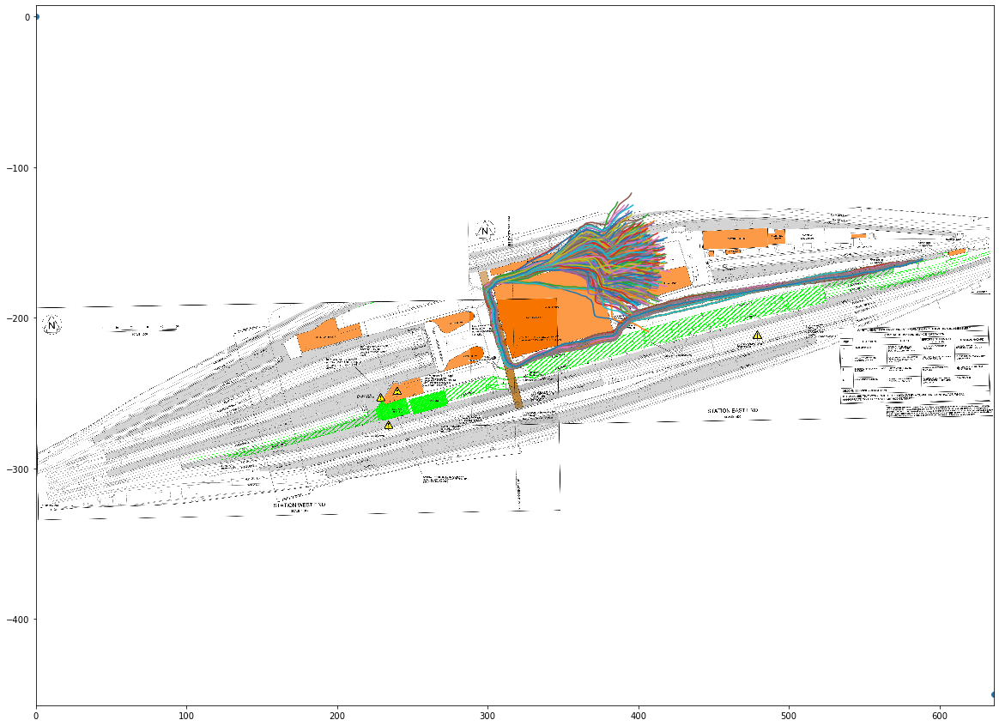

Resampling
Fixing location 440.73702119751874 -161.3343633441179 407.6529


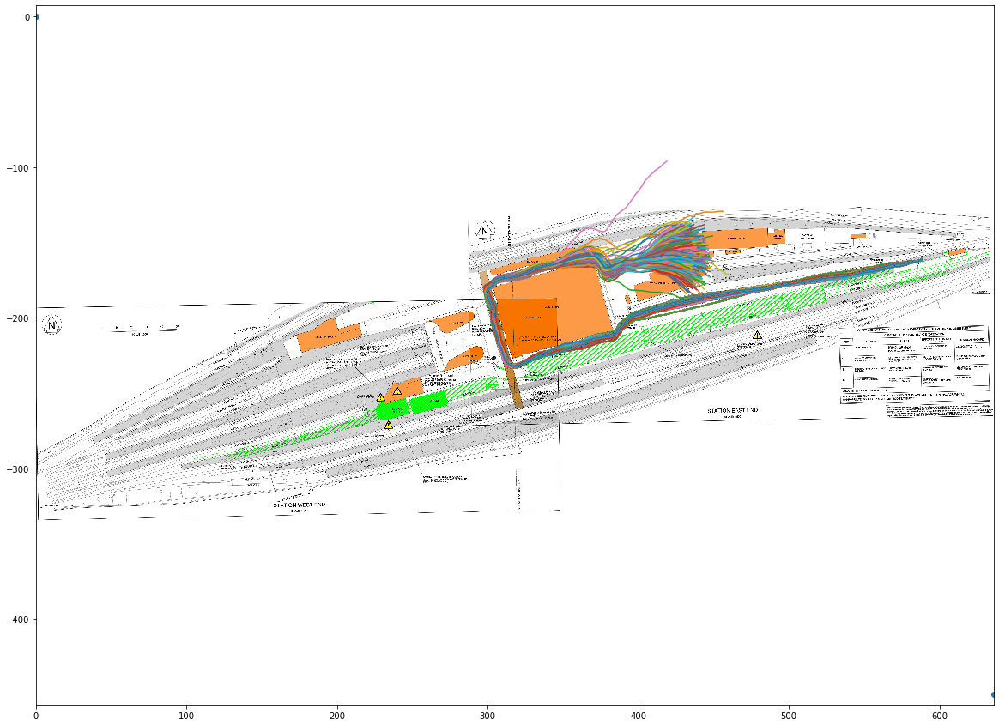

Resampling
Fixing location 448.813354046688 -170.56445802888268 420.5713


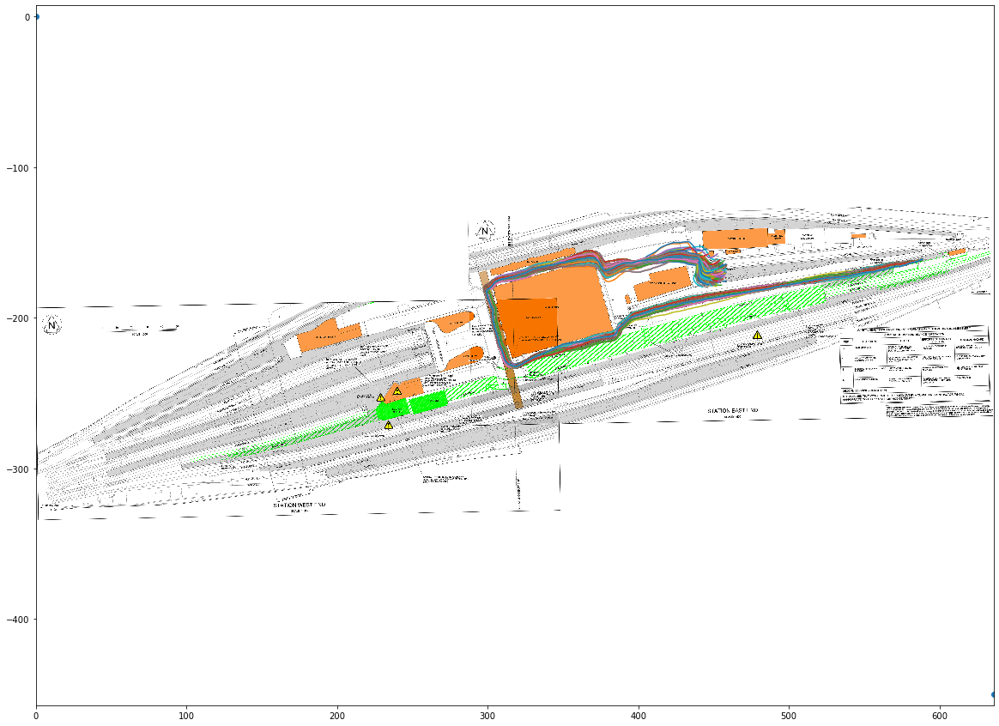

Resampling
Fixing location 483.6185027538219 -166.91087888282996 448.7819


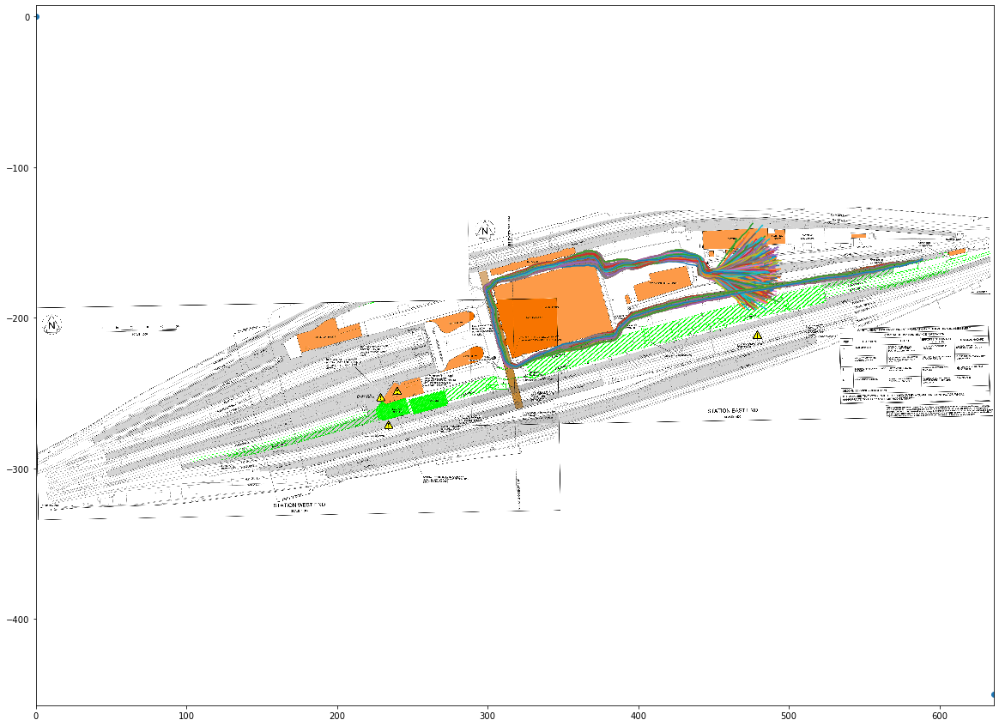

Resampling
Fixing location 529.3843888991139 -162.10353790118162 484.9424


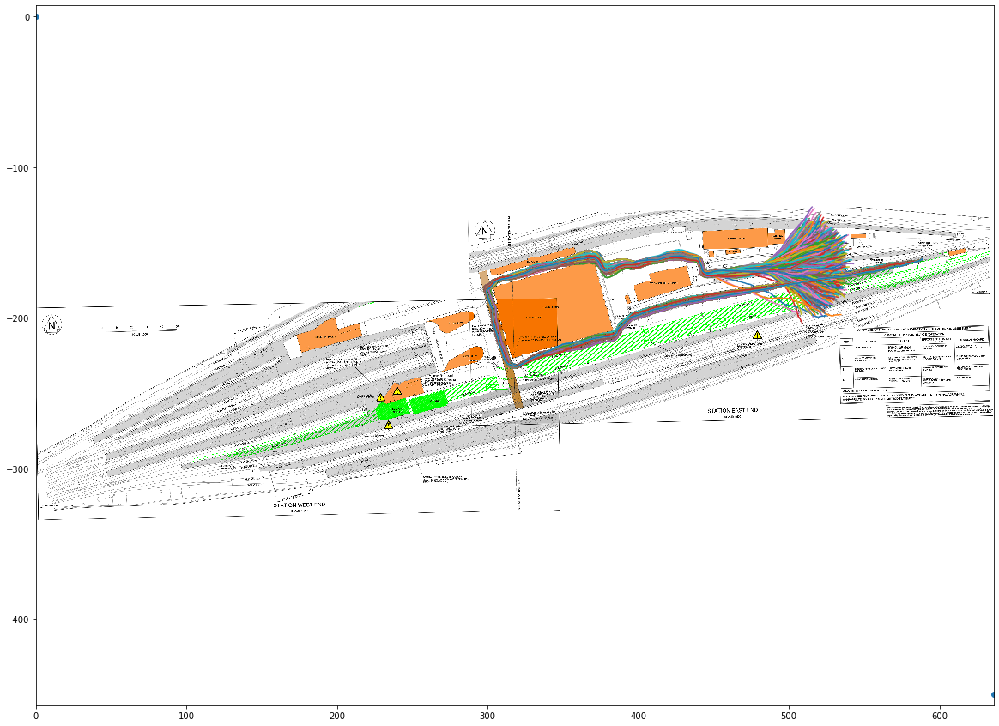

Resampling
Fixing location 577.6500923548632 -156.7193160017355 521.2182


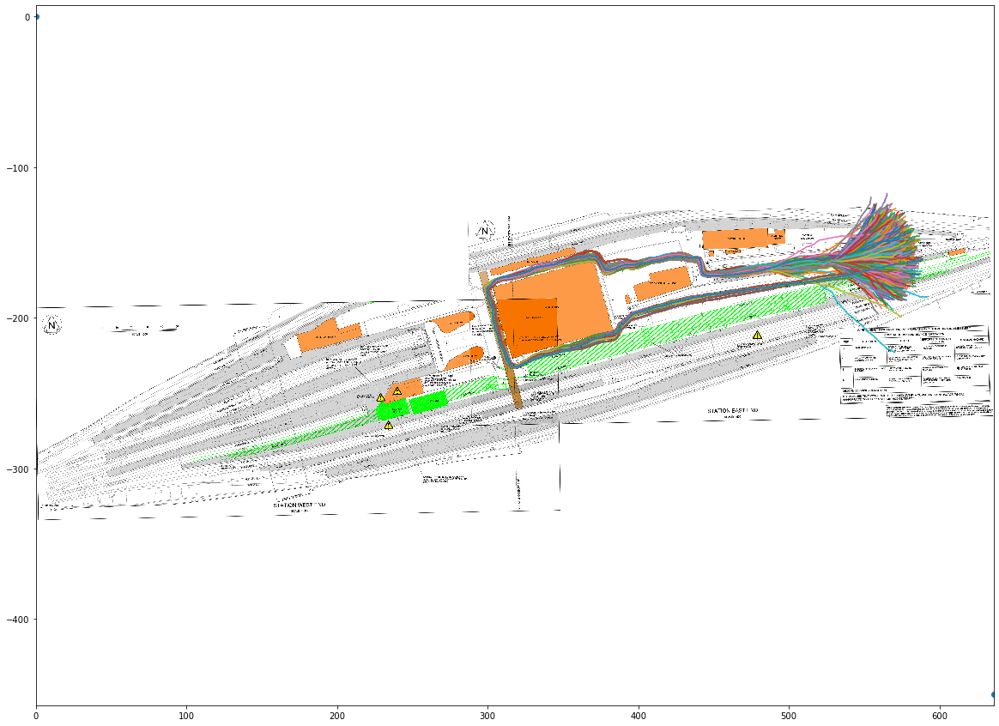

Resampling
Fixing location 529.3843888991139 -162.10353790118162 561.8555


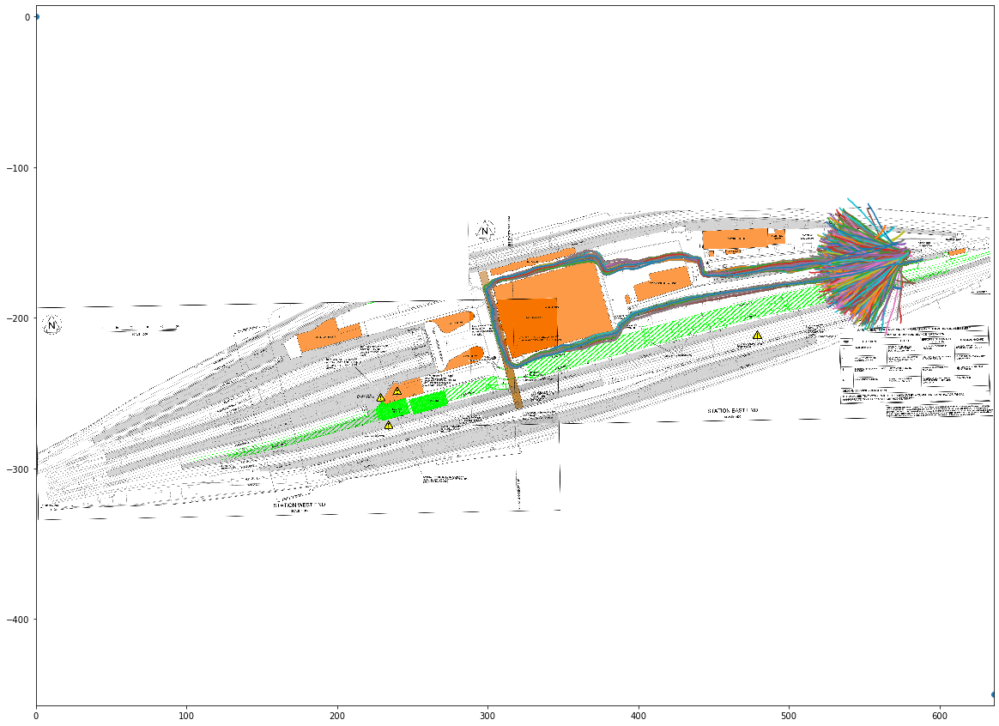

Resampling
Fixing location 483.6185027538219 -166.91087888282996 598.9896


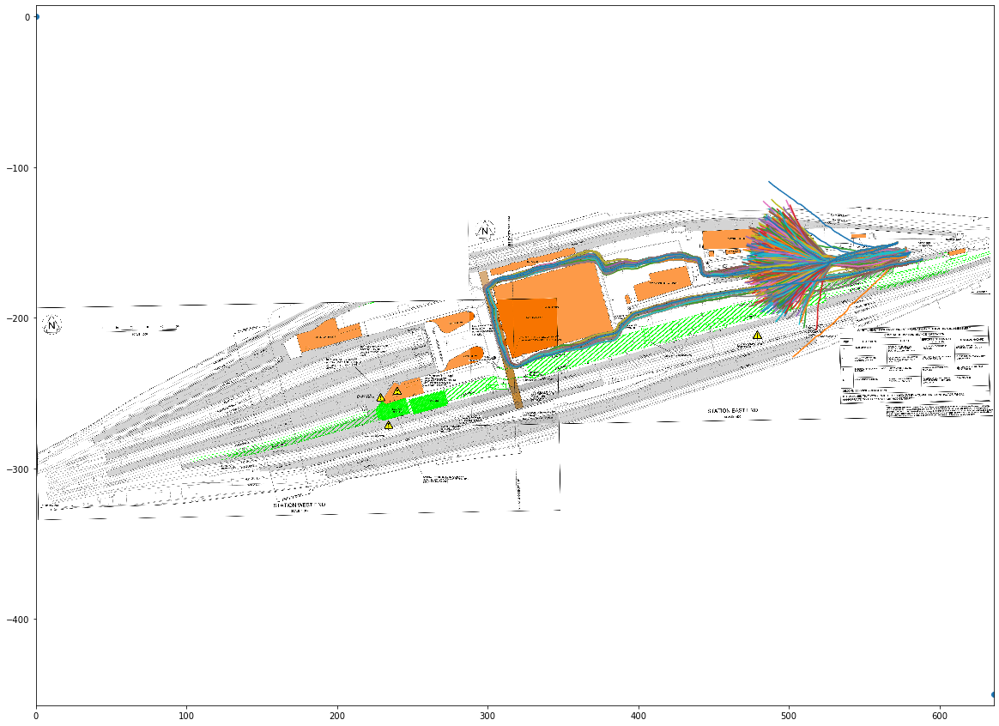

Resampling
Fixing location 448.813354046688 -170.56445802888268 627.4763


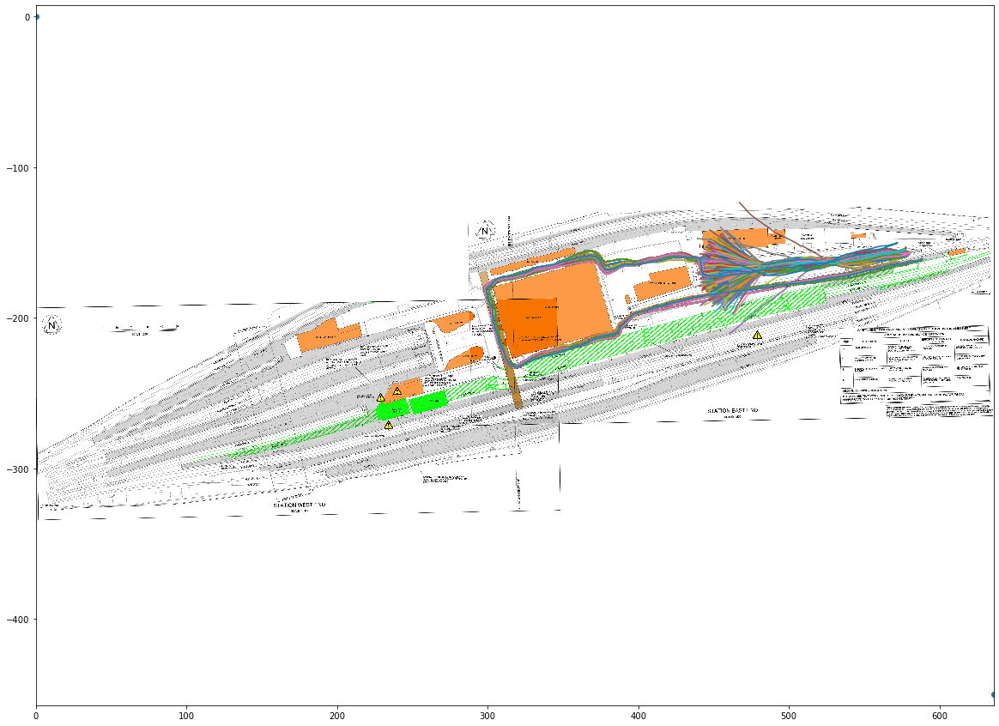

Resampling
Fixing location 438.8140848048594 -177.29473540319034 637.4486


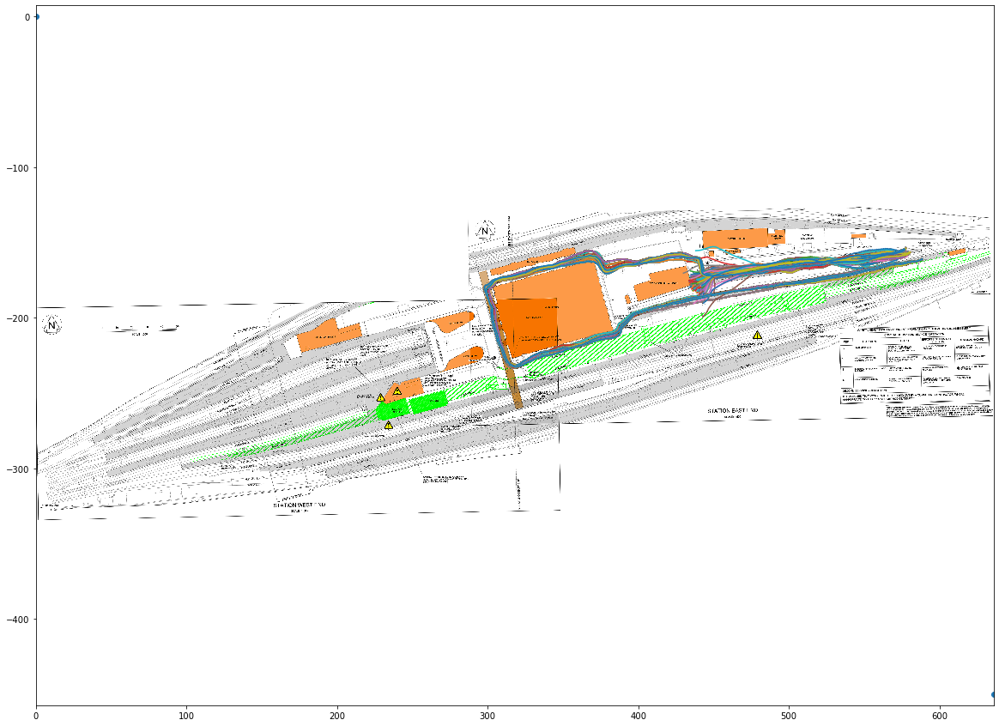

Resampling
Fixing location 392.2790241025036 -192.1013456266672 678.6278


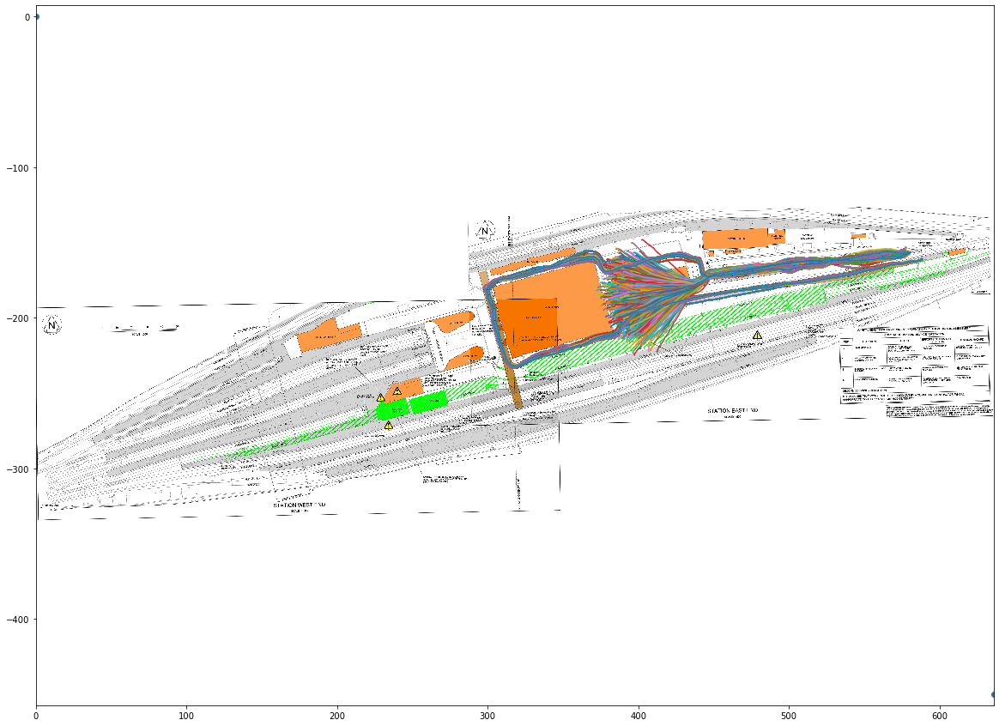

Resampling
Fixing location 397.0863650841519 -198.25474208317704 687.5212


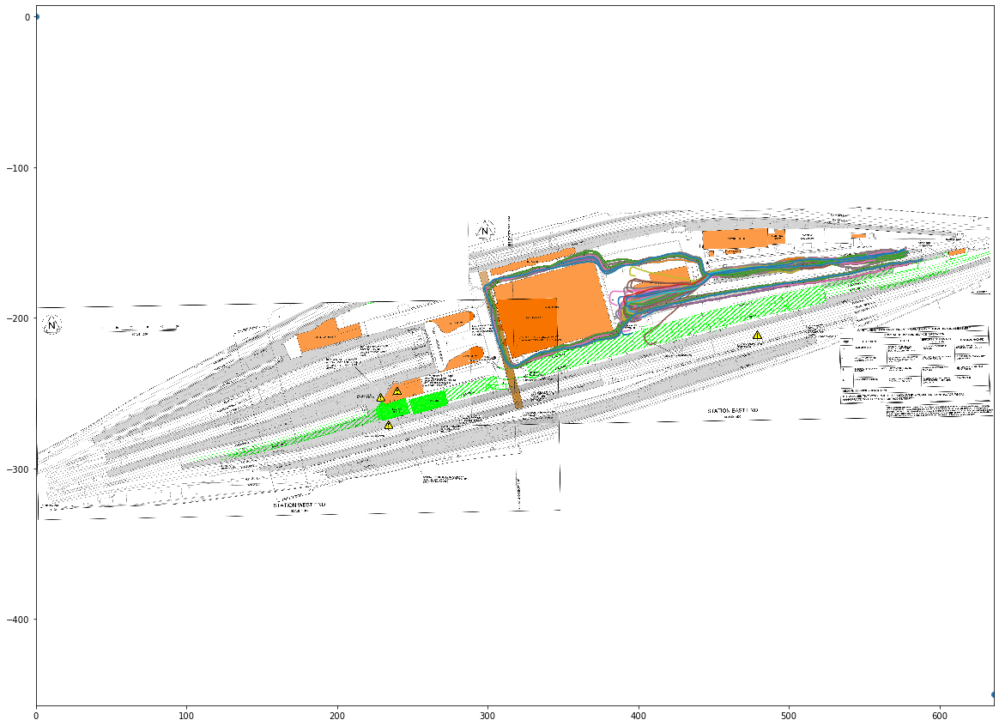

Resampling
Fixing location 516.5007150682964 -175.1795053712651 786.3363


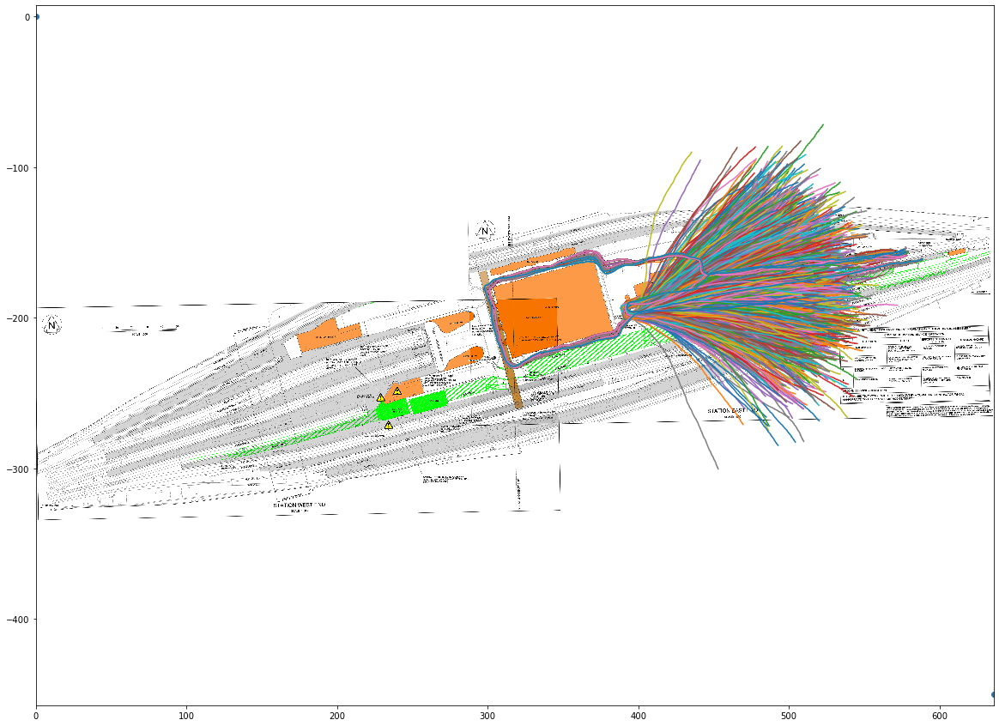

Resampling
Fixing location 588.6108297930214 -160.94977606558604 848.6949


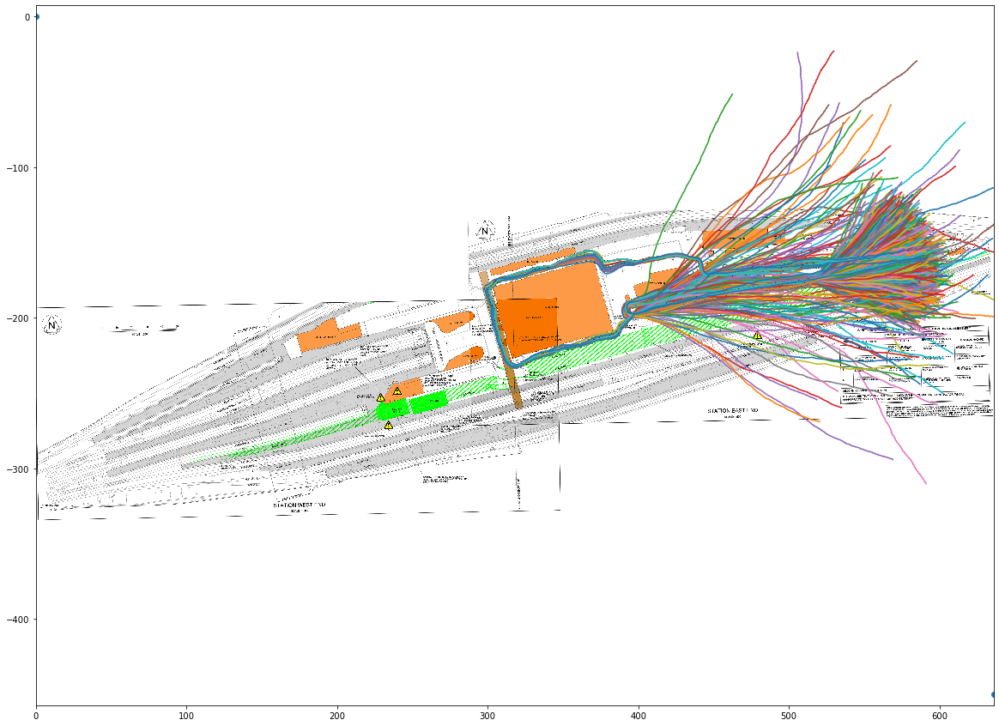

Resampling


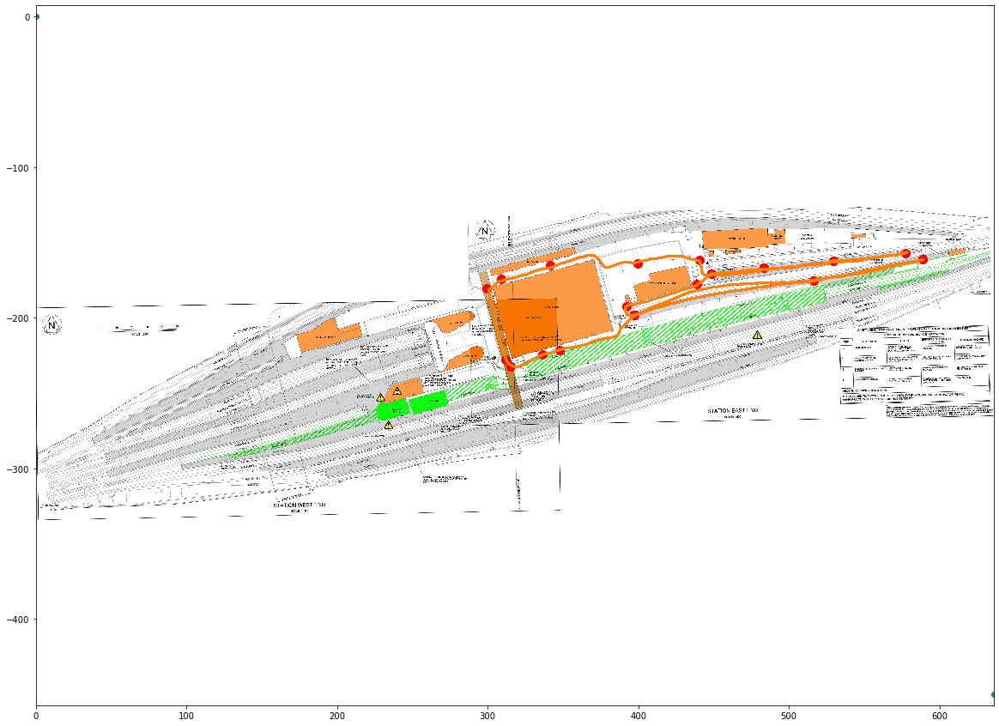

Fixing location 372.28048561884657 -149.2198640703641 1.2125


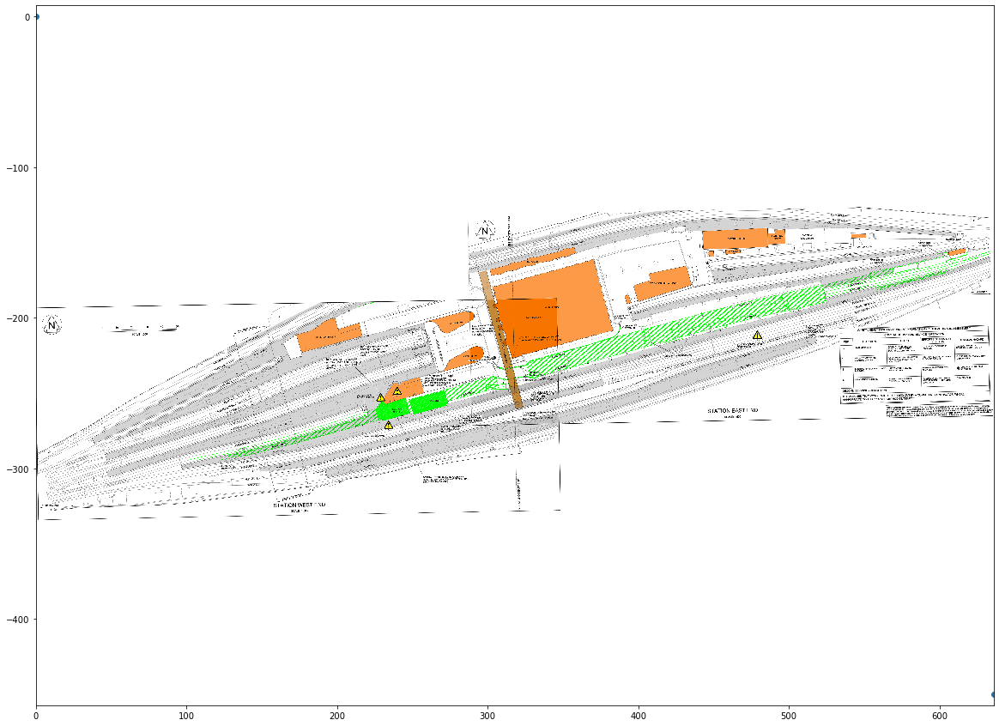

Fixing location 295.5553235517392 -166.71858524356404 66.2763


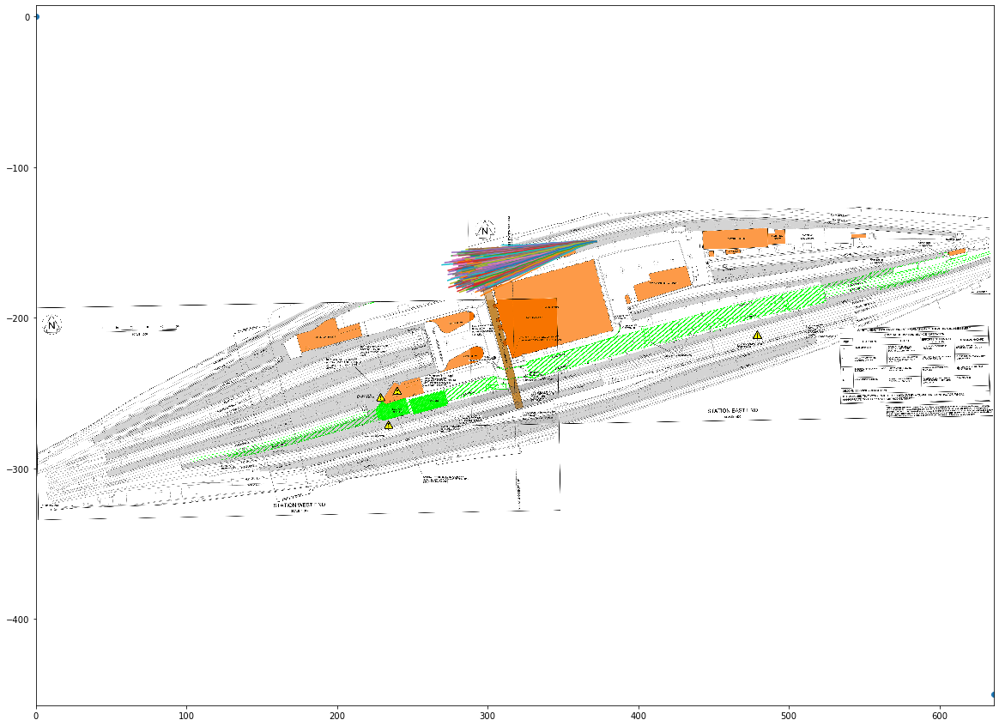

Resampling
Fixing location 163.44959337604317 -215.3688759778451 180.5144


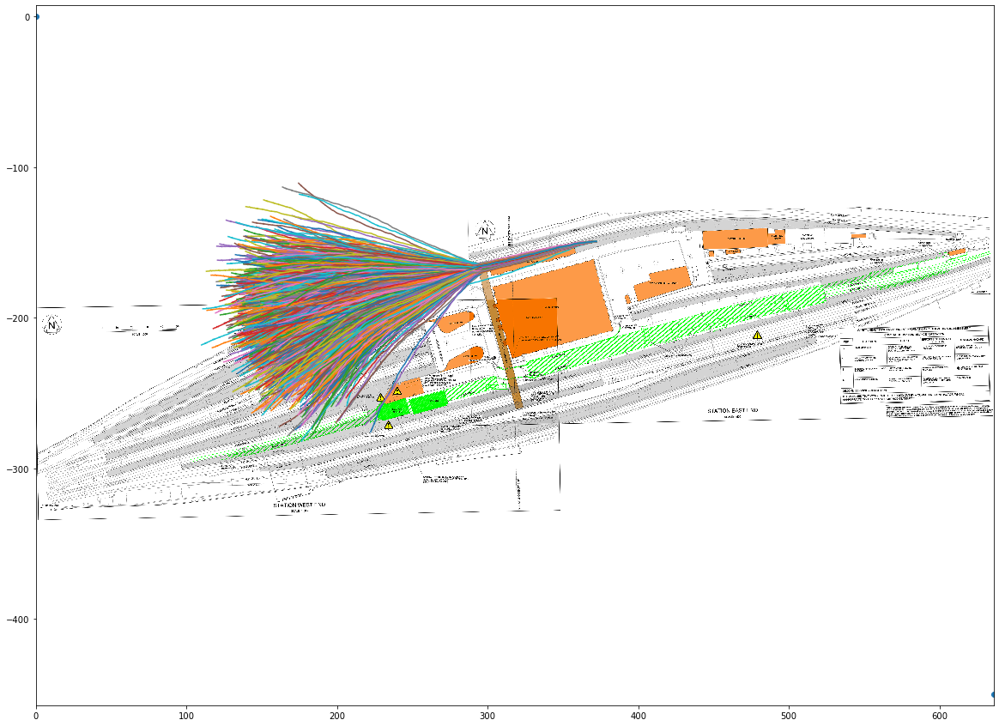

Resampling
Fixing location 133.4517856505576 -233.8290653473747 206.813


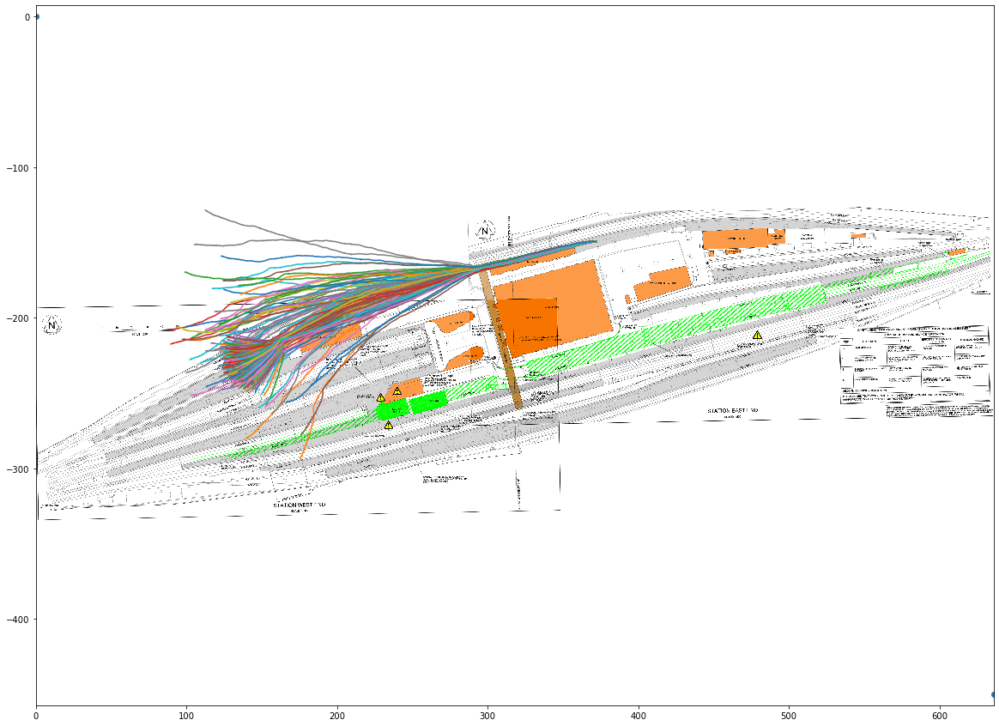

Resampling
Fixing location 68.07194830014033 -266.5189840225833 261.4277


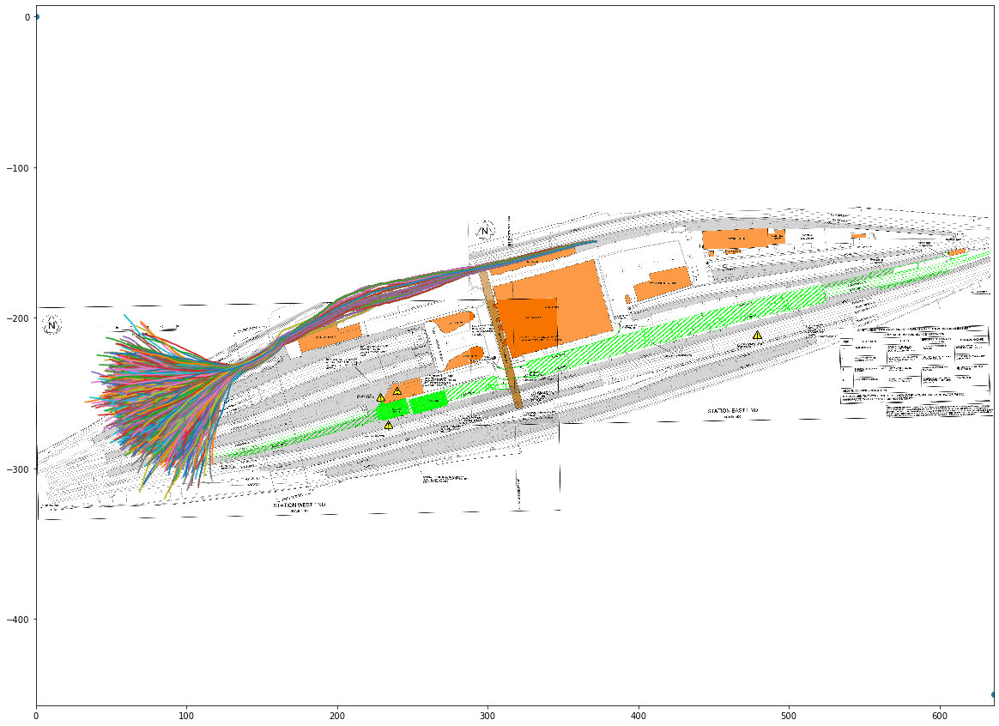

Resampling
Fixing location 46.91964798088769 -276.9028405429437 278.0801


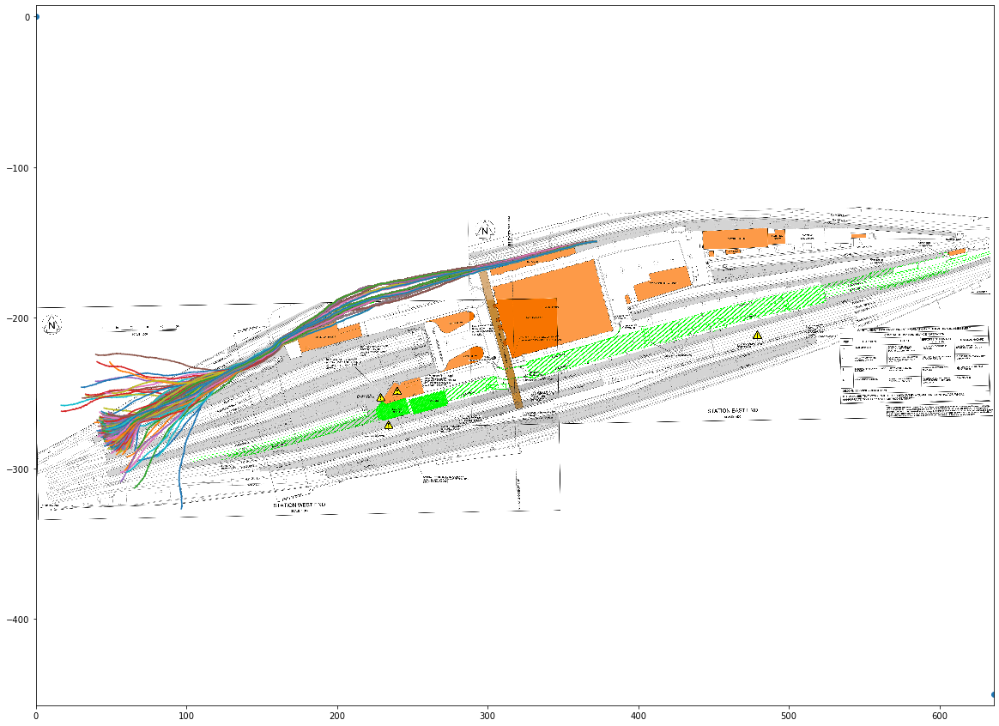

Resampling
Fixing location 68.07194830014033 -266.5189840225833 297.1264


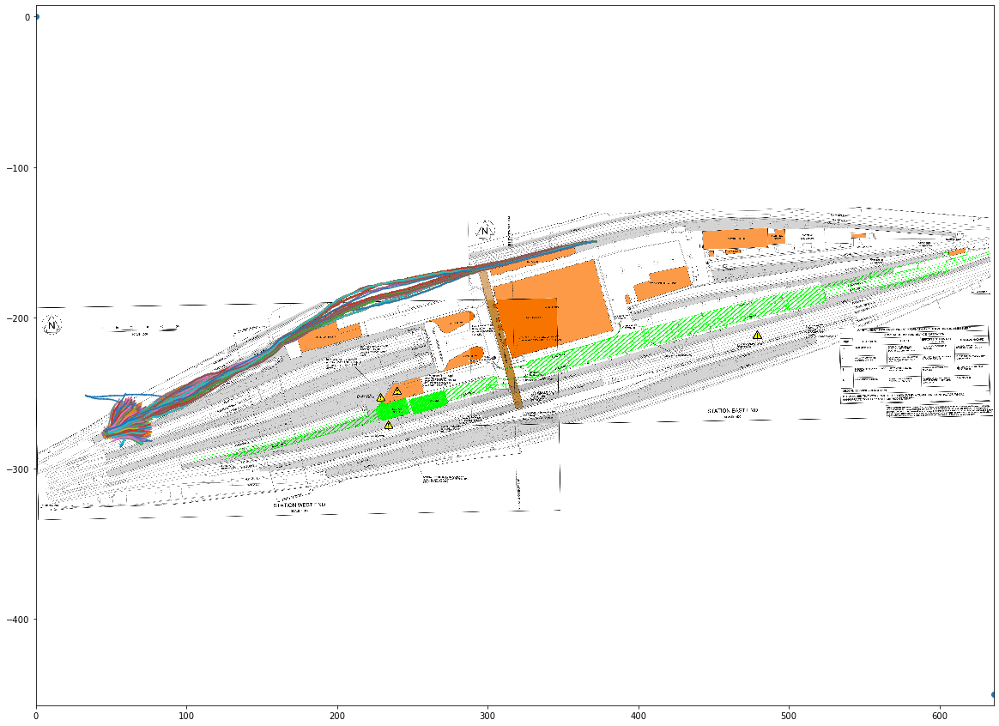

Resampling
Fixing location 133.4517856505576 -233.8290653473747 352.5692


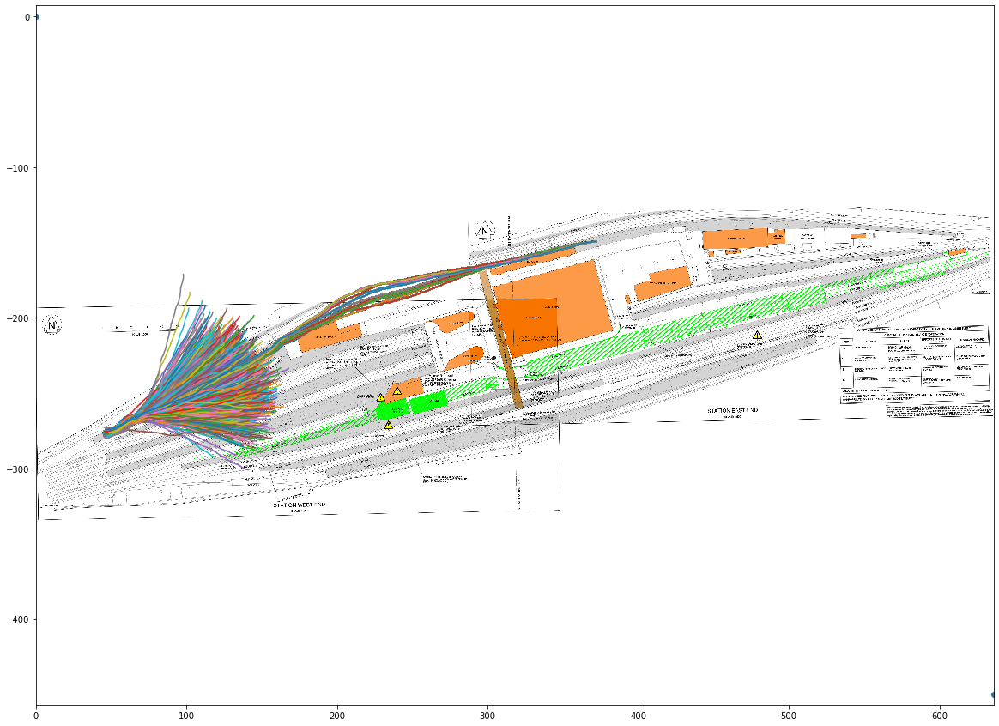

Resampling
Fixing location 163.44959337604317 -215.3688759778451 378.7574


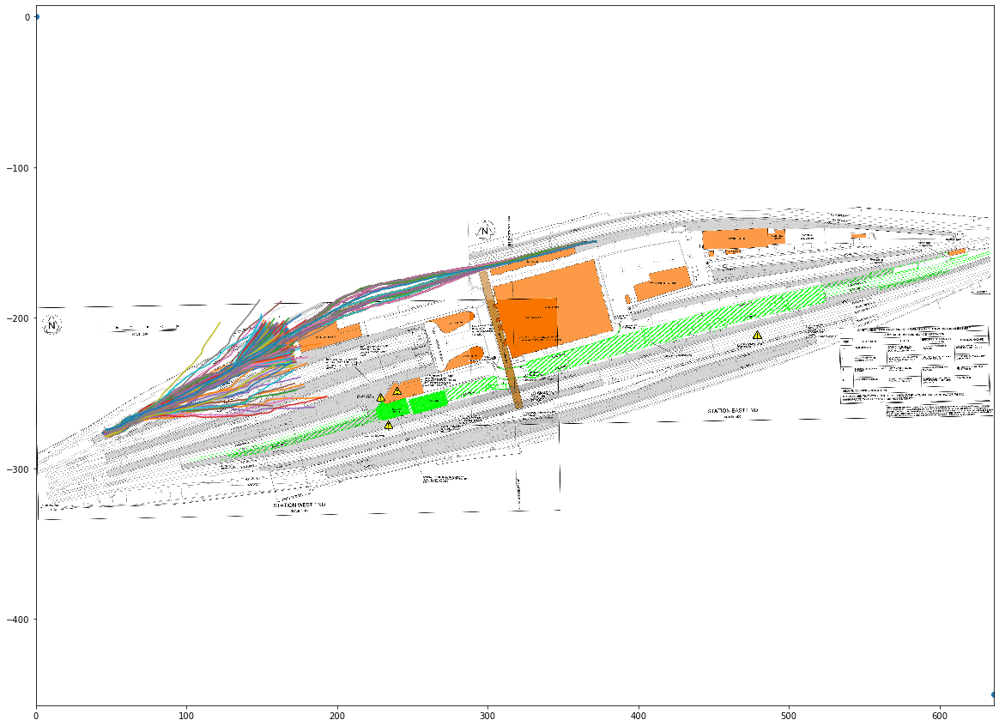

Resampling
Fixing location 295.5553235517392 -166.71858524356404 487.8863


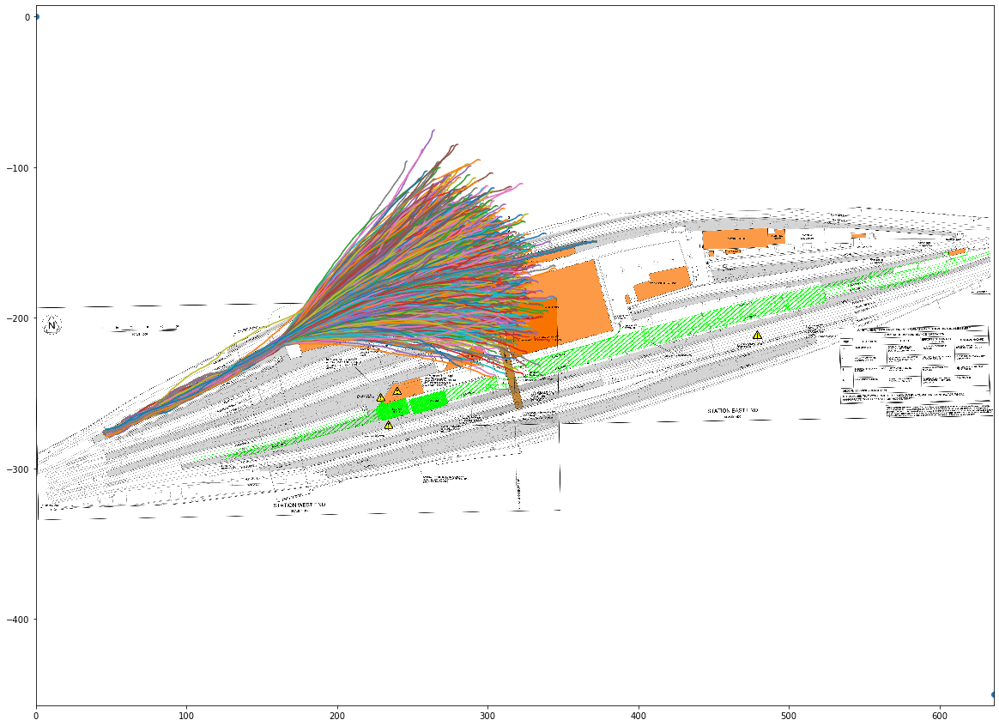

Resampling
Fixing location 299.4011963370579 -180.5637272707112 500.7445


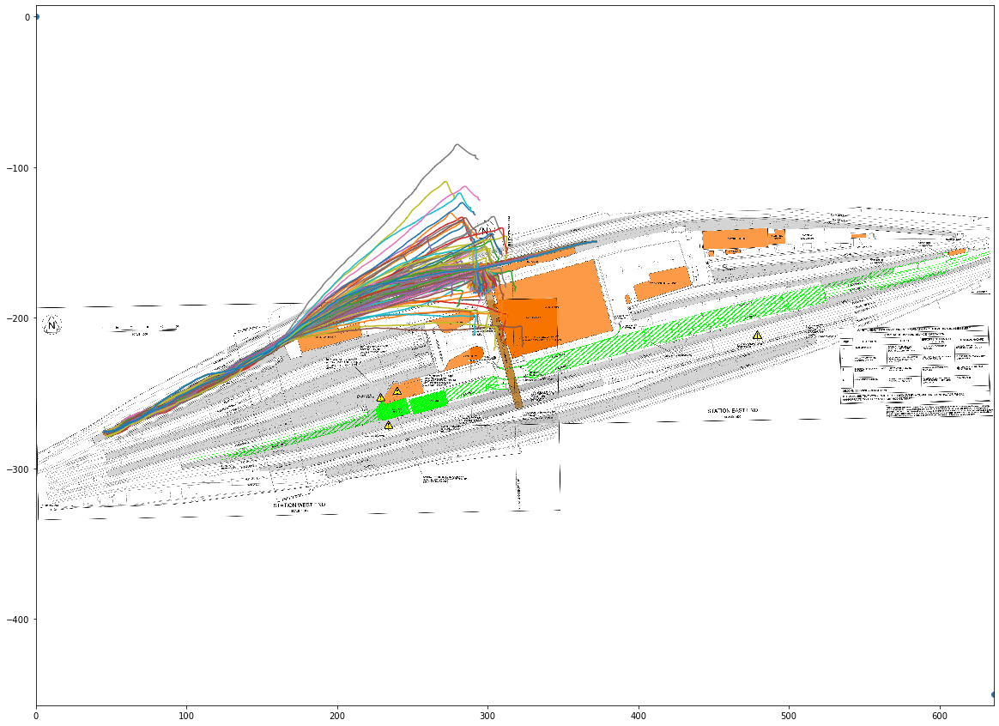

Resampling
Fixing location 312.09257652860947 -227.4833752515989 540.3429


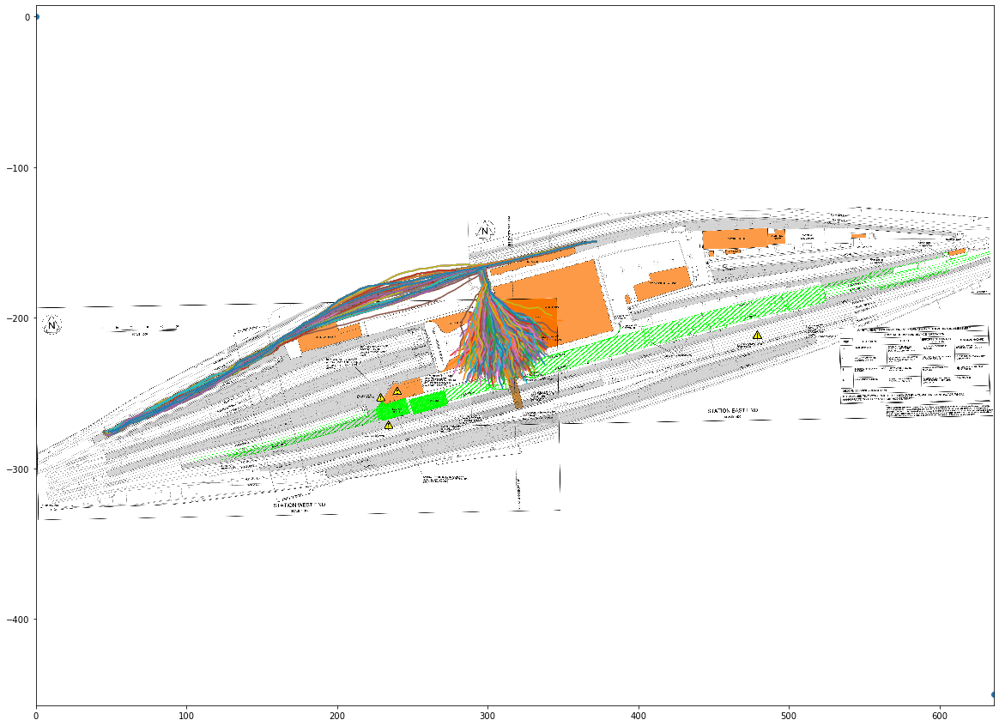

Resampling
Fixing location 315.55386203539626 -232.0984225939813 544.6842


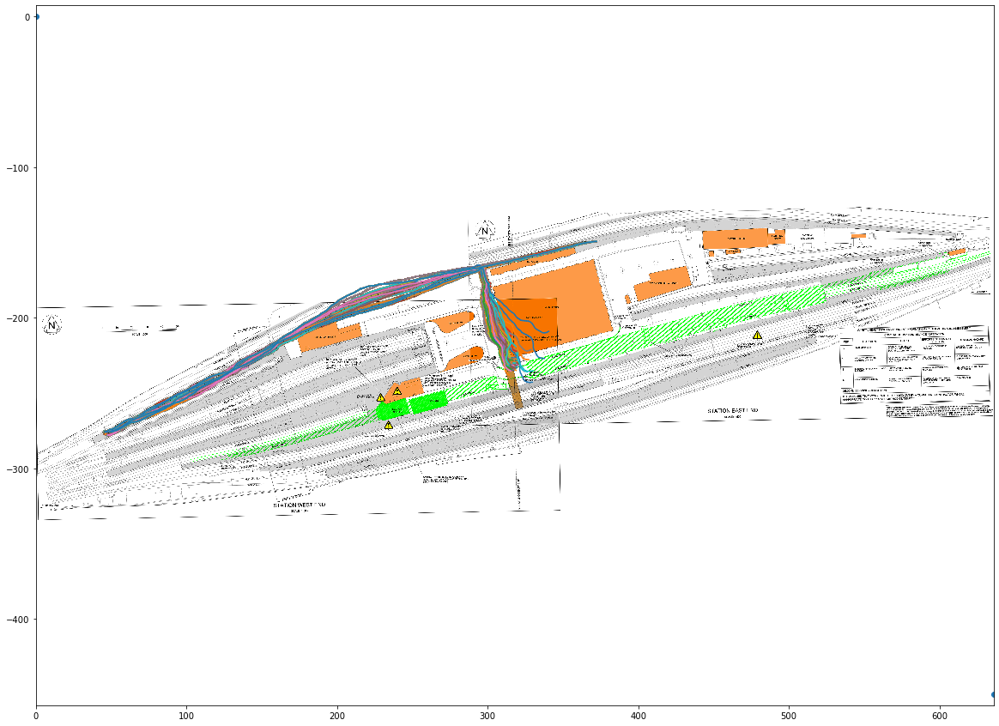

Resampling
Fixing location 336.3215750761171 -224.21438338407805 561.5072


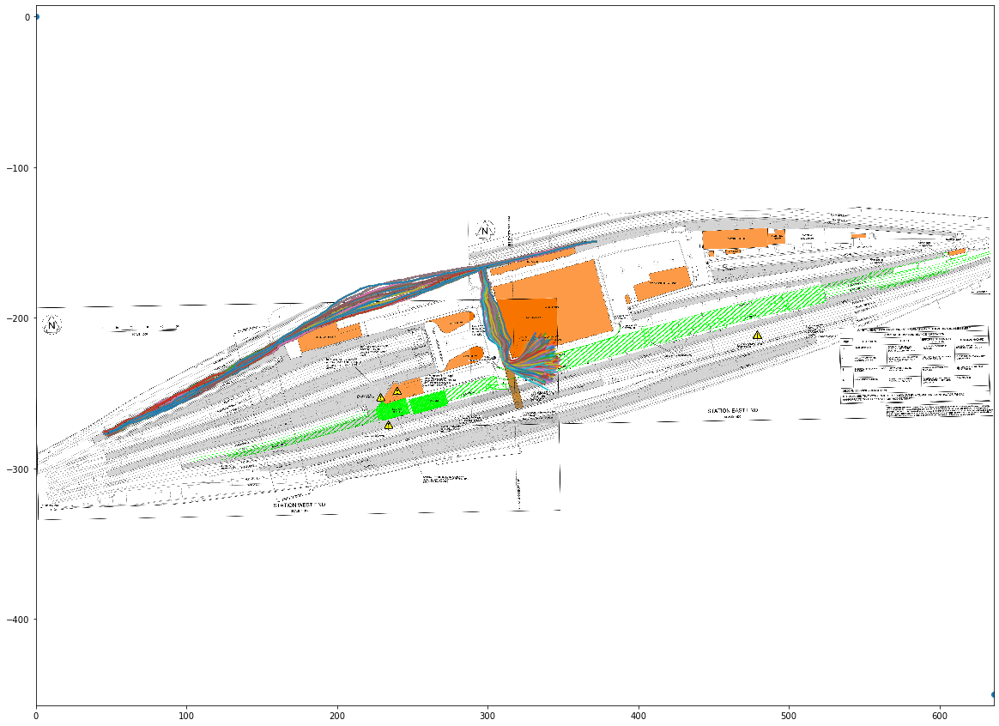

Resampling
Fixing location 347.859193432073 -221.1376851558231 570.1546


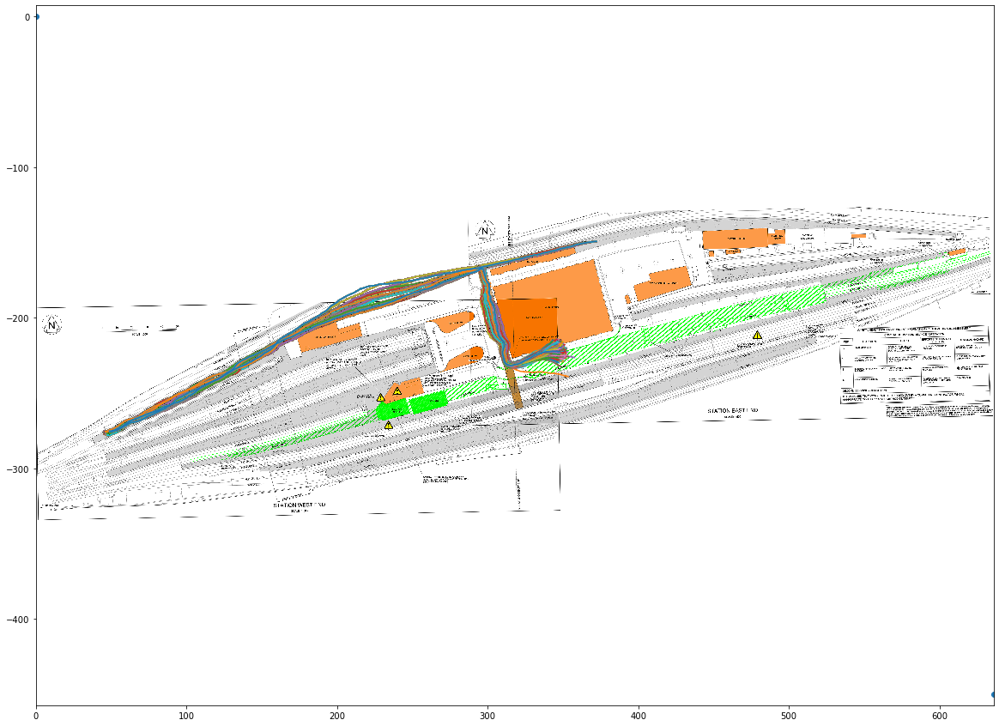

Resampling
Fixing location 383.6258103355366 -208.44630496427152 599.5548


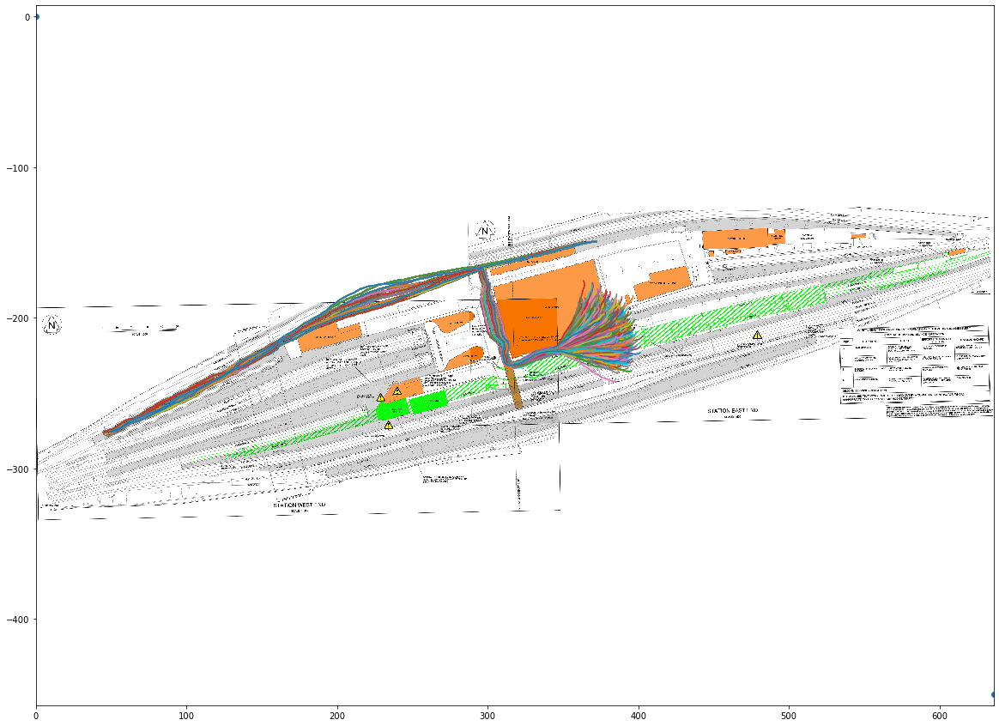

Resampling
Fixing location 397.0863650841519 -198.25474208317704 612.5937


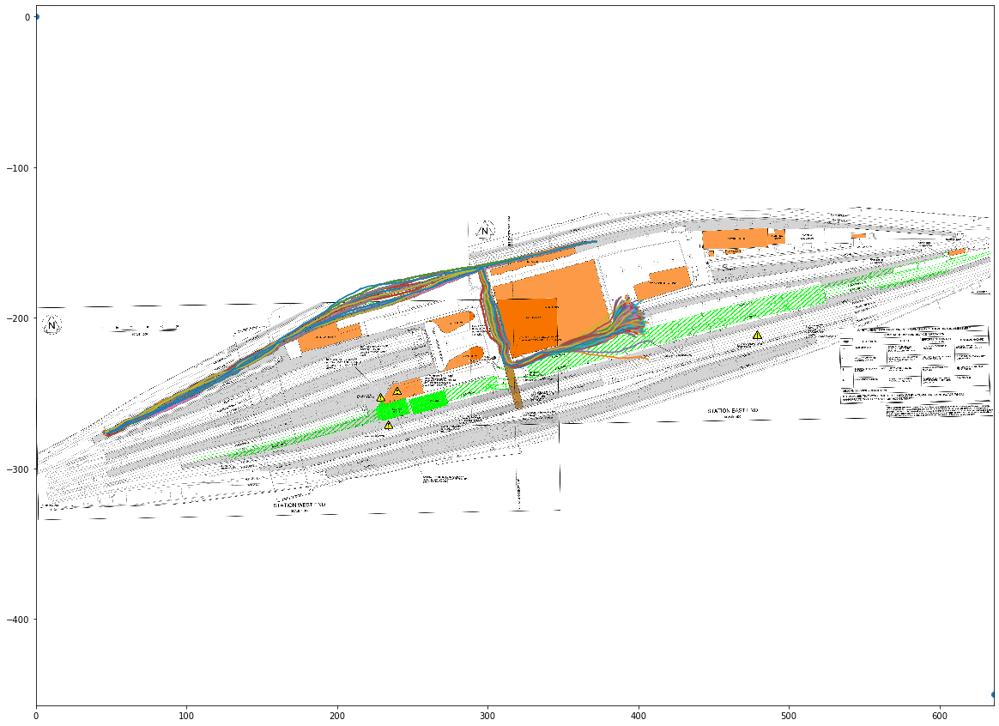

Resampling
Fixing location 516.5007150682964 -175.1795053712651 705.5721


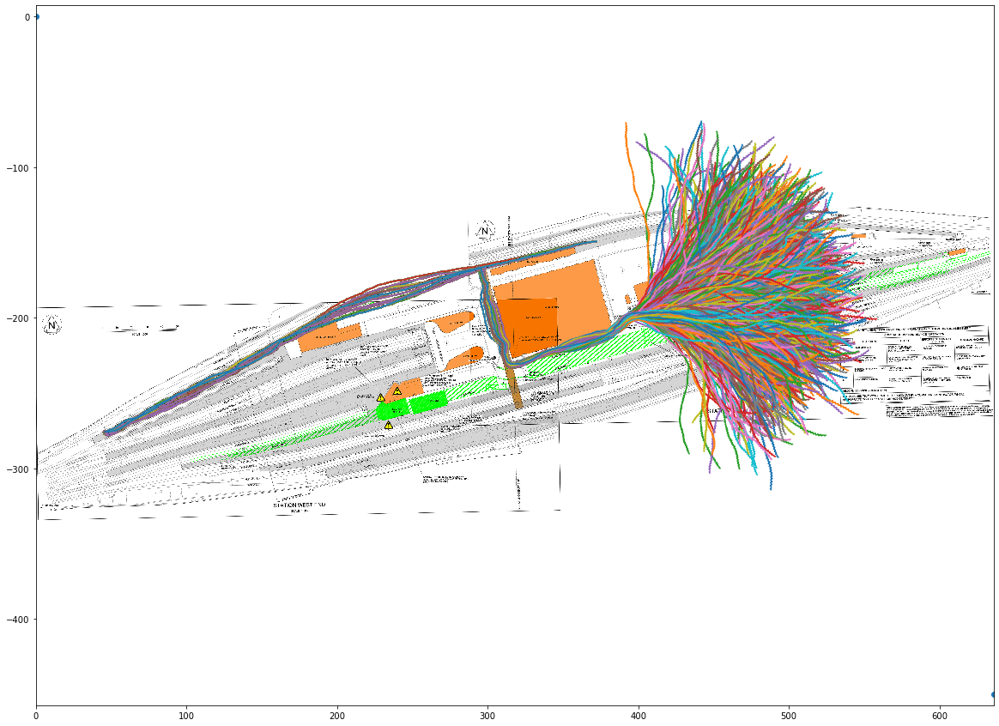

Resampling
Fixing location 588.6108297930214 -160.94977606558604 765.1755


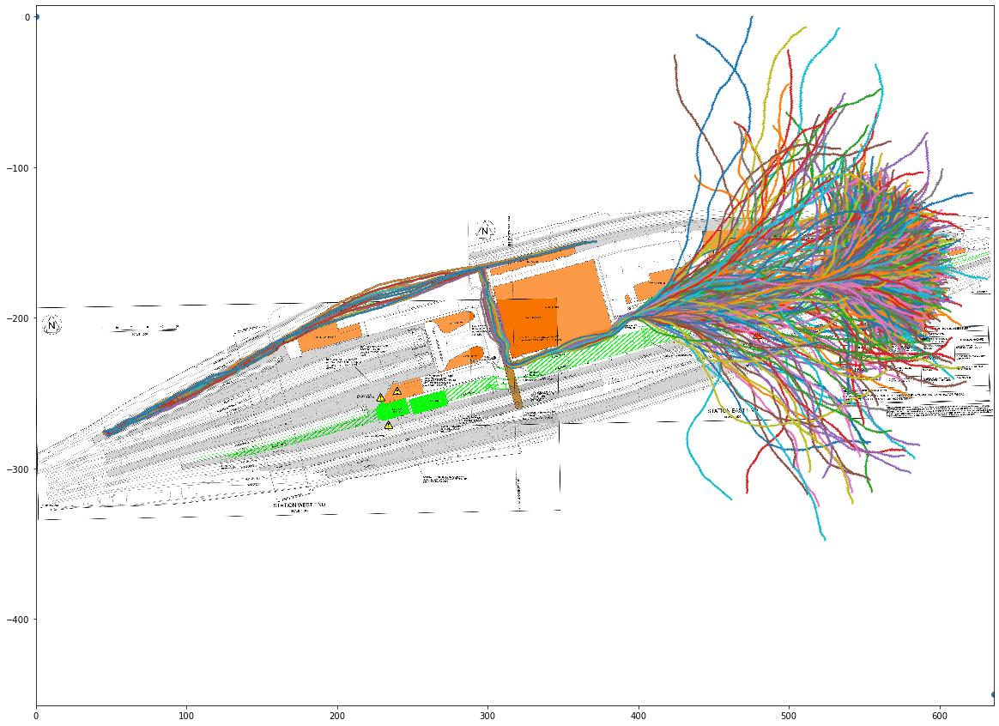

Resampling
Fixing location 516.5007150682964 -175.1795053712651 826.8416


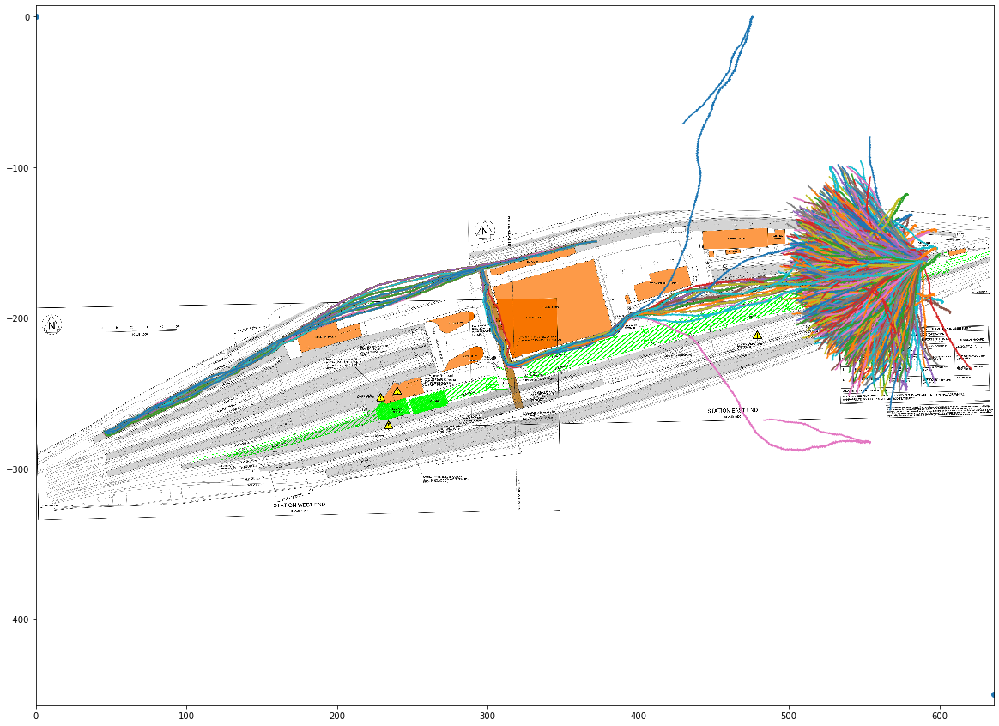

Resampling
Fixing location 397.0863650841519 -198.25474208317704 922.0885


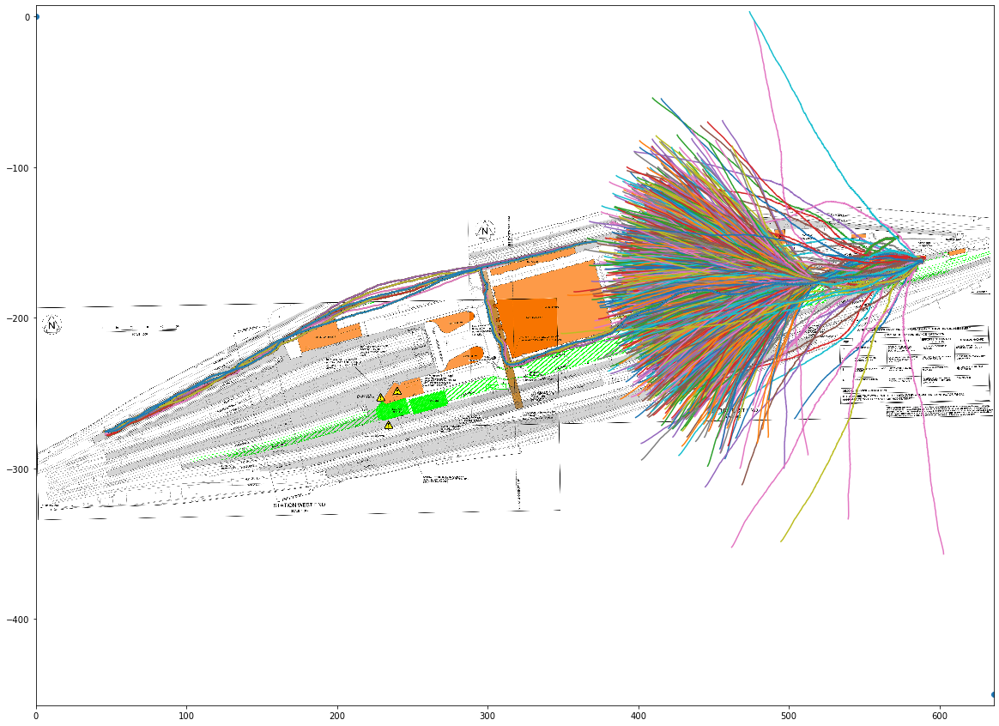

Resampling
Fixing location 379.9722311894839 -188.6400601198804 942.5602


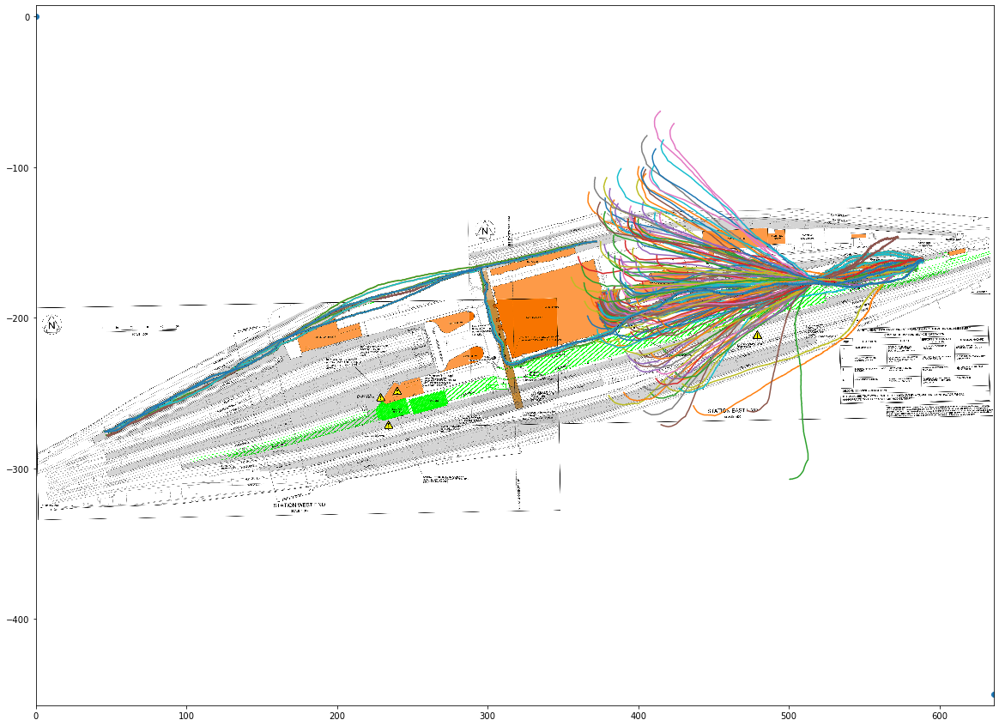

Resampling
Fixing location 375.5494774863674 -173.25656897860577 957.0846


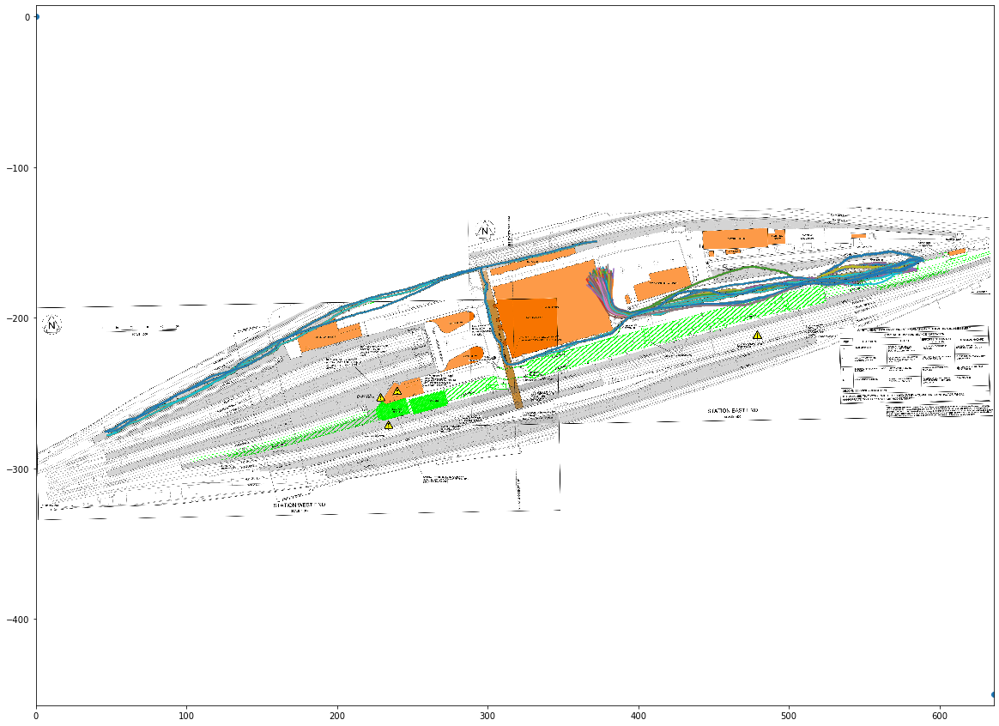

Resampling
Fixing location 372.28048561884657 -149.2198640703641 983.9553


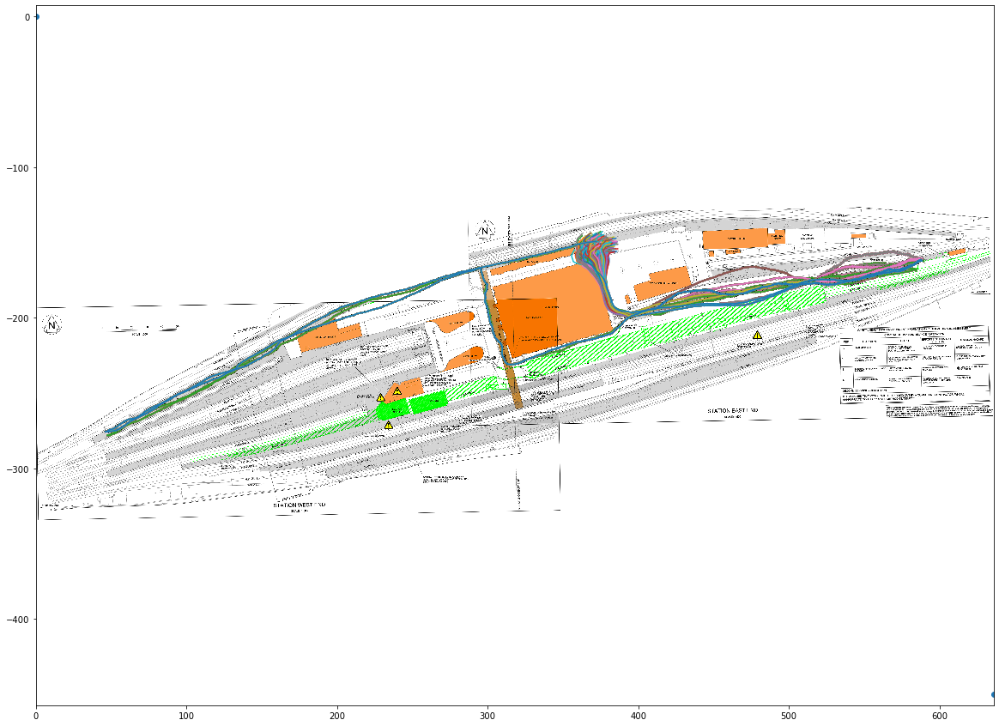

Resampling


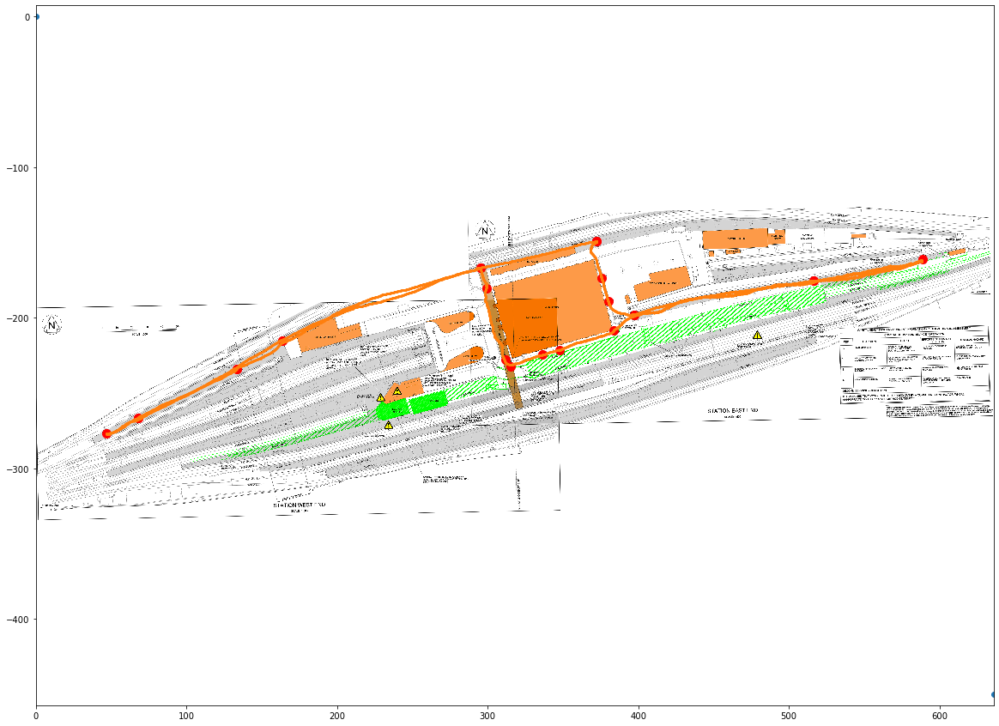

In [72]:
%matplotlib inline
plt.rcParams["figure.figsize"] = (20,15)

def location_likelihood(p, known_x, known_y):
    d = math.hypot(p.x - known_x, p.y - known_y)
    dev = 1.0
    return math.exp(-0.5*(d*d)/(dev*dev)) + 0.0001

# 
# raw = pd.read_csv('gt_fixes.csv')

def plot_histories(cloud):
    for p in cloud.particles:
        plt.plot(*zip(*p.history), '-')
    # plt.axis('equal')
    plt.show()

clouds = []
trajectories_aligned = []

dev = (0.05, 0.001, 0.02)
dev_roughen = (0, 0, math.pi*0.05)
p_count = 2000

subdirs = os.listdir(path_dualfoot_data) 

for traj_name in trajs:
    traj = map_info[traj_name]
    path = os.path.join(path_dualfoot_data, traj['subdir'])
    data = read_pf_data(path, truncate_to_last_timestamp)
    
    known_locations = read_known_locations(path)
    
    xs, ys, ts = data['trajectory']
    init_pf = data['init_pf'][0]
    controls = extract_control(xs, ys, ts)
    
    cloud = Cloud(p_count, Particle(0, 0, 0))
    clouds.append(cloud)
    
    fixed = False
    
    init_move = (init_pf['x'], init_pf['y'], init_pf['heading'])
    
    cloud.set_pose(controls[0][0] + init_move[0], controls[0][1] + init_move[1], controls[0][2] + init_move[2])
    cloud.record_history()
    
    for p in cloud.particles:
        p.scale = init_pf['scale'] + random.gauss(0, 0.1)
        
    location_index = 0
    
    for ctrl in controls[1:]:
        # print(ctrl)
        t = ctrl[3]
        cloud.move(ctrl, dev)
        cloud.record_history()
        
        if location_index >= len(known_locations.t):
            location_index = 0
        t_location = known_locations.t[location_index]
        if abs(t - t_location) < 0.25:
            fixed = True
            known_x = known_locations.x[location_index]
            known_y = known_locations.y[location_index]
            location_index += 1
            print("Fixing location", known_x, known_y, t)
            plt.figure()
            plot_image_scale(plt.gca(), floorplan_image, floorplan_scale)
            plot_histories(cloud)
            plt.show()
            
            cloud.update_weights(partial(location_likelihood, known_x = known_x, known_y = known_y))
            if cloud.neff_ratio() < 0.8:
                print('Resampling')
                cloud.resample()
                cloud.roughen(dev_roughen)
                for p in cloud.particles:
                    p.scale += random.gauss(0, 0.1)
                
    plt.figure()
    plot_image_scale(plt.gca(), floorplan_image, floorplan_scale)
    plt.plot(known_locations.x, known_locations.y, 'or', markersize = 10)
    plt.plot(*zip(*cloud.mean_history()), '.', markersize = 3)

    # plt.axis('equal')
    plt.show()
    
    ts_to_save = [c[3] for c in controls]
    xs_to_save = [c[0] for c in cloud.mean_history()]
    ys_to_save = [c[1] for c in cloud.mean_history()]
    
    data_to_save = {'x': xs_to_save, 'y': ys_to_save, 't': ts_to_save }
    trajectories_aligned.append(data_to_save)
    df = pd.DataFrame(data_to_save)
    df.to_csv(path +'/trajectory_aligned.csv', index=False)

In [71]:
%matplotlib inline
plt.rcParams["figure.figsize"] = (20,15)

def location_likelihood(p, known_x, known_y):
    d = math.hypot(p.x - known_x, p.y - known_y)
    dev = 1.0
    return math.exp(-0.5*(d*d)/(dev*dev)) + 0.0001

# 
# raw = pd.read_csv('gt_fixes.csv')

def plot_histories(cloud):
    for p in cloud.particles:
        plt.plot(*zip(*p.history), '-')
    # plt.axis('equal')
    plt.show()

clouds = []
trajectories_aligned = []

dev = (0.05, 0.001, 0.02)
dev_roughen = (0, 0, math.pi*0.05)
p_count = 2000

subdirs = os.listdir(path_dualfoot_data) 
for subdir in subdirs:
    print('Processing: ', subdir)

    path = path_dualfoot_data + subdir
    data = read_pf_data(path, truncate_to_last_timestamp)
    
    known_locations = read_known_locations(path)
    
    xs, ys, ts = data['trajectory']
    init_pf = data['init_pf'][0]
    controls = extract_control(xs, ys, ts)
    
    cloud = Cloud(p_count, Particle(0, 0, 0))
    clouds.append(cloud)
    
    fixed = False
    
    init_move = (init_pf['x'], init_pf['y'], init_pf['heading'])
    
    cloud.set_pose(controls[0][0] + init_move[0], controls[0][1] + init_move[1], controls[0][2] + init_move[2])
    cloud.record_history()
    
    for p in cloud.particles:
        p.scale = init_pf['scale'] + random.gauss(0, 0.1)
        
    location_index = 0
    
    for ctrl in controls[1:]:
        # print(ctrl)
        t = ctrl[3]
        cloud.move(ctrl, dev)
        cloud.record_history()
        
        if location_index >= len(known_locations.t):
            location_index = 0
        t_location = known_locations.t[location_index]
        if abs(t - t_location) < 0.25:
            fixed = True
            known_x = known_locations.x[location_index]
            known_y = known_locations.y[location_index]
            location_index += 1
            print("Fixing location", known_x, known_y, t)
            plt.figure()
            plot_image_enu(plt.gca(), floorplan_image, floorplan_pgw)
            plot_histories(cloud)
            plt.show()
            
            cloud.update_weights(partial(location_likelihood, known_x = known_x, known_y = known_y))
            if cloud.neff_ratio() < 0.8:
                print('Resampling')
                cloud.resample()
                cloud.roughen(dev_roughen)
                for p in cloud.particles:
                    p.scale += random.gauss(0, 0.1)
                
    plt.figure()
    plot_image_enu(plt.gca(), floorplan_image, floorplan_pgw)
    plt.plot(known_locations.x, known_locations.y, 'or', markersize = 10)
    plt.plot(*zip(*cloud.mean_history()), '.', markersize = 3)

    # plt.axis('equal')
    plt.show()
    
    ts_to_save = [c[3] for c in controls]
    xs_to_save = [c[0] for c in cloud.mean_history()]
    ys_to_save = [c[1] for c in cloud.mean_history()]
    
    data_to_save = {'x': xs_to_save, 'y': ys_to_save, 't': ts_to_save }
    trajectories_aligned.append(data_to_save)
    df = pd.DataFrame(data_to_save)
    df.to_csv(path +'/trajectory_aligned.csv', index=False)




Processing:  2022-07-05_14-28-40.351_HUAWEI P40 Pro 2


FileNotFoundError: [Errno 2] No such file or directory: '/data/processed/peize/waverley_data/2022-07-05_14-28-40.351_HUAWEI P40 Pro 2/trajectory.csv'

In [ ]:
# plot_image_enu(plt.gca(), floorplan_image, floorplan_pgw)
plt.figure()
for trajectory in trajectories_aligned:
    # plt.figure()
    plot_image_enu(plt.gca(), floorplan_image, floorplan_pgw)    
    # plot_histories(cloud)
    plt.plot(trajectory['x'], trajectory['y'], '.', markersize = 10)

plt.show()

In [ ]:


subdirs = os.listdir(path_dualfoot_data)

mn_all = []
xs_all = []
ys_all = []
for subdir in subdirs:
    path = path_dualfoot_data + subdir
    trajectory = pd.read_csv(path + '/trajectory_aligned.csv')
    mf = pd.read_csv(path + '/magnetic_field_5.csv', skiprows=1)
    mx = mf['mfield_x[uT]']
    my = mf['mfield_y[uT]']
    mz = mf['mfield_z[uT]']
    
    mf_t_orig = [t/1000 for t in mf['imuTimestamp']]
    mf_t = [t - mf_t_orig[0] for t in mf_t_orig]

    mf_ix = np.searchsorted(mf_t, trajectory.t)
    mn = []
    for (x, y, z) in zip(mx, my, mz):
        n = min(math.sqrt(x*x + y*y + z*z), 75)
        mn.append(n)
        
    xs_all.extend(trajectory.x)
    ys_all.extend(trajectory.y)
    mn_all.extend([mn[i] for i in mf_ix])
        
    
plt.figure()
plot_image_enu(plt.gca(), floorplan_image, floorplan_pgw)    
plt.scatter(xs_all, ys_all, s= 40, c=mn_all, cmap='viridis')
      
plt.show()  

In [ ]:
subdirs = os.listdir(path_dualfoot_data) 
for subdir in subdirs:
    path = path_dualfoot_data + subdir
    normalize_magnetic(path)

In [ ]:
subdirs = os.listdir(path_dualfoot_data) 
for subdir in subdirs:
    path = path_dualfoot_data + subdir
    extract_control_and_measurements(path)
    

In [ ]:
create_magnetic_field_map(path_dualfoot_data)